# Creation of YOLO dataset based on detections from image processing pipeline
### Extracting ellipse parameters, cleaning of data, generate height vs. width

Following tasks are performed:
- YOLO annotation generation: Bounding boxes are converted from absolute image coordinates to normalized YOLO format and saved alongside the images.
- Dataset organization: Images and annotations are optionally split into training and validation sets for YOLO model training.



In [ ]:
import numpy as np  # Numerical operations and array handling
import os  # File and directory operations
import imageio  # Image input/output
from skimage.io import imread  # Read images
from skimage import transform  # Image resizing and transformations
import matplotlib.pyplot as plt  # Plotting and visualization
import cv2  # OpenCV for image processing, drawing, thresholding, etc.
from PIL import Image  # Image manipulation
from tifffile import imwrite  # Save TIFF images
from pathlib import Path  # File system path handling
font = cv2.FONT_HERSHEY_SIMPLEX  # Set default font for OpenCV text
from skimage.filters import threshold_otsu  # Otsu thresholding
import shutil  # File operations like copy, move
from skimage.measure import regionprops  # Analyze labeled regions in images
from scipy.spatial import distance  # Distance calculations (e.g., Euclidean)
import pandas as pd  # Data handling, tables, CSV operations

# Configure pandas display to show full DataFrame without truncation
pd.set_option('display.max_rows', None)  # Show all rows
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.width', None)  # Auto-adjust table width
pd.set_option('display.max_colwidth', None)  # Show full content of columns




In [ ]:
# Load previously saved processed data for further analysis:
# 1. `im_list.npy`: list of processed images.
# 2. `all_hvd.npy`: all second-regression curves for each cone.
# 3. `avg_hvd.npy`: averaged regression curve across all cones.
# 4. `output.csv`: cleaned ellipse measurements as a DataFrame.
# Display the first few rows of the cleaned ellipse DataFrame for verification.

im_list = np.load('im_list.npy')
all_hvd = np.load('all_hvd.npy')
avg_hvd = np.load('avg_hvd.npy')
df_ellips_cleaned = pd.read_csv('output.csv',header=0)


df_ellips_cleaned.head()


,cone1,cone2,cone3,center1x,center1y,center2x,center2y,center3x,center3y,slice_index
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
1,NaN,290.287415,NaN,NaN,NaN,1662.250366,NaN,NaN,NaN,5
2,152.652802,NaN,NaN,NaN,1608.817871,NaN,NaN,NaN,NaN,9
3,NaN,NaN,NaN,NaN,NaN,NaN,295.601013,NaN,NaN,13
4,NaN,295.710236,NaN,NaN,NaN,1673.714233,NaN,NaN,NaN,17


[[1.70708896 1.69897307 1.69085717 1.68274128 1.67462538 1.66650949
  1.65839359 1.6502777  1.6421618  1.63404591 1.62593002 1.61781412
  1.60969823 1.60158233 1.59346644 1.58535054 1.57723465 1.56911875
  1.56100286 1.55288697 1.54477107 1.53665518 1.52853928 1.52042339
  1.51230749 1.5041916  1.49607571 1.48795981 1.47984392 1.47172802
  1.46361213 1.45549623 1.44738034 1.43926444 1.43114855 1.42303266
  1.41491676 1.40680087 1.39868497 1.39056908 1.38245318 1.37433729
  1.3662214  1.3581055  1.34998961 1.34187371 1.33375782 1.32564192
  1.31752603 1.30941013 1.30129424 1.29317835 1.28506245 1.27694656
  1.26883066 1.26071477 1.25259887 1.24448298 1.23636709 1.22825119
  1.2201353  1.2120194  1.20390351 1.19578761 1.18767172 1.17955582
  1.17143993 1.16332404 1.15520814 1.14709225 1.13897635 1.13086046
  1.12274456 1.11462867 1.10651277 1.09839688 1.09028099 1.08216509
  1.0740492  1.0659333  1.05781741 1.04970151 1.04158562 1.03346973
  1.02535383 1.01723794 1.00912204 1.00100615 0.

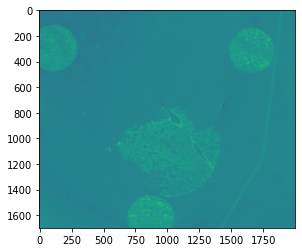

In [59]:
plt.imshow(im_list[0])
print(all_hvd)

In [ ]:
# Filter out rows where all ellipse measurement columns are NaN, 
# keeping only rows that have at least one valid measurement.
# The 'slice_index' column (last column) is retained in all cases.
# Resulting DataFrame `df_yolo` contains only slices with valid ellipse data.

only_nan_except_last  = df_ellips_cleaned.iloc[:, :-1].isna().all(axis=1)
df_yolo = df_ellips_cleaned[~only_nan_except_last]
df_yolo

,cone1,cone2,cone3,center1x,center1y,center2x,center2y,center3x,center3y,slice_index
1,NaN,290.287415,NaN,NaN,NaN,1662.250366,NaN,NaN,NaN,5
2,152.652802,NaN,NaN,NaN,1608.817871,NaN,NaN,NaN,NaN,9
3,NaN,NaN,NaN,NaN,NaN,NaN,295.601013,NaN,NaN,13
4,NaN,295.710236,NaN,NaN,NaN,1673.714233,NaN,NaN,NaN,17
5,277.237610,319.348907,NaN,NaN,NaN,1658.572021,NaN,NaN,NaN,21
6,NaN,NaN,290.065277,NaN,NaN,1657.184937,NaN,145.185181,296.957031,26
7,NaN,318.274536,268.760712,NaN,NaN,1652.979370,NaN,131.660538,303.543335,30
8,NaN,NaN,270.570404,NaN,NaN,1655.838013,NaN,142.041550,290.083405,34
9,NaN,NaN,280.340271,NaN,NaN,1660.113647,NaN,133.080612,295.427277,38
10,NaN,313.579132,NaN,NaN,NaN,1654.296509,NaN,NaN,NaN,42


In [ ]:
# Retrieve and print the row indices of the filtered DataFrame `df_yolo`.
# These indices correspond to slices that contain at least one valid ellipse measurement.

index_obj = df_yolo.index
print("Index-Objekt:", index_obj)

Index-Objekt: Int64Index([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,
            ...
            490, 491, 492, 493, 494, 495, 496, 497, 498, 499],
           dtype='int64', length=495)


In [ ]:
# Retrieve and print the row indices of the original cleaned DataFrame `df_ellips_cleaned`.
# These indices represent all slices, including those that may have only NaN measurements.
index_obj_1 = df_ellips_cleaned.index
print("Index-Objekt:", index_obj_1)

Index-Objekt: RangeIndex(start=0, stop=500, step=1)


In [63]:
print(len(im_list))
print(len(df_yolo))

500
495


In [ ]:
# Fill missing values (NaNs) in `df_yolo` using backward fill (bfill) column-wise.
# This ensures that each column has no gaps by propagating the next valid value upward.
# The rationale is that the bounding box measurements from one slice to the next
# should be similar, so missing values can be reasonably inferred from adjacent slices.
# Resulting DataFrame `df_yolo_filled` contains no NaNs in the measurement columns.

df_yolo_filled = df_yolo.apply(lambda col: col.fillna(method='bfill'))

In [66]:
df_yolo_filled.head()

,cone1,cone2,cone3,center1x,center1y,center2x,center2y,center3x,center3y,slice_index
1,152.652802,290.287415,290.065277,869.781738,1608.817871,1662.250366,295.601013,145.185181,296.957031,5
2,152.652802,295.710236,290.065277,869.781738,1608.817871,1673.714233,295.601013,145.185181,296.957031,9
3,277.237610,295.710236,290.065277,869.781738,1600.920532,1673.714233,295.601013,145.185181,296.957031,13
4,277.237610,295.710236,290.065277,869.781738,1600.920532,1673.714233,307.543732,145.185181,296.957031,17
5,277.237610,319.348907,290.065277,869.781738,1600.920532,1658.572021,307.543732,145.185181,296.957031,21


1


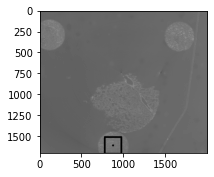

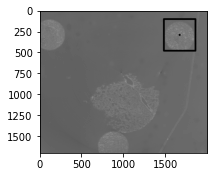

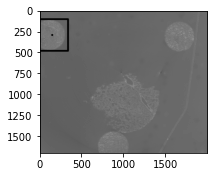

2


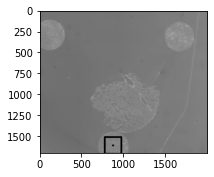

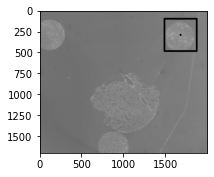

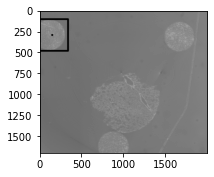

3


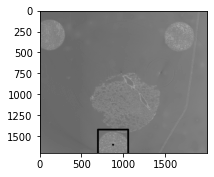

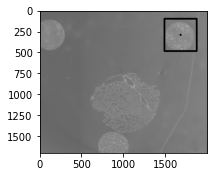

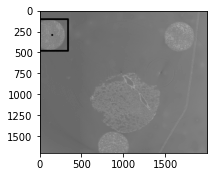

4


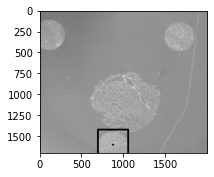

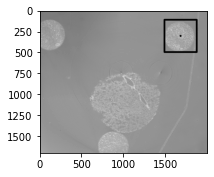

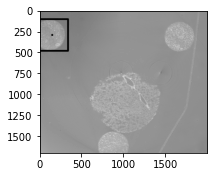

5


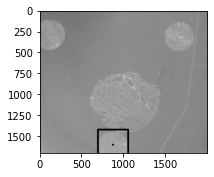

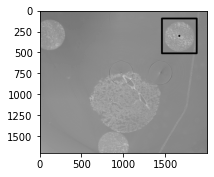

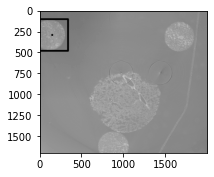

6


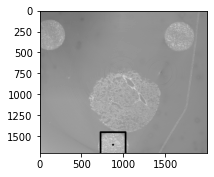

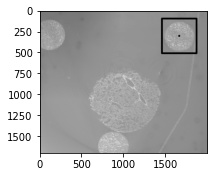

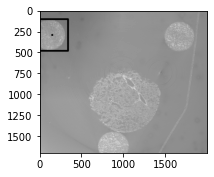

7


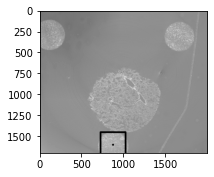

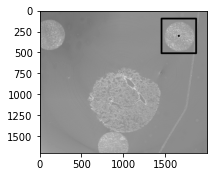

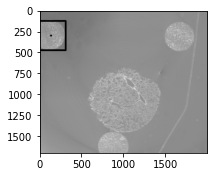

8


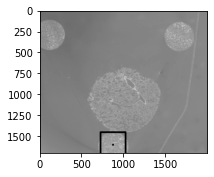

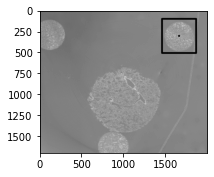

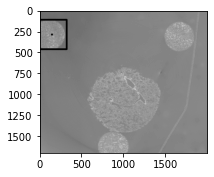

9


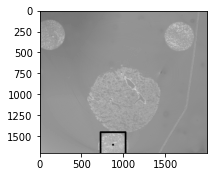

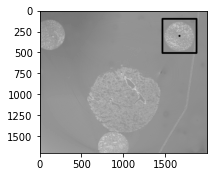

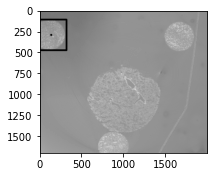

10


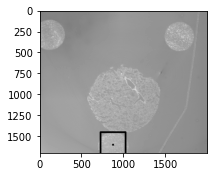

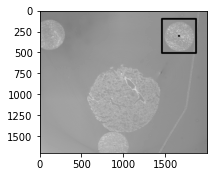

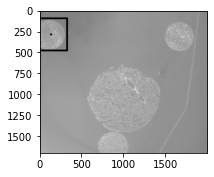

11


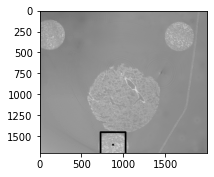

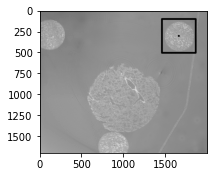

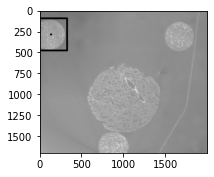

12


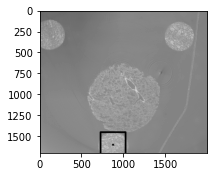

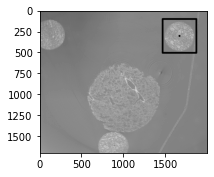

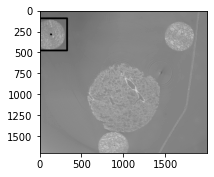

13


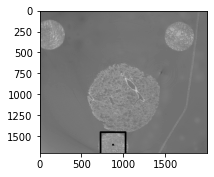

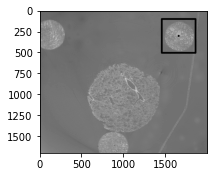

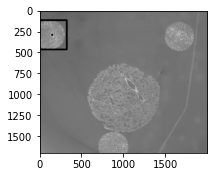

14


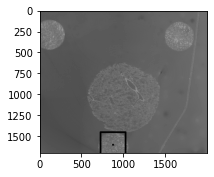

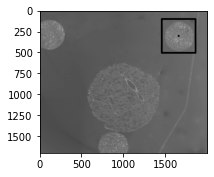

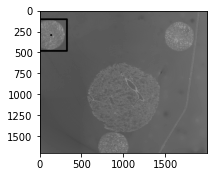

16


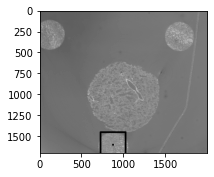

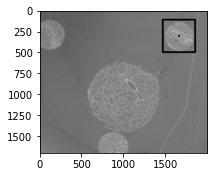

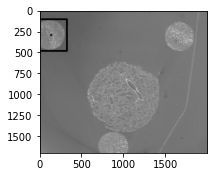

17


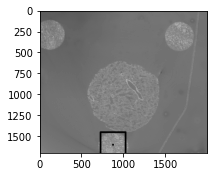

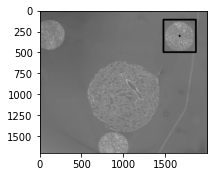

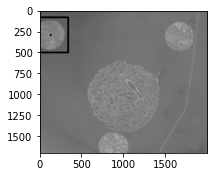

18


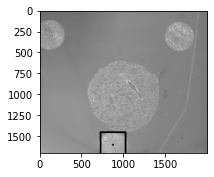

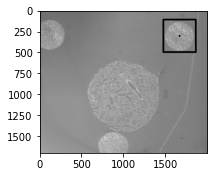

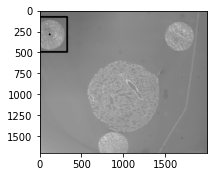

19


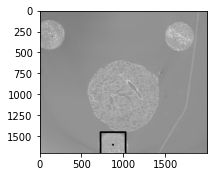

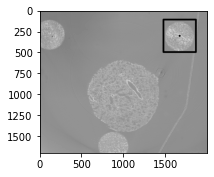

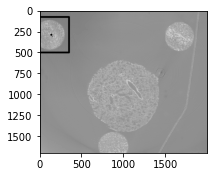

20


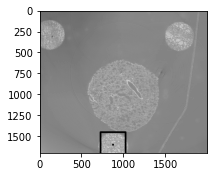

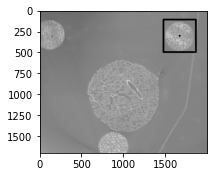

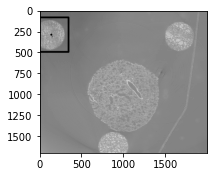

21


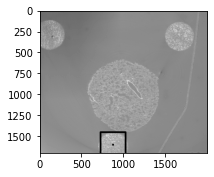

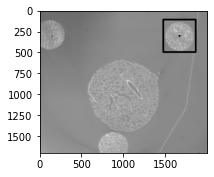

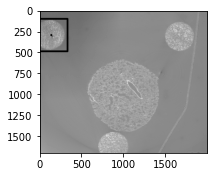

22


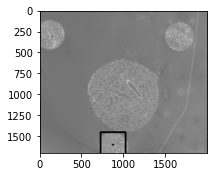

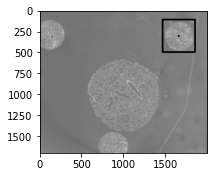

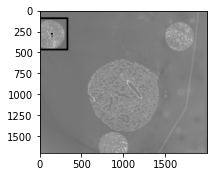

23


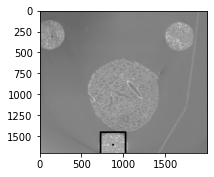

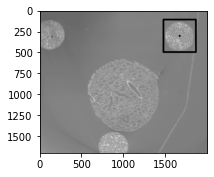

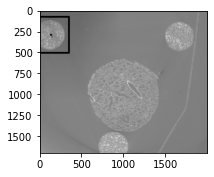

24


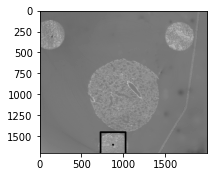

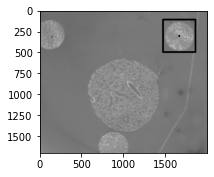

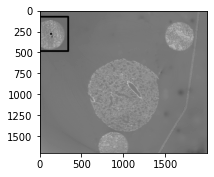

25


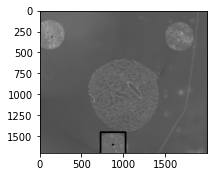

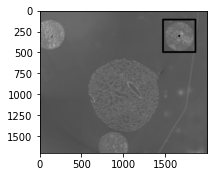

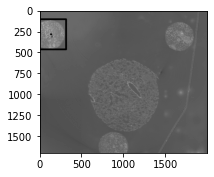

26


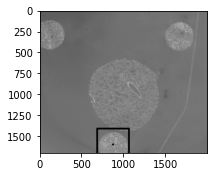

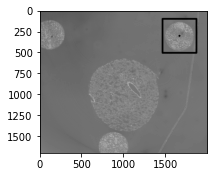

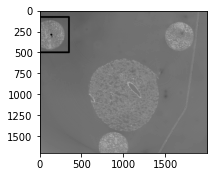

27


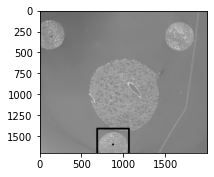

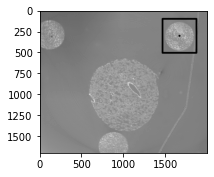

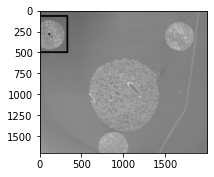

28


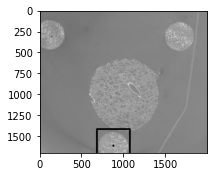

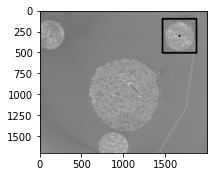

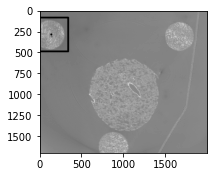

29


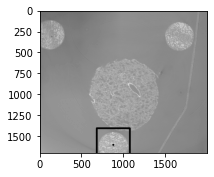

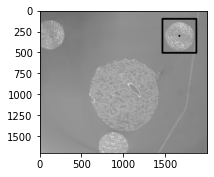

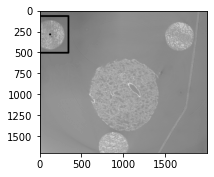

30


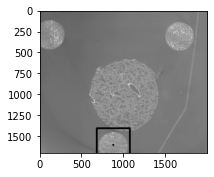

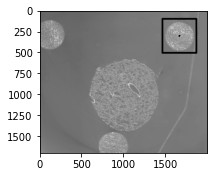

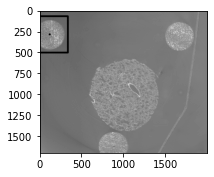

31


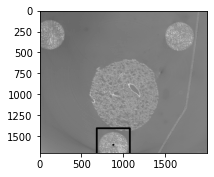

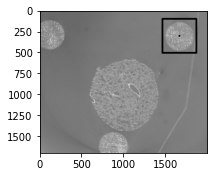

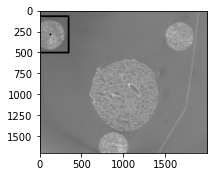

32


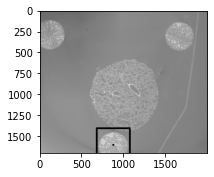

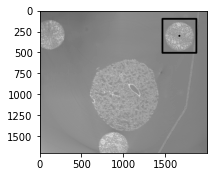

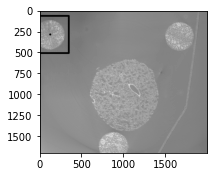

33


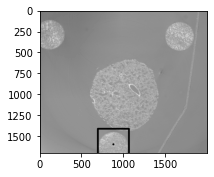

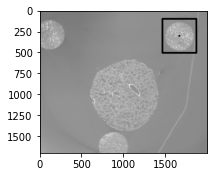

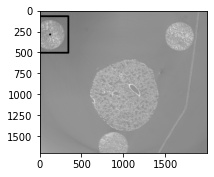

34


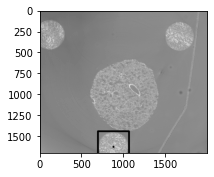

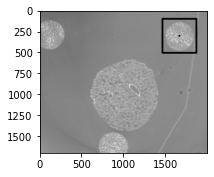

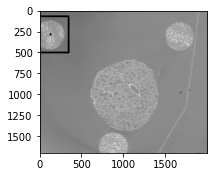

35


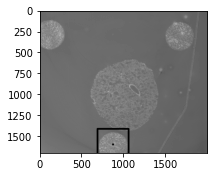

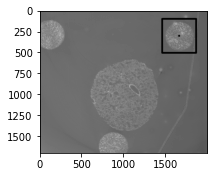

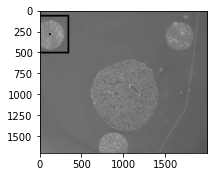

36


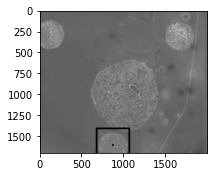

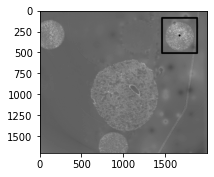

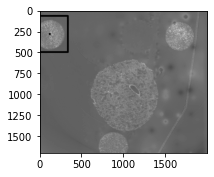

37


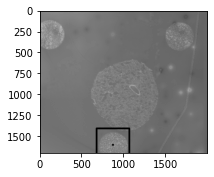

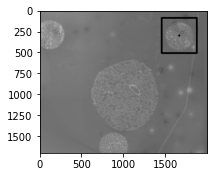

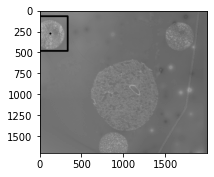

38


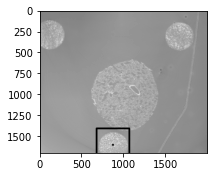

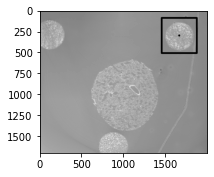

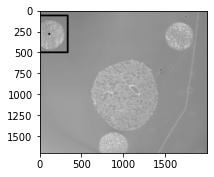

39


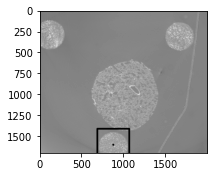

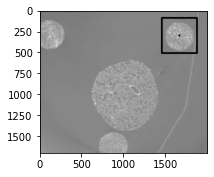

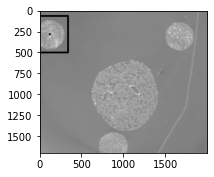

40


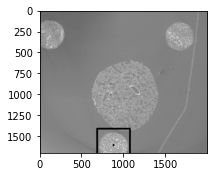

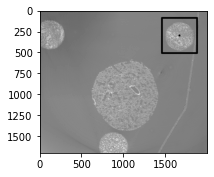

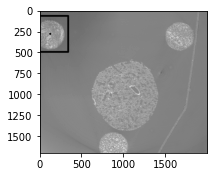

41


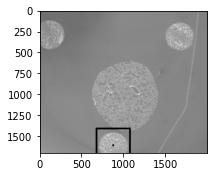

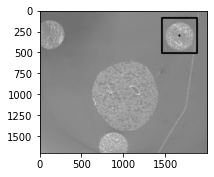

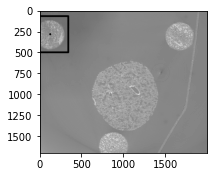

42


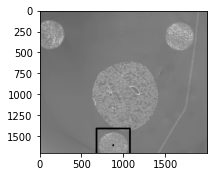

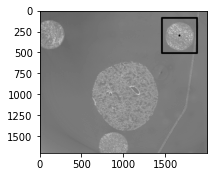

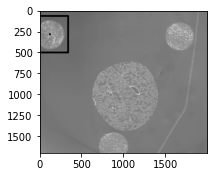

43


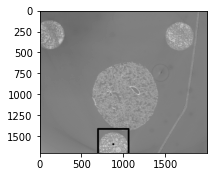

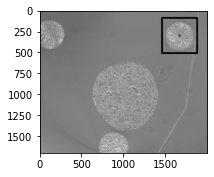

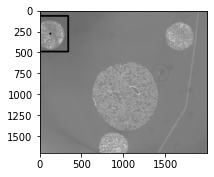

44


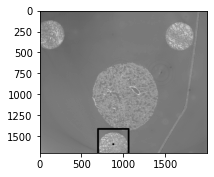

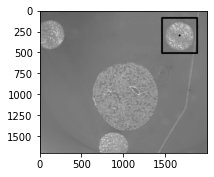

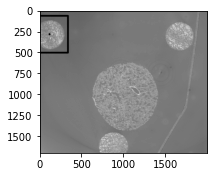

45


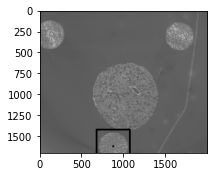

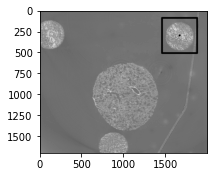

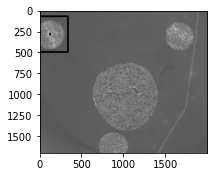

46


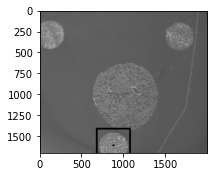

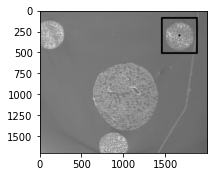

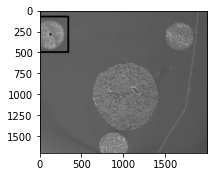

47


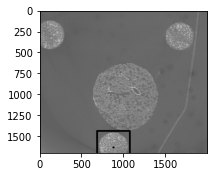

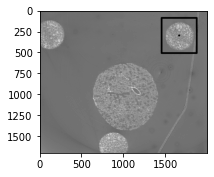

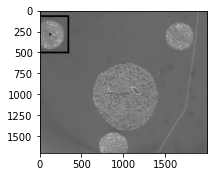

48


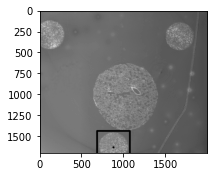

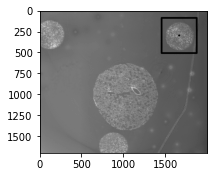

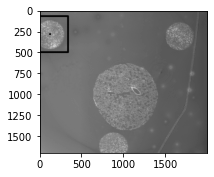

49


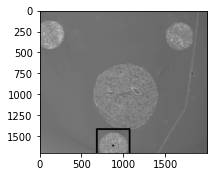

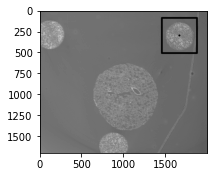

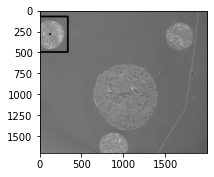

50


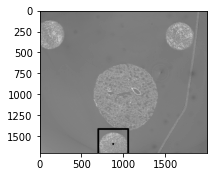

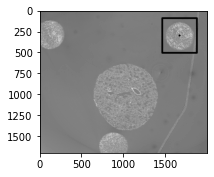

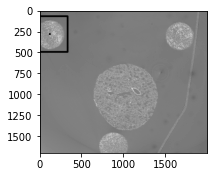

51


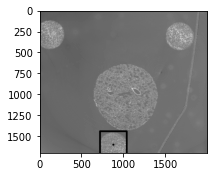

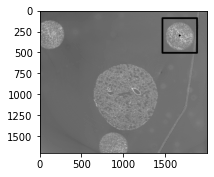

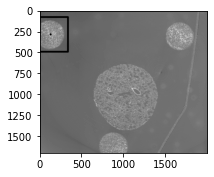

52


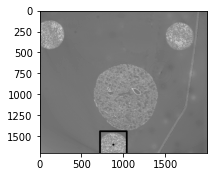

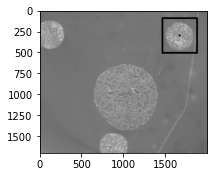

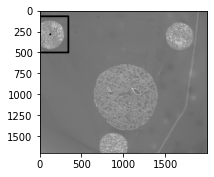

53


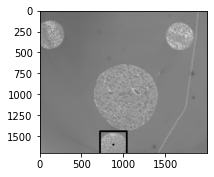

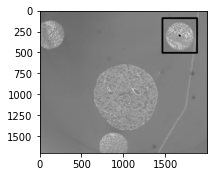

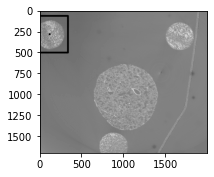

54


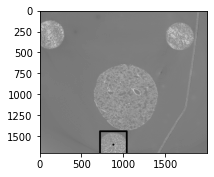

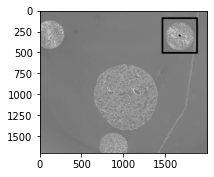

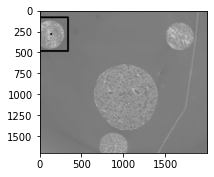

55


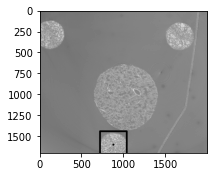

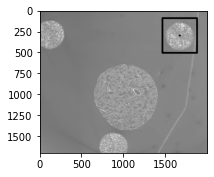

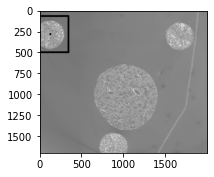

56


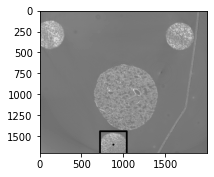

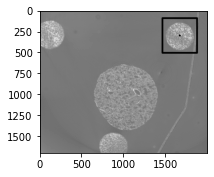

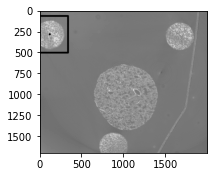

57


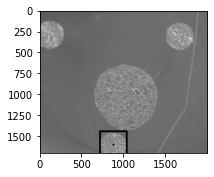

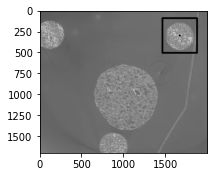

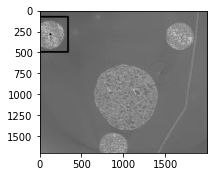

58


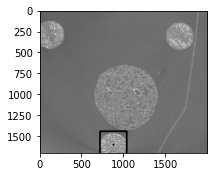

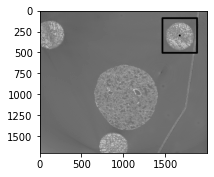

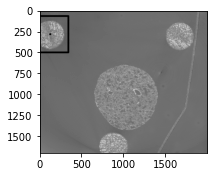

59


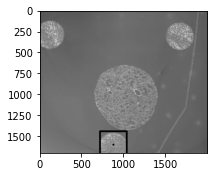

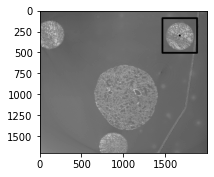

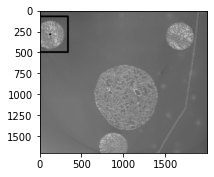

60


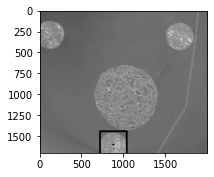

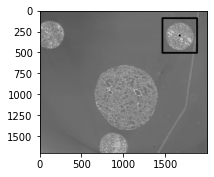

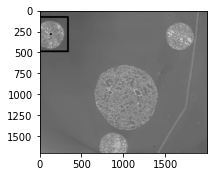

61


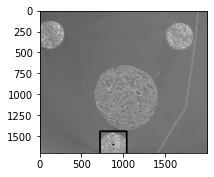

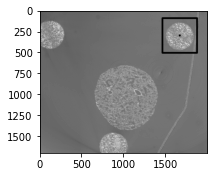

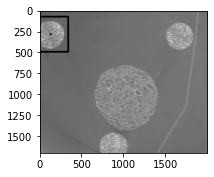

62


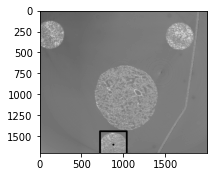

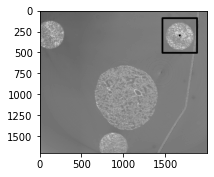

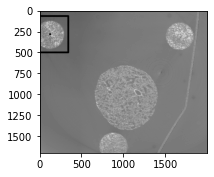

63


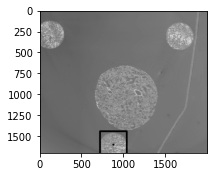

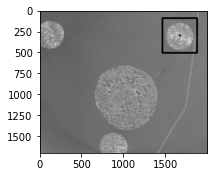

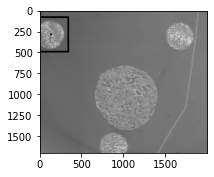

64


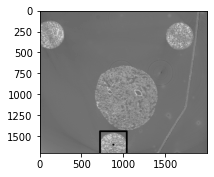

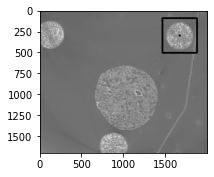

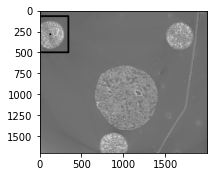

65


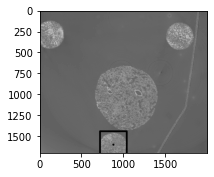

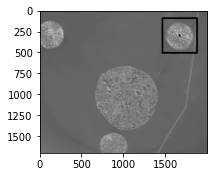

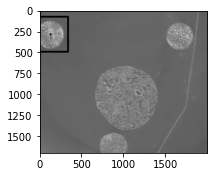

66


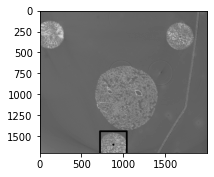

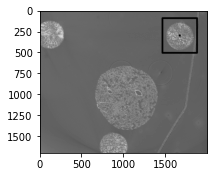

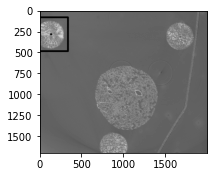

67


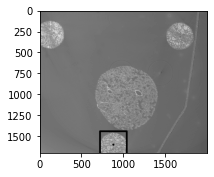

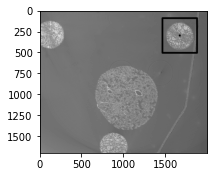

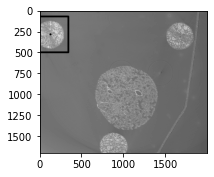

68


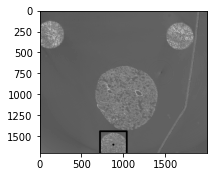

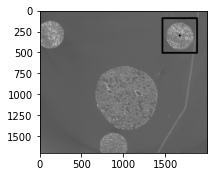

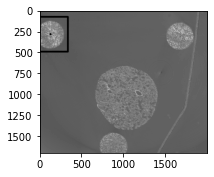

69


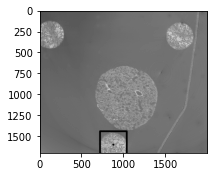

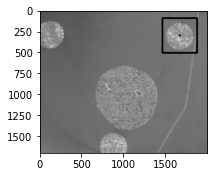

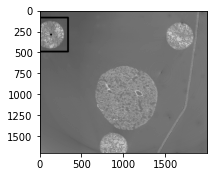

70


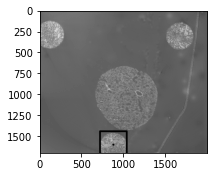

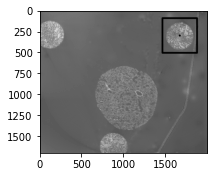

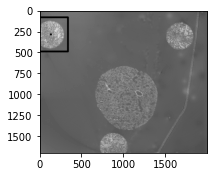

71


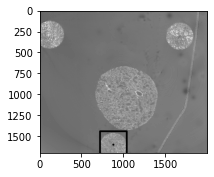

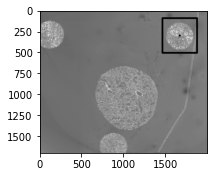

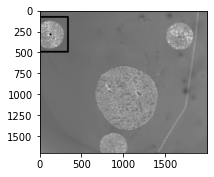

72


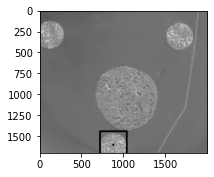

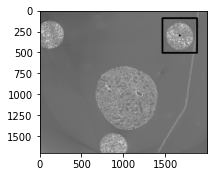

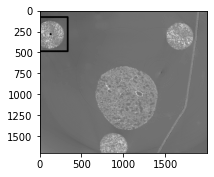

73


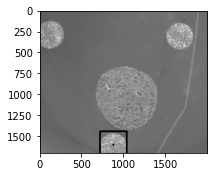

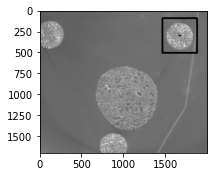

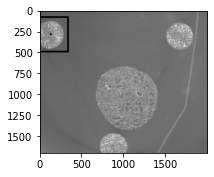

74


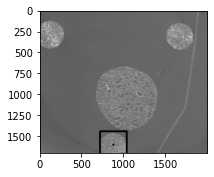

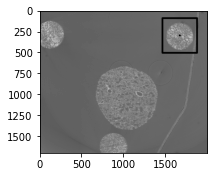

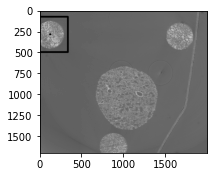

75


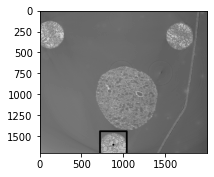

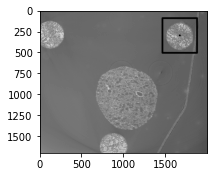

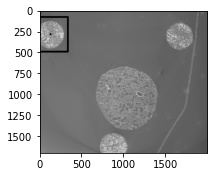

76


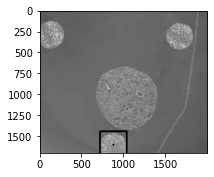

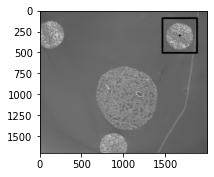

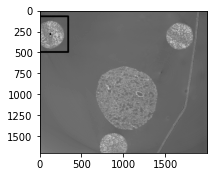

77


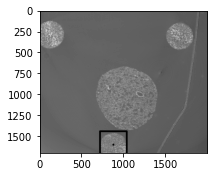

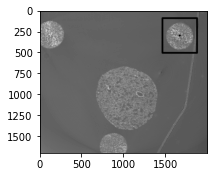

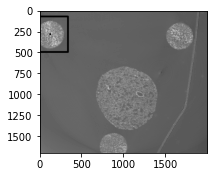

78


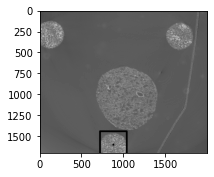

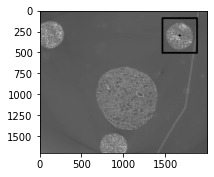

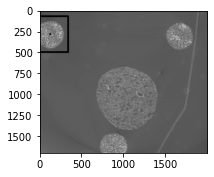

79


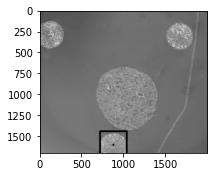

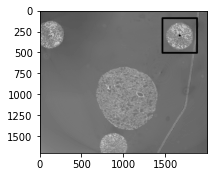

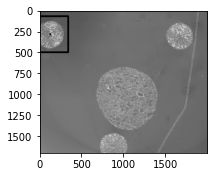

80


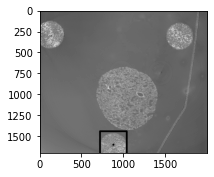

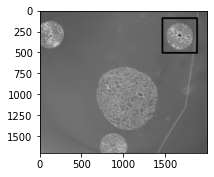

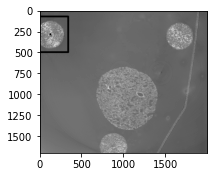

81


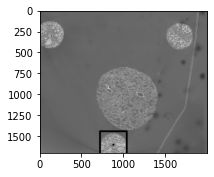

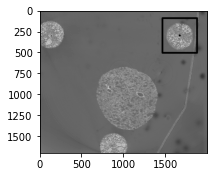

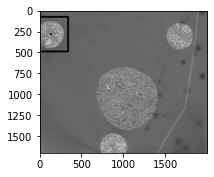

82


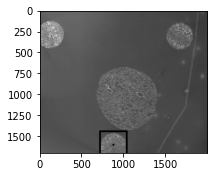

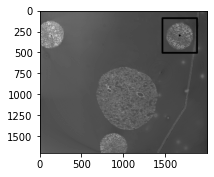

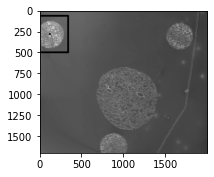

83


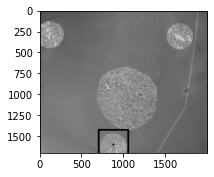

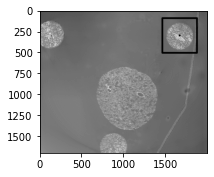

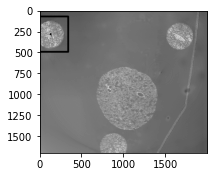

84


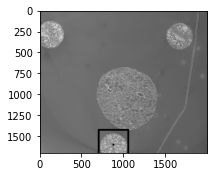

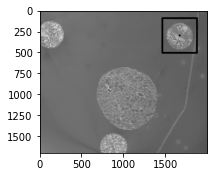

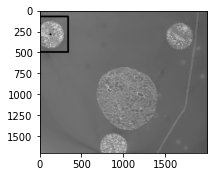

85


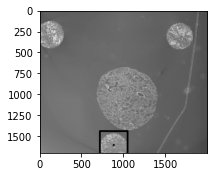

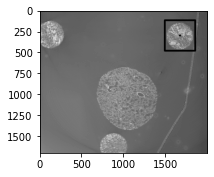

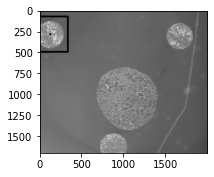

86


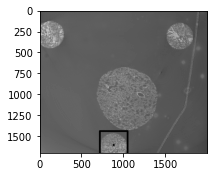

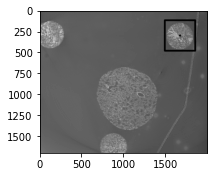

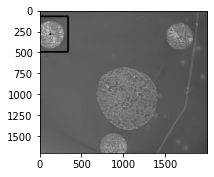

87


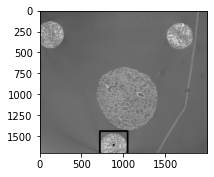

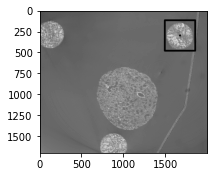

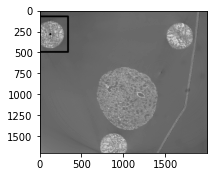

88


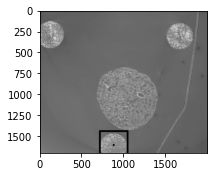

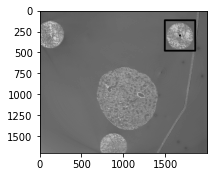

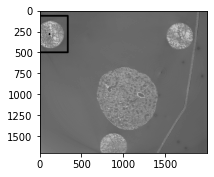

89


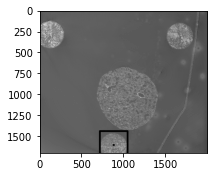

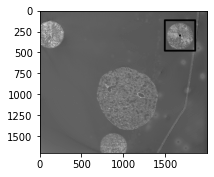

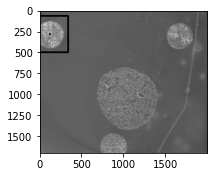

90


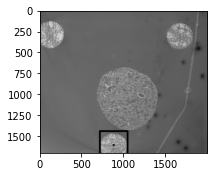

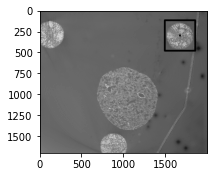

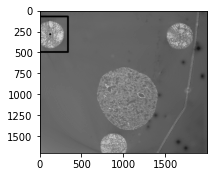

91


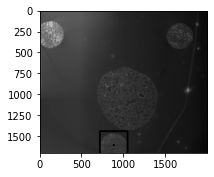

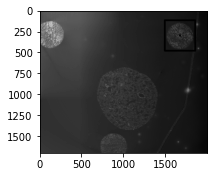

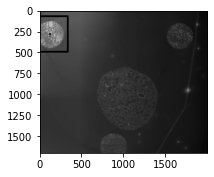

92


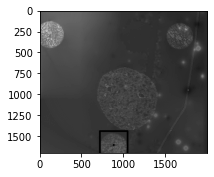

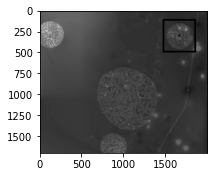

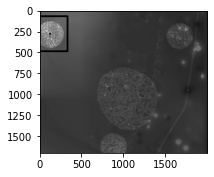

93


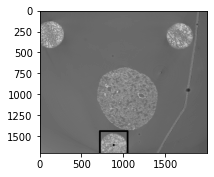

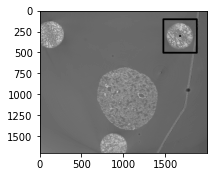

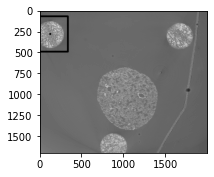

94


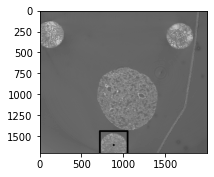

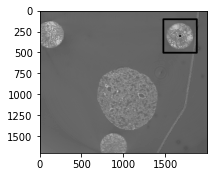

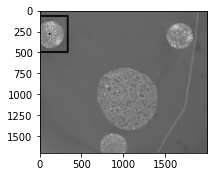

95


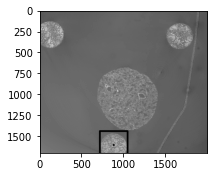

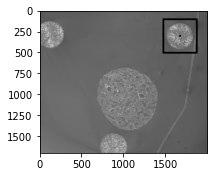

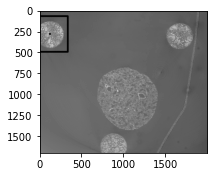

96


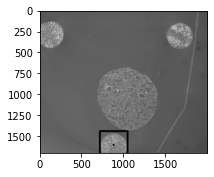

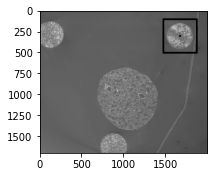

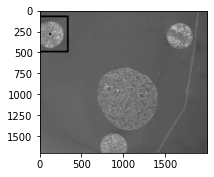

97


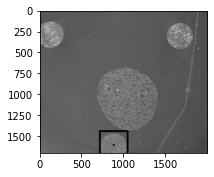

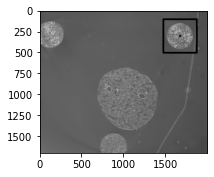

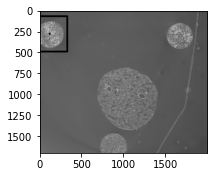

98


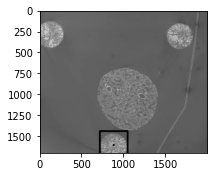

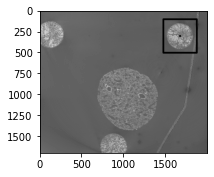

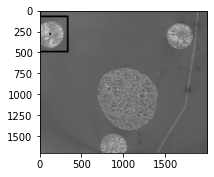

99


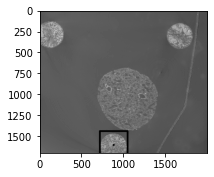

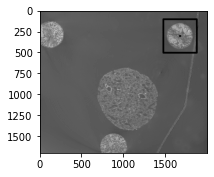

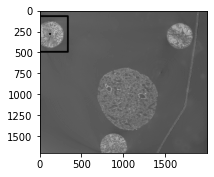

100


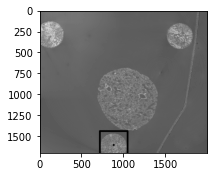

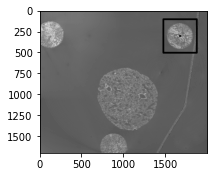

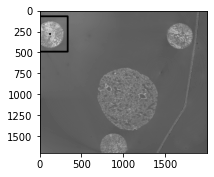

101


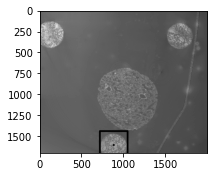

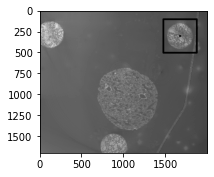

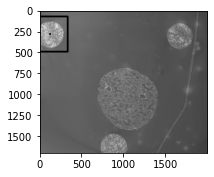

102


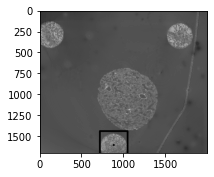

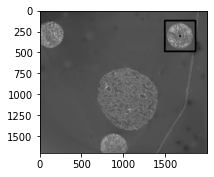

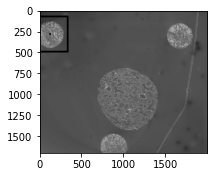

103


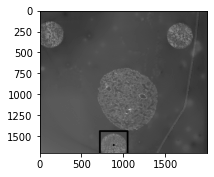

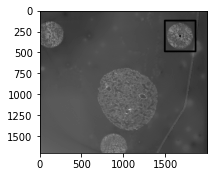

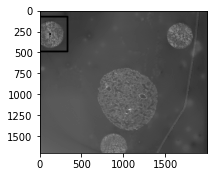

104


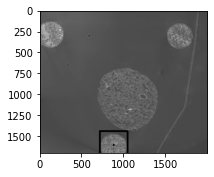

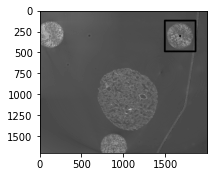

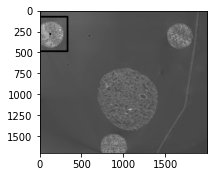

105


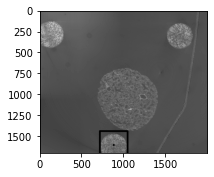

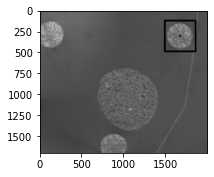

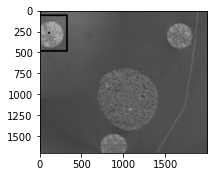

106


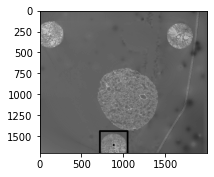

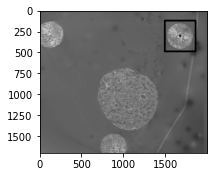

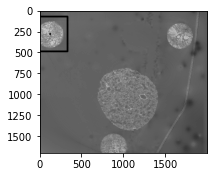

107


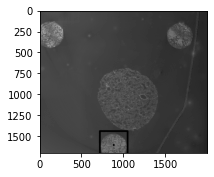

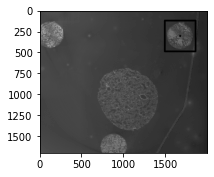

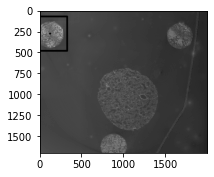

108


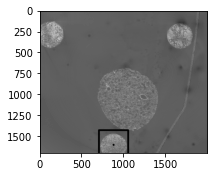

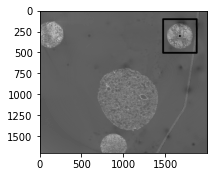

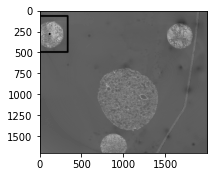

109


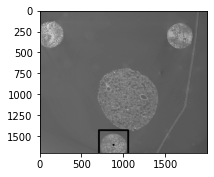

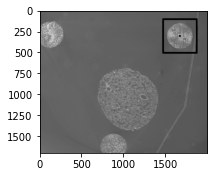

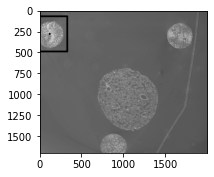

110


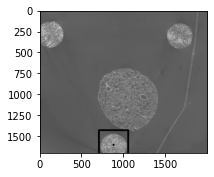

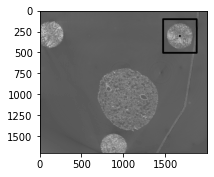

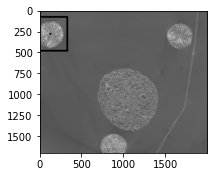

111


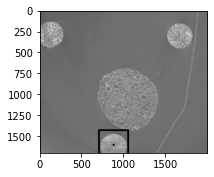

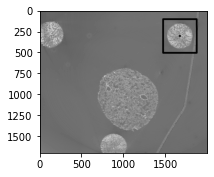

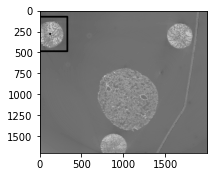

112


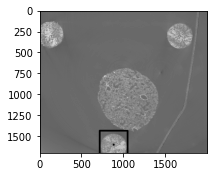

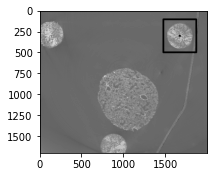

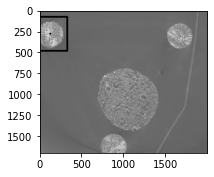

113


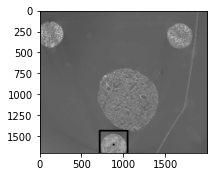

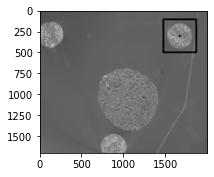

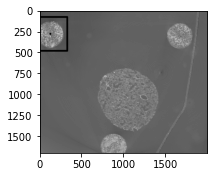

114


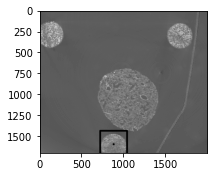

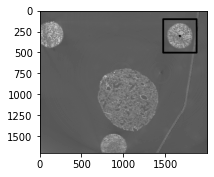

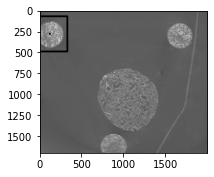

115


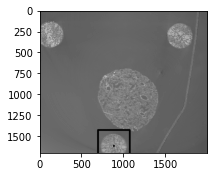

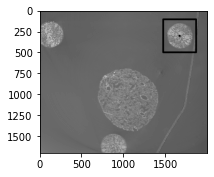

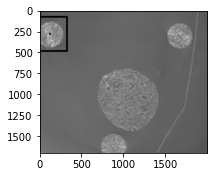

116


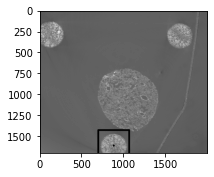

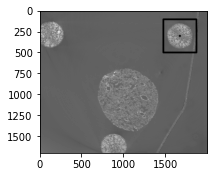

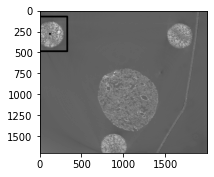

117


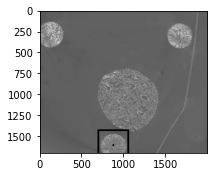

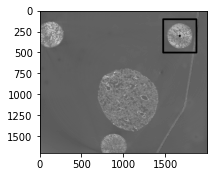

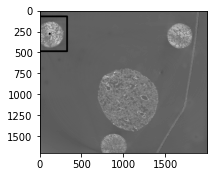

118


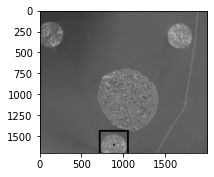

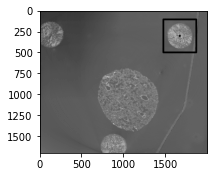

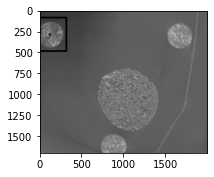

119


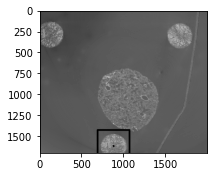

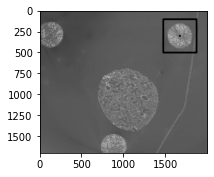

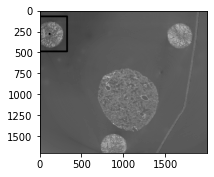

120


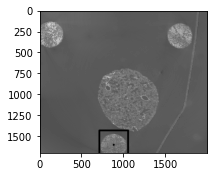

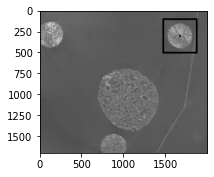

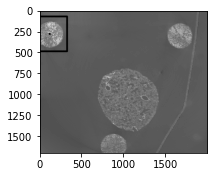

121


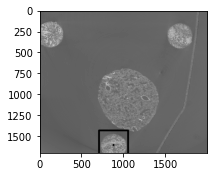

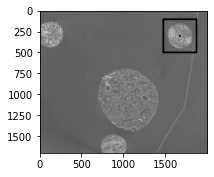

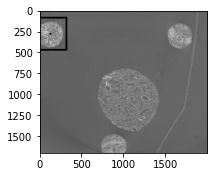

122


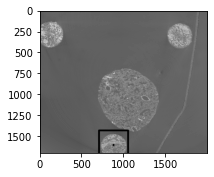

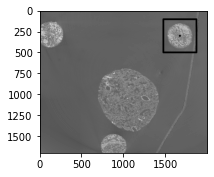

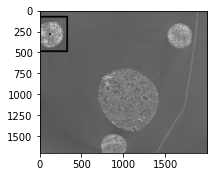

123


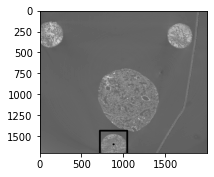

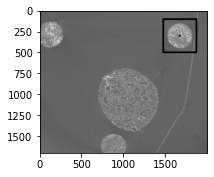

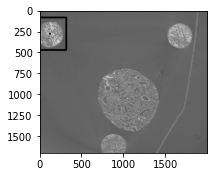

124


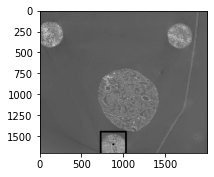

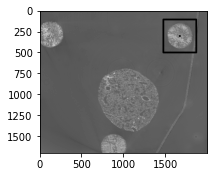

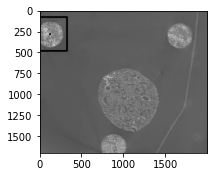

125


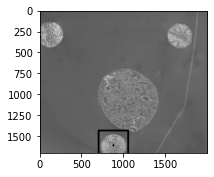

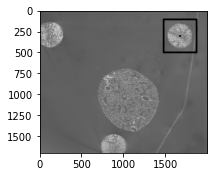

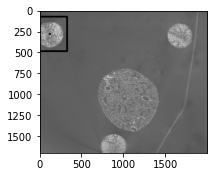

126


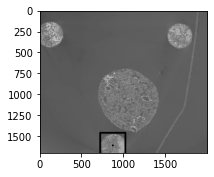

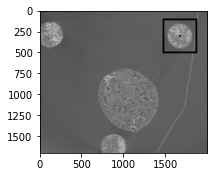

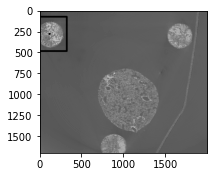

127


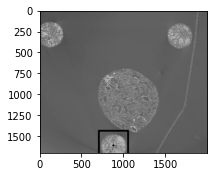

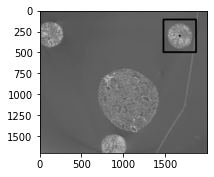

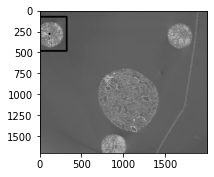

128


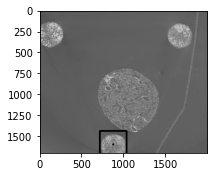

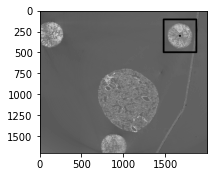

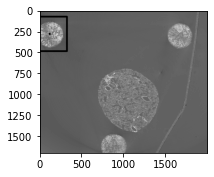

129


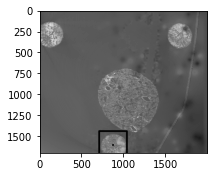

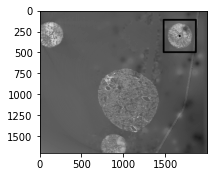

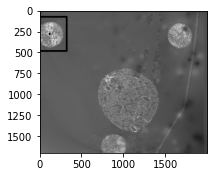

130


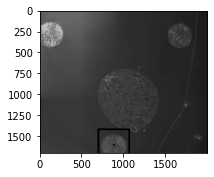

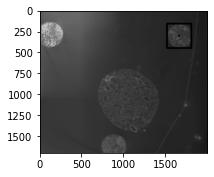

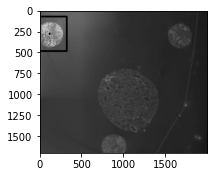

131


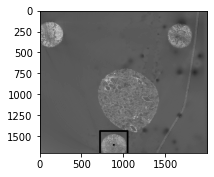

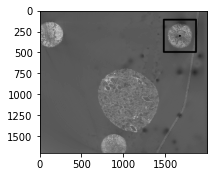

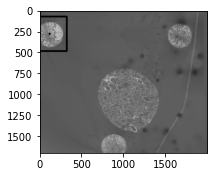

132


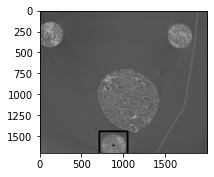

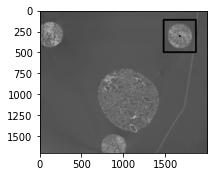

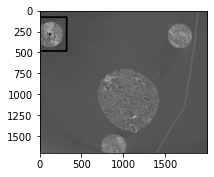

133


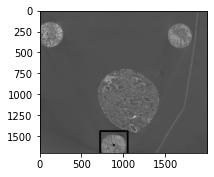

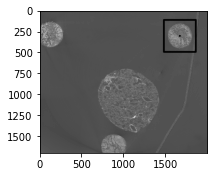

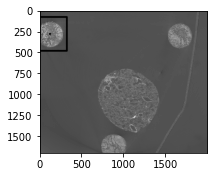

134


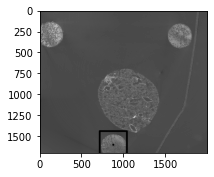

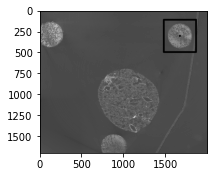

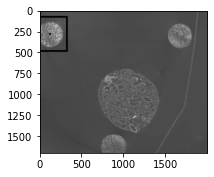

135


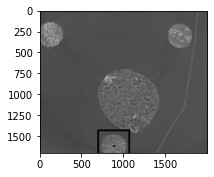

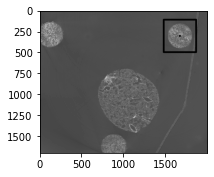

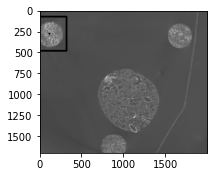

136


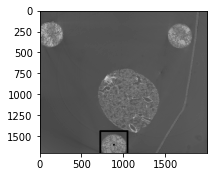

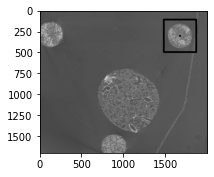

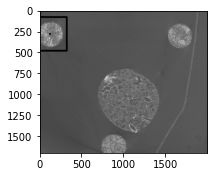

137


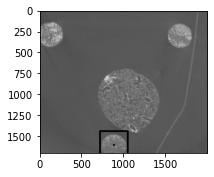

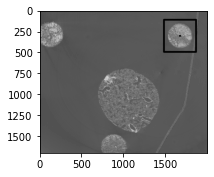

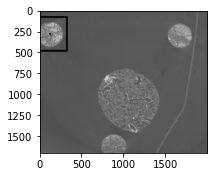

138


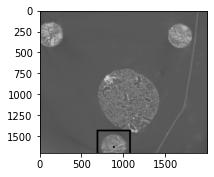

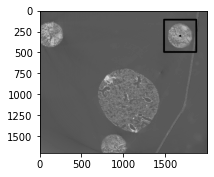

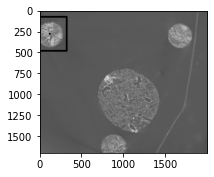

139


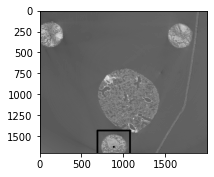

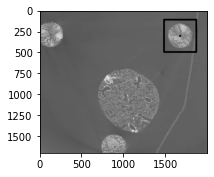

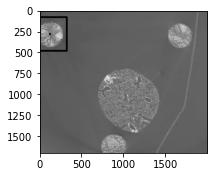

140


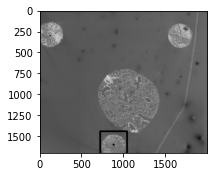

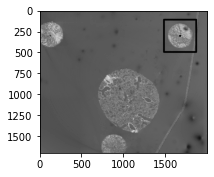

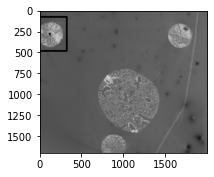

141


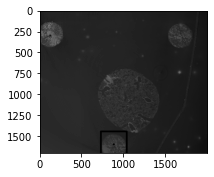

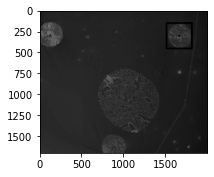

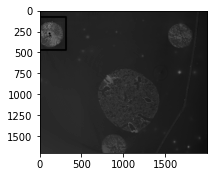

142


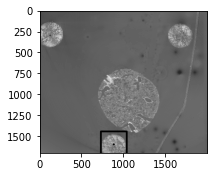

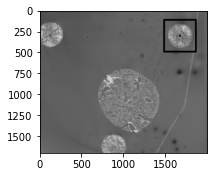

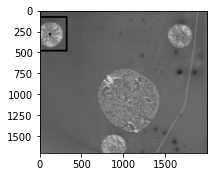

143


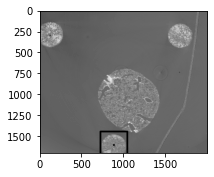

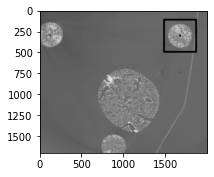

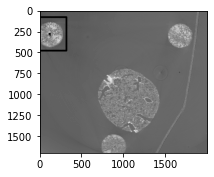

144


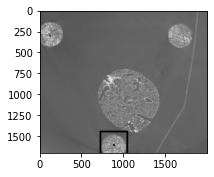

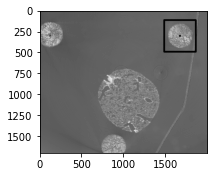

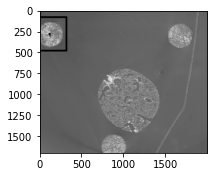

145


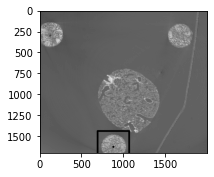

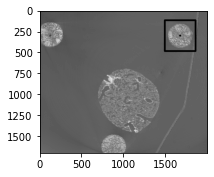

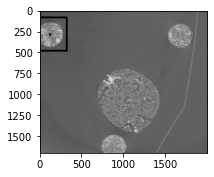

146


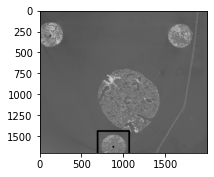

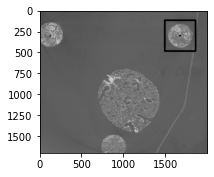

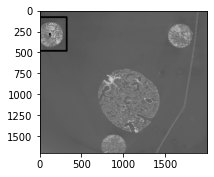

147


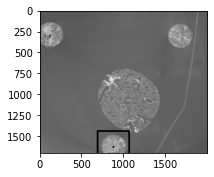

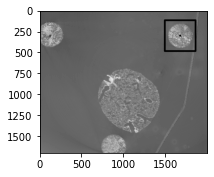

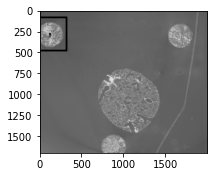

148


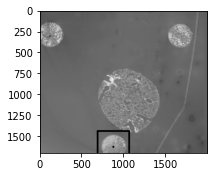

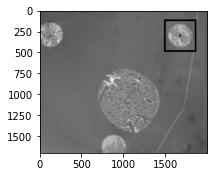

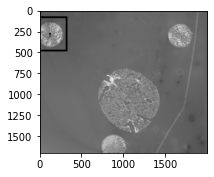

149


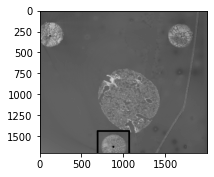

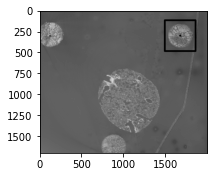

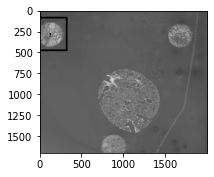

150


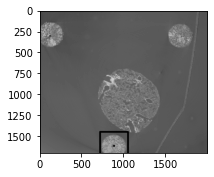

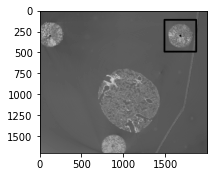

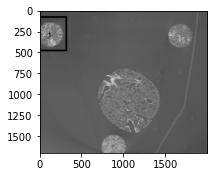

151


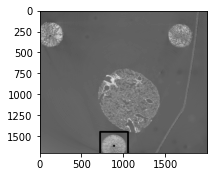

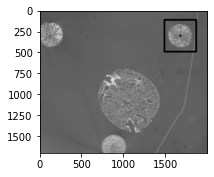

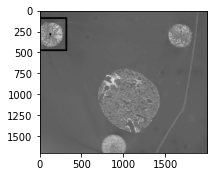

152


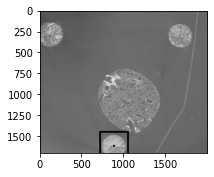

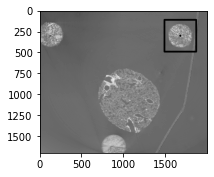

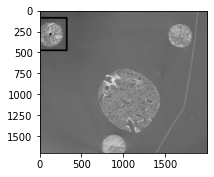

153


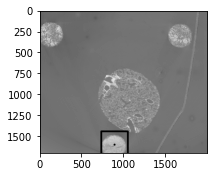

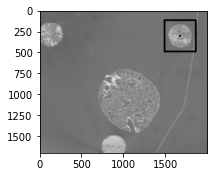

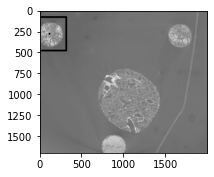

154


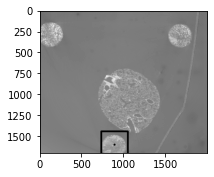

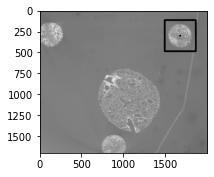

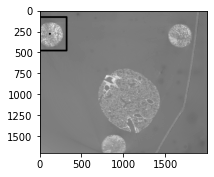

155


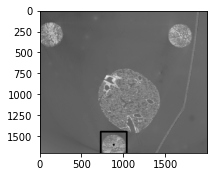

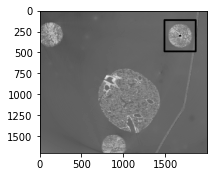

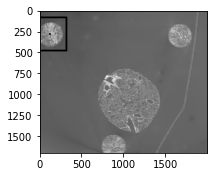

156


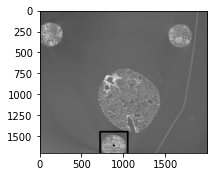

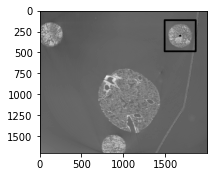

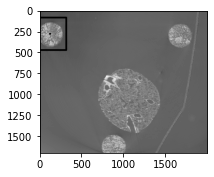

157


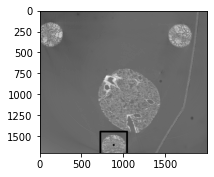

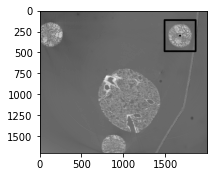

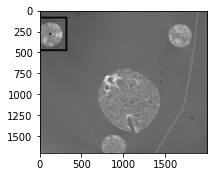

158


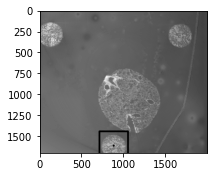

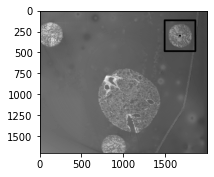

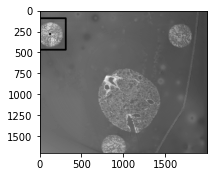

159


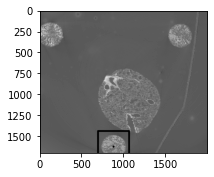

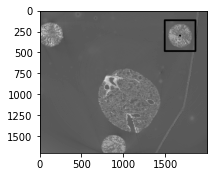

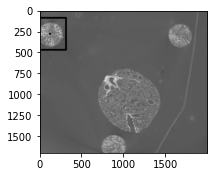

160


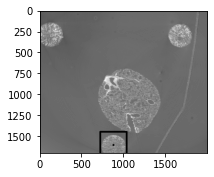

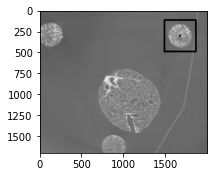

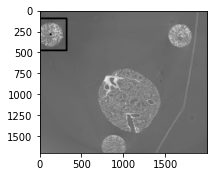

161


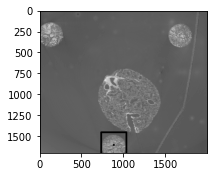

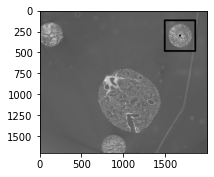

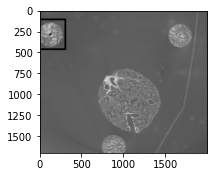

162


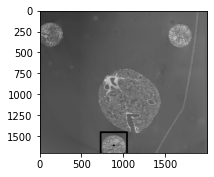

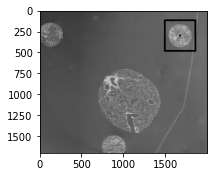

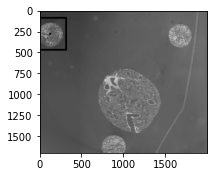

163


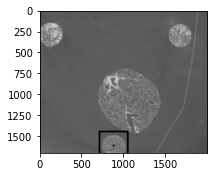

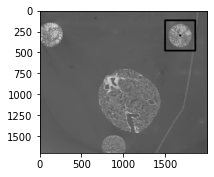

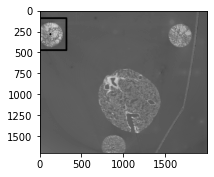

164


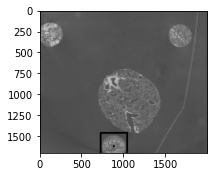

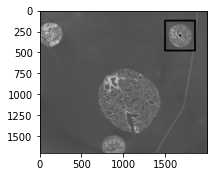

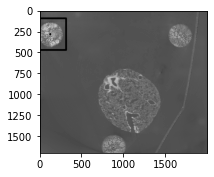

165


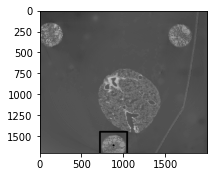

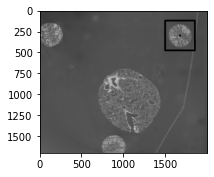

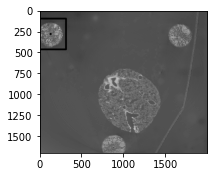

166


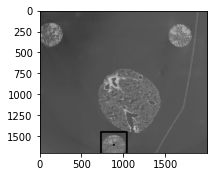

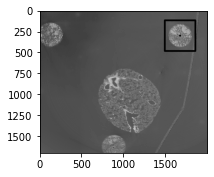

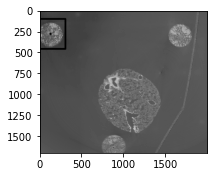

167


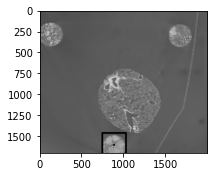

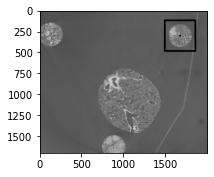

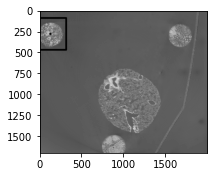

168


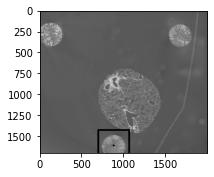

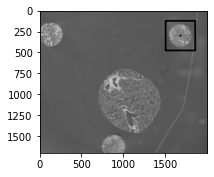

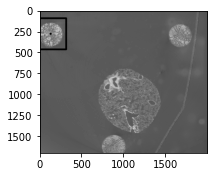

169


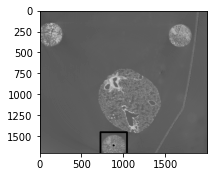

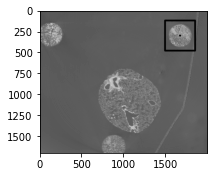

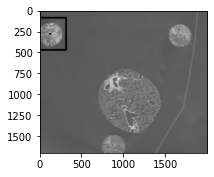

170


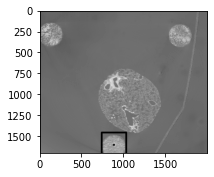

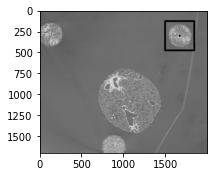

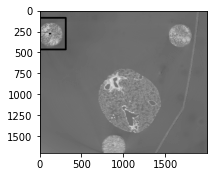

171


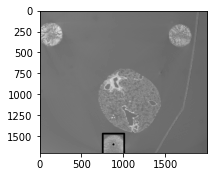

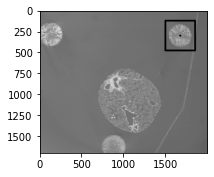

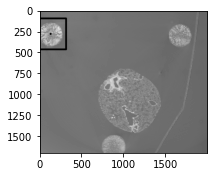

172


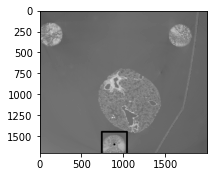

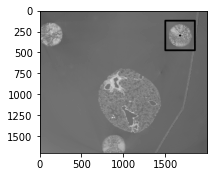

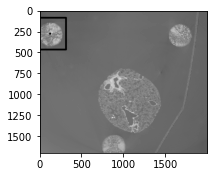

173


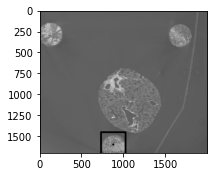

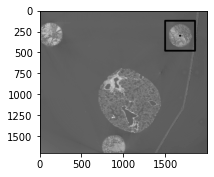

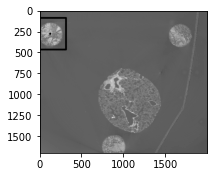

174


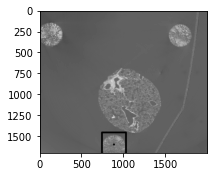

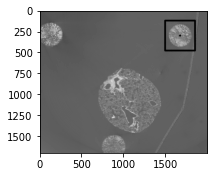

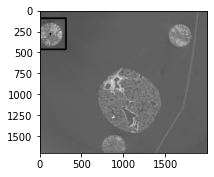

175


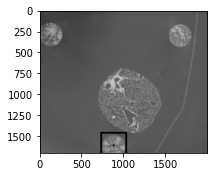

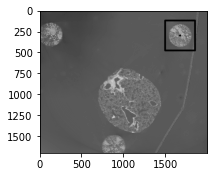

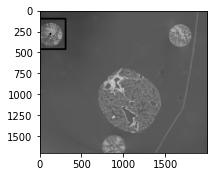

176


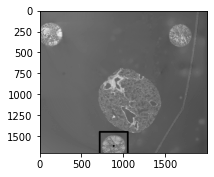

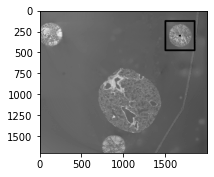

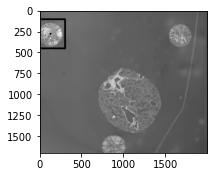

177


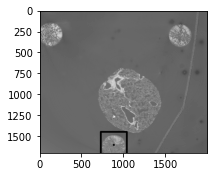

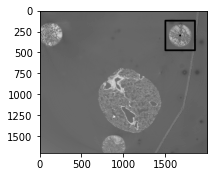

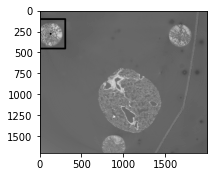

178


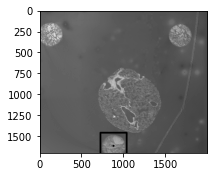

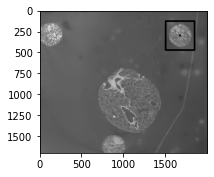

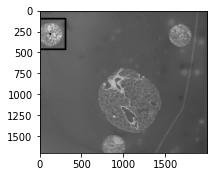

179


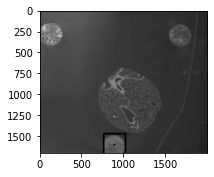

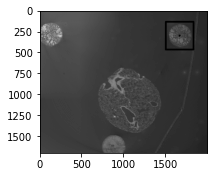

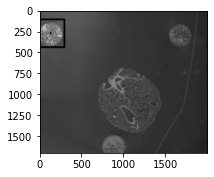

180


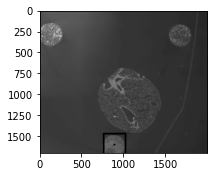

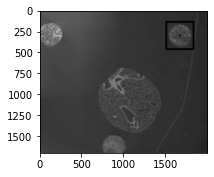

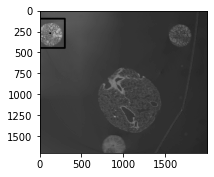

181


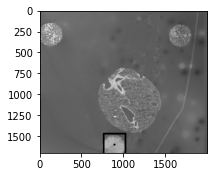

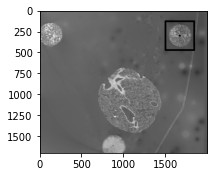

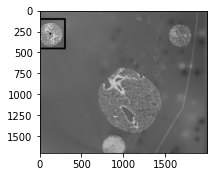

182


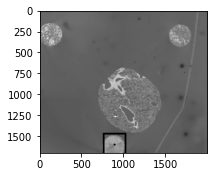

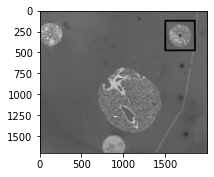

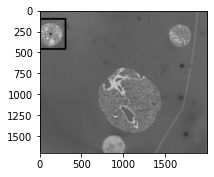

183


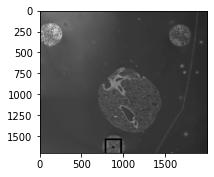

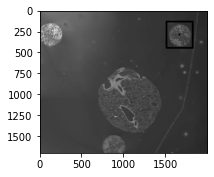

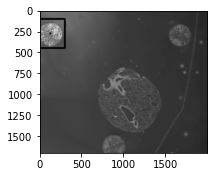

184


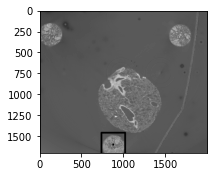

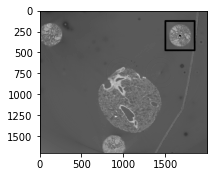

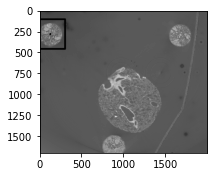

185


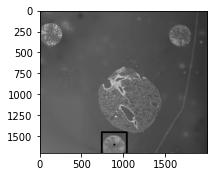

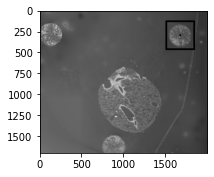

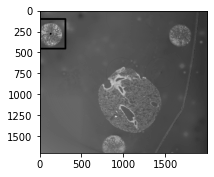

186


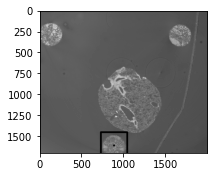

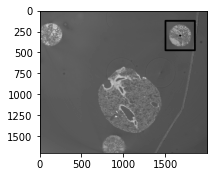

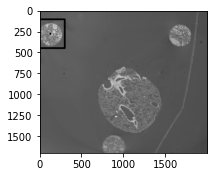

187


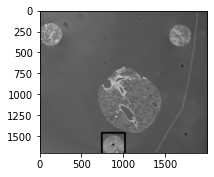

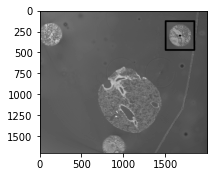

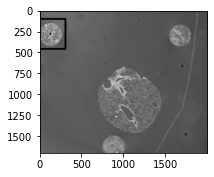

188


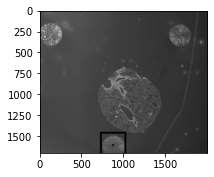

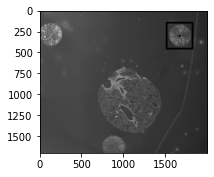

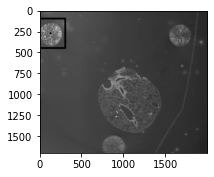

189


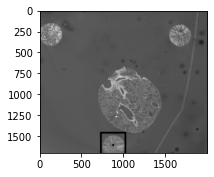

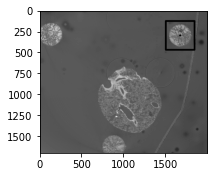

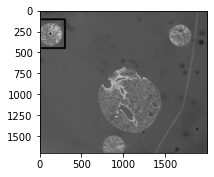

190


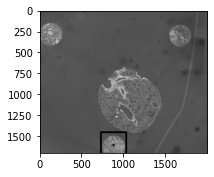

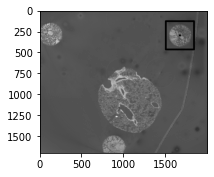

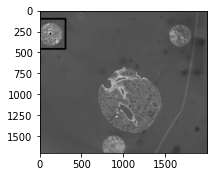

191


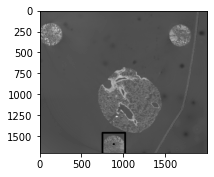

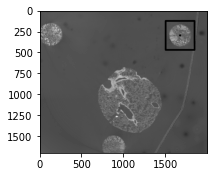

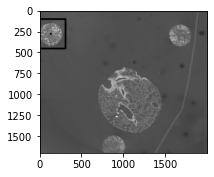

192


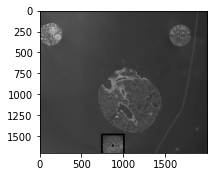

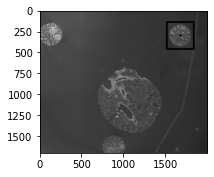

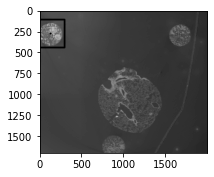

193


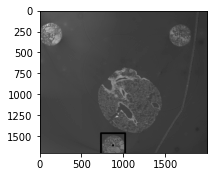

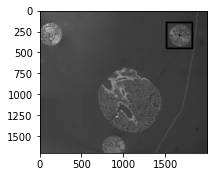

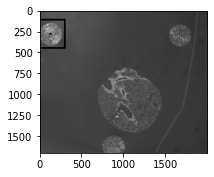

194


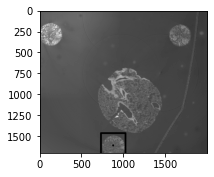

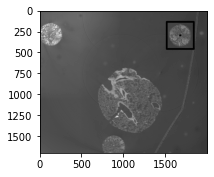

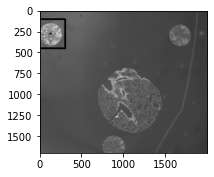

195


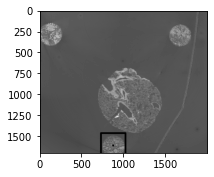

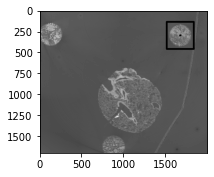

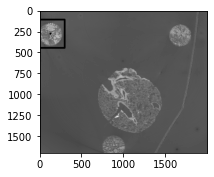

196


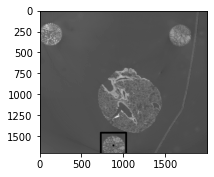

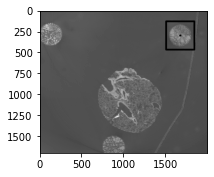

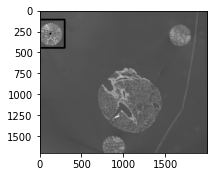

197


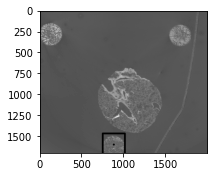

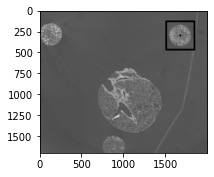

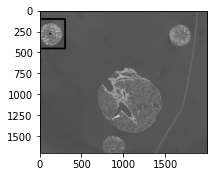

198


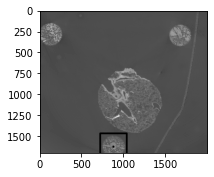

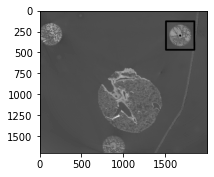

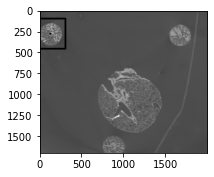

199


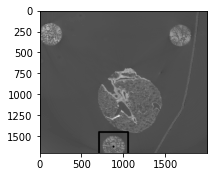

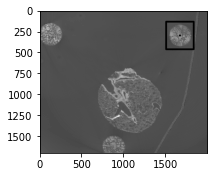

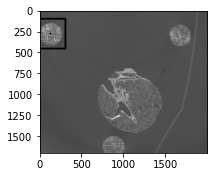

200


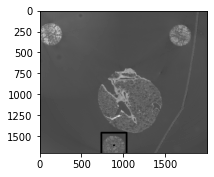

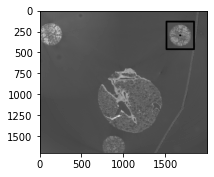

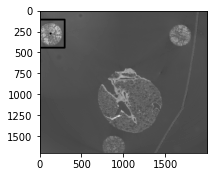

201


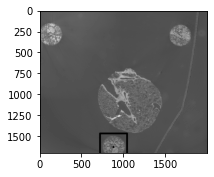

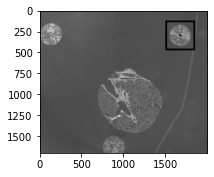

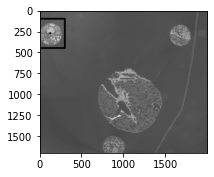

202


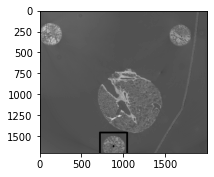

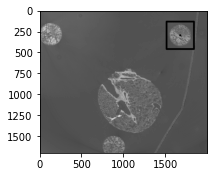

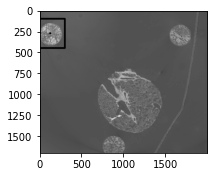

203


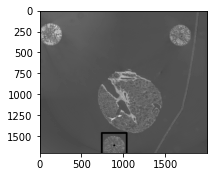

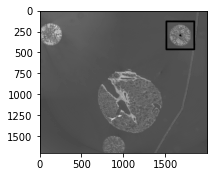

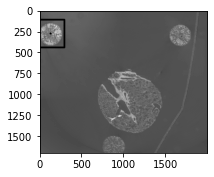

204


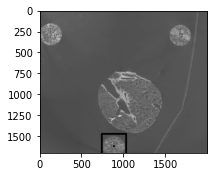

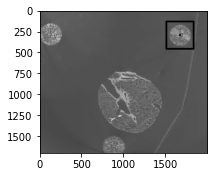

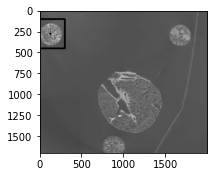

205


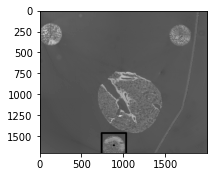

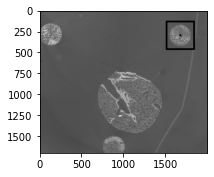

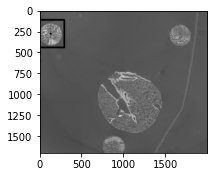

206


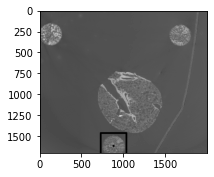

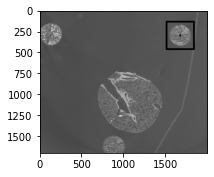

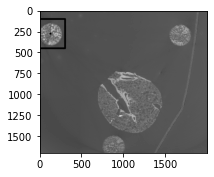

207


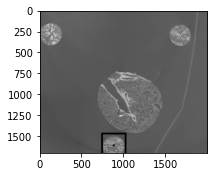

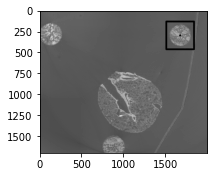

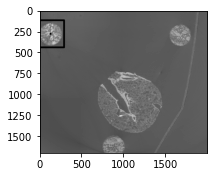

208


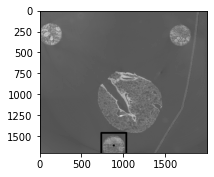

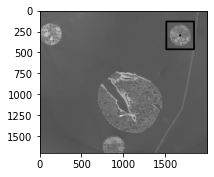

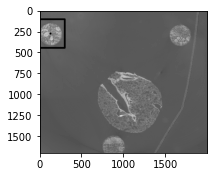

209


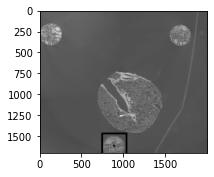

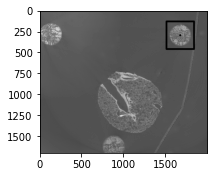

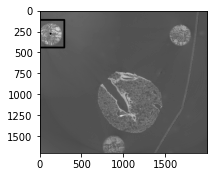

210


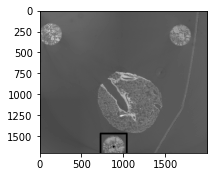

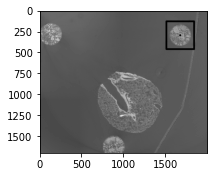

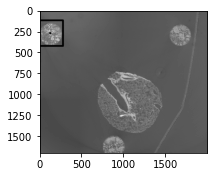

211


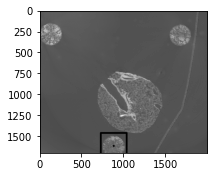

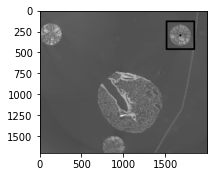

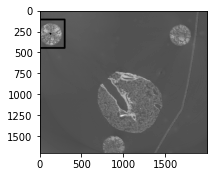

212


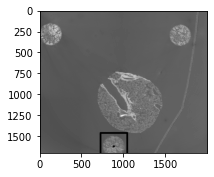

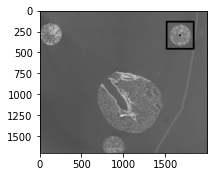

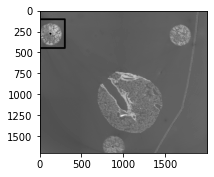

213


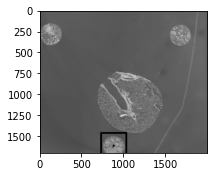

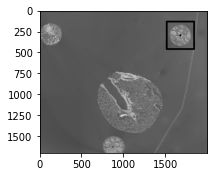

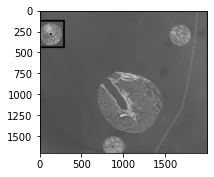

214


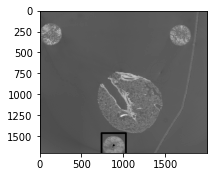

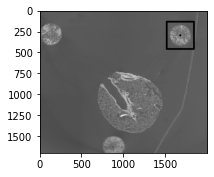

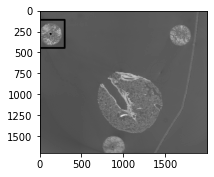

215


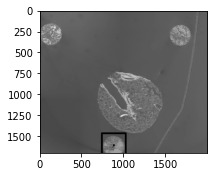

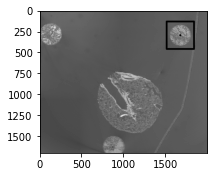

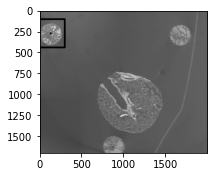

216


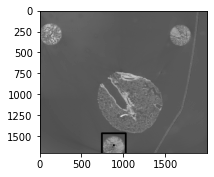

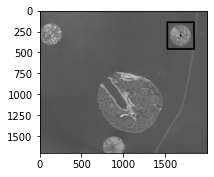

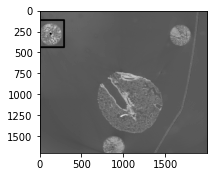

217


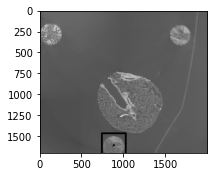

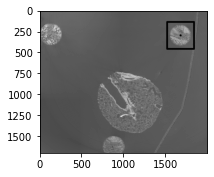

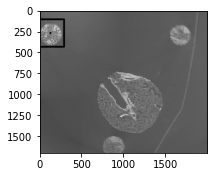

218


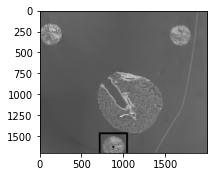

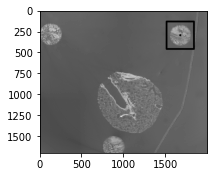

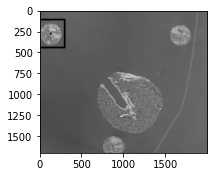

219


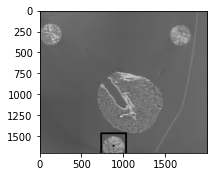

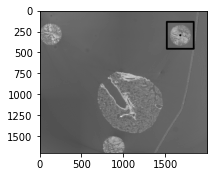

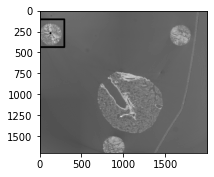

220


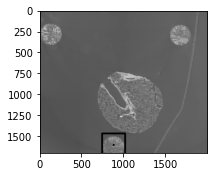

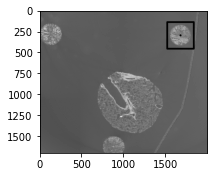

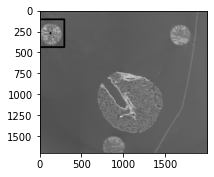

221


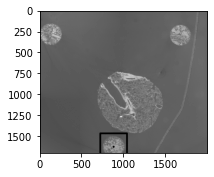

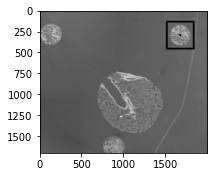

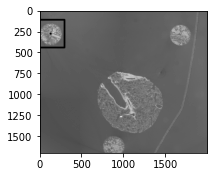

222


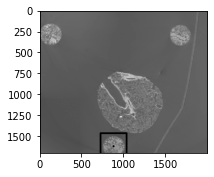

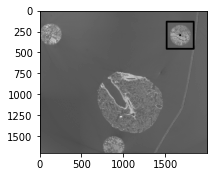

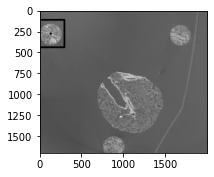

223


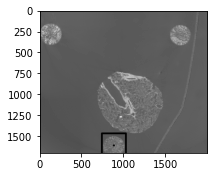

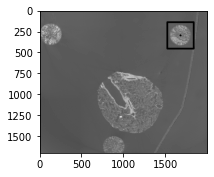

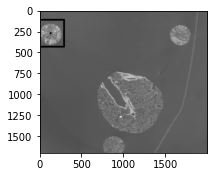

224


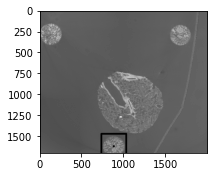

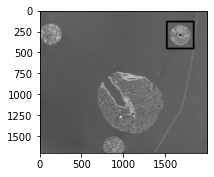

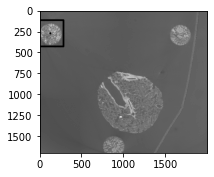

225


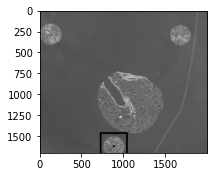

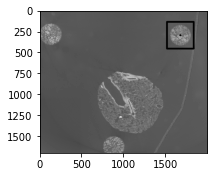

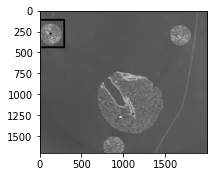

226


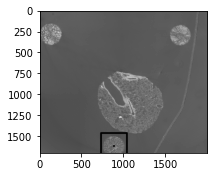

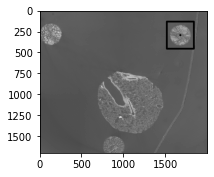

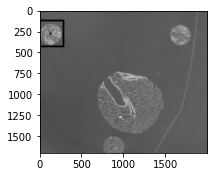

227


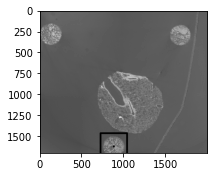

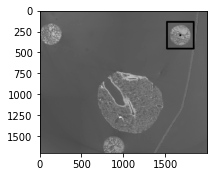

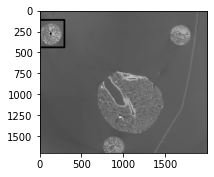

228


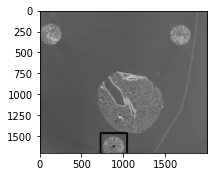

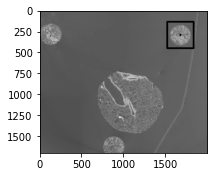

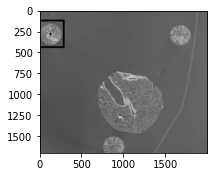

229


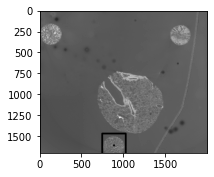

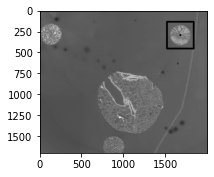

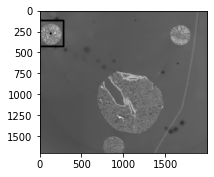

230


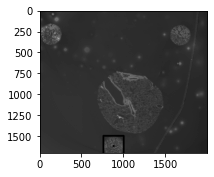

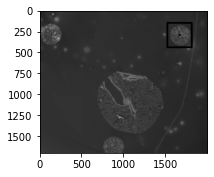

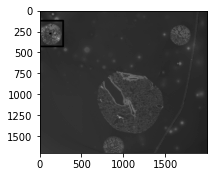

231


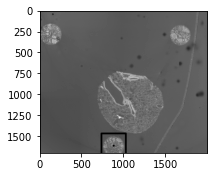

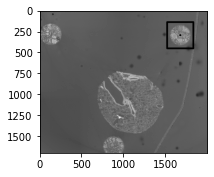

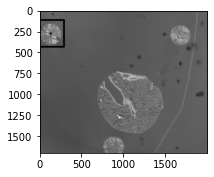

232


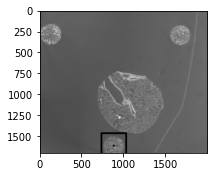

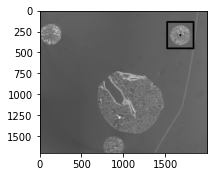

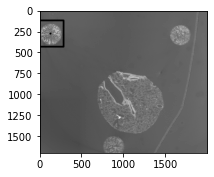

233


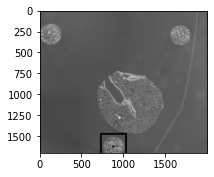

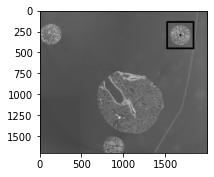

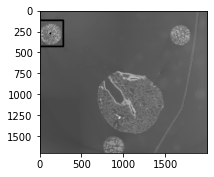

234


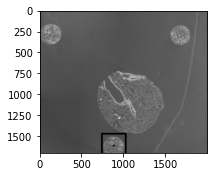

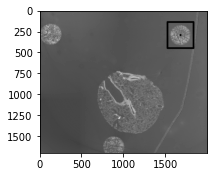

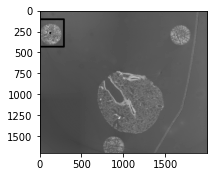

235


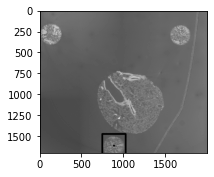

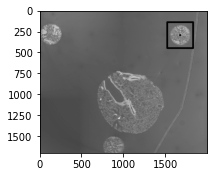

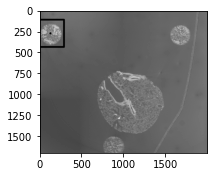

236


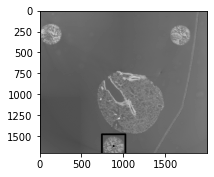

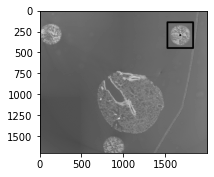

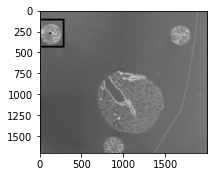

237


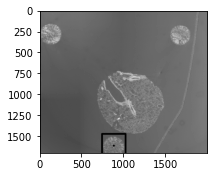

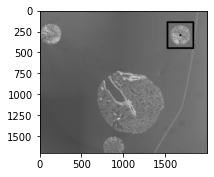

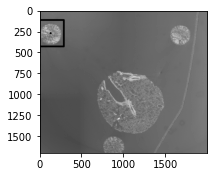

238


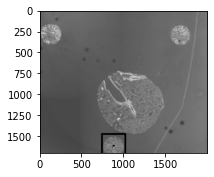

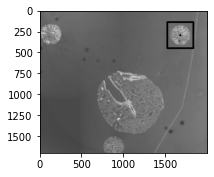

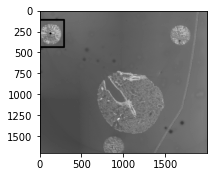

239


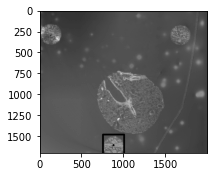

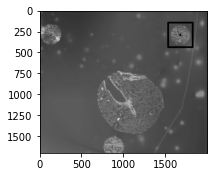

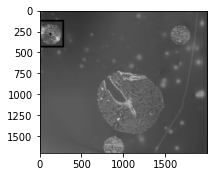

240


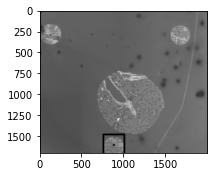

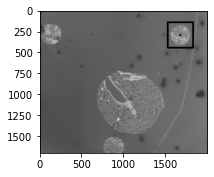

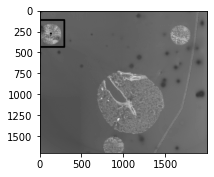

241


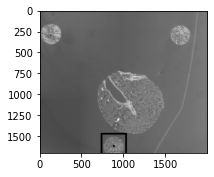

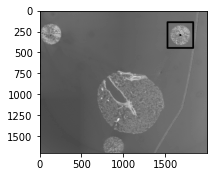

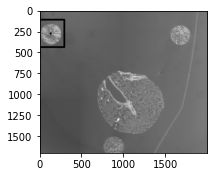

242


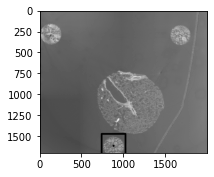

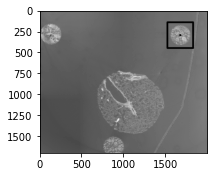

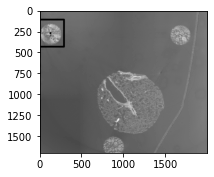

243


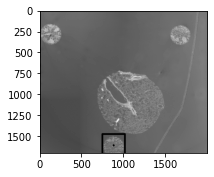

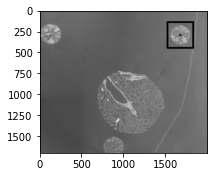

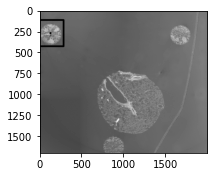

244


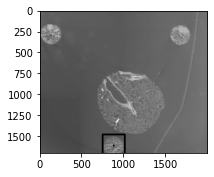

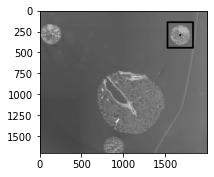

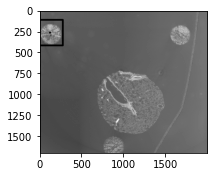

245


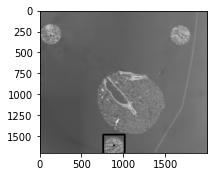

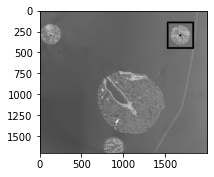

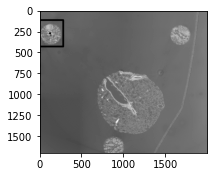

246


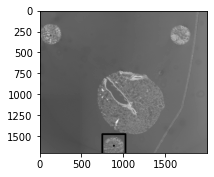

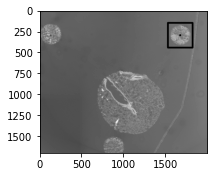

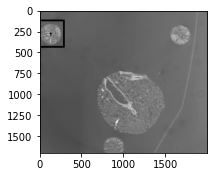

247


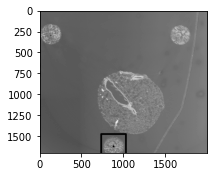

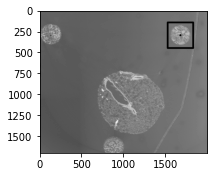

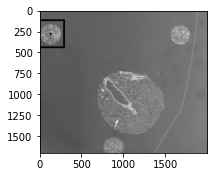

248


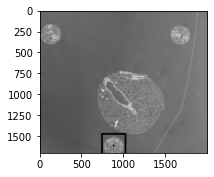

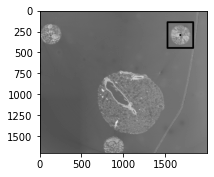

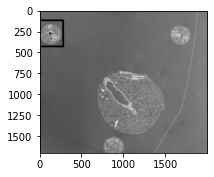

249


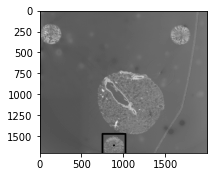

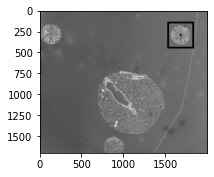

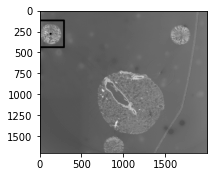

250


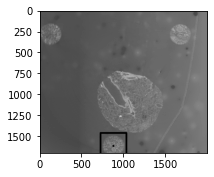

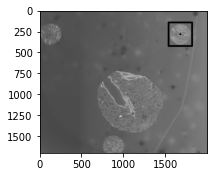

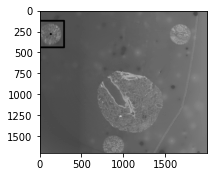

251


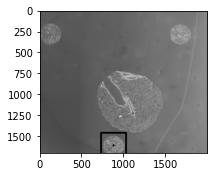

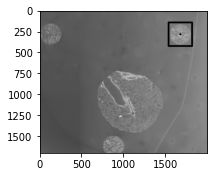

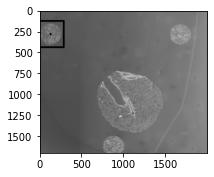

252


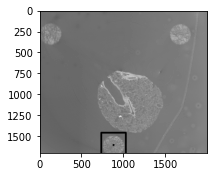

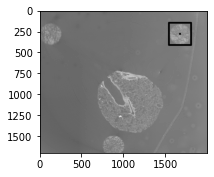

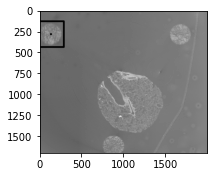

254


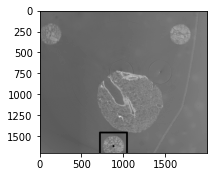

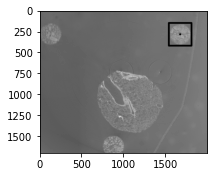

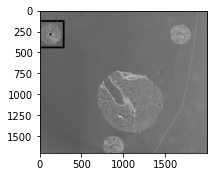

255


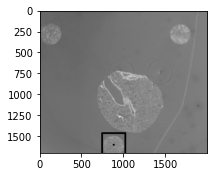

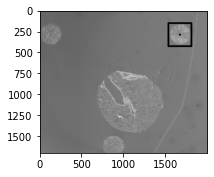

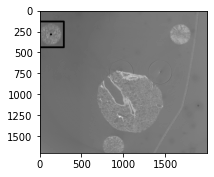

256


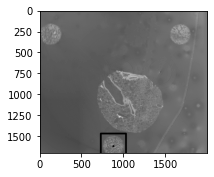

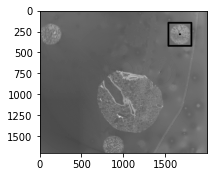

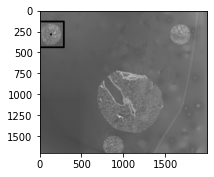

257


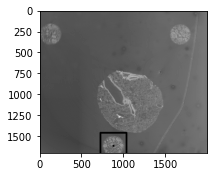

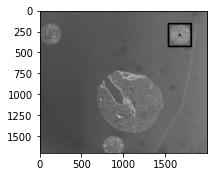

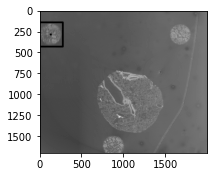

258


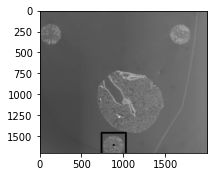

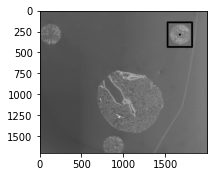

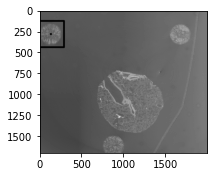

259


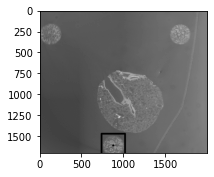

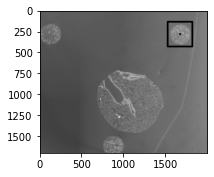

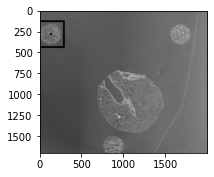

260


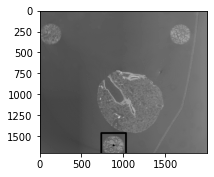

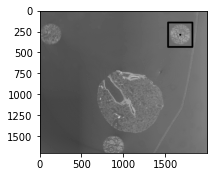

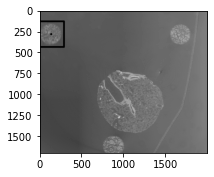

261


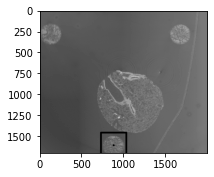

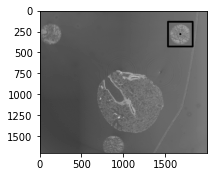

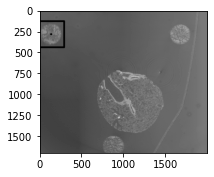

262


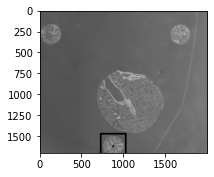

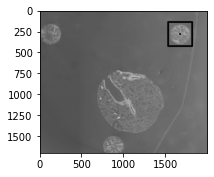

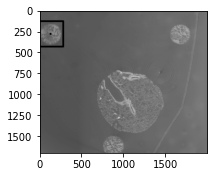

263


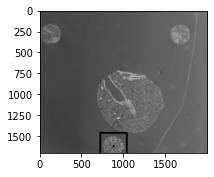

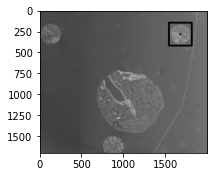

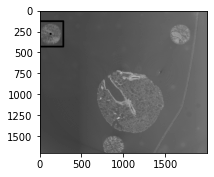

264


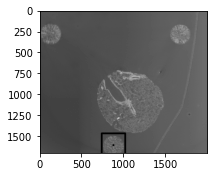

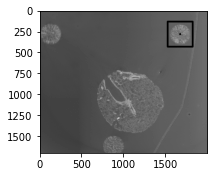

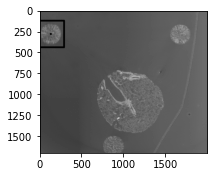

265


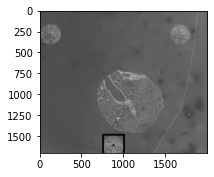

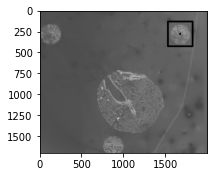

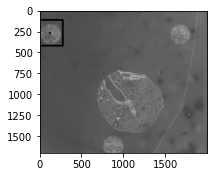

266


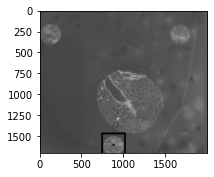

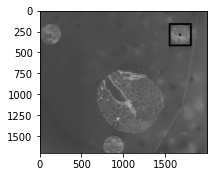

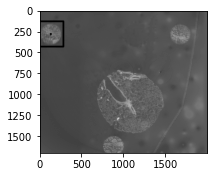

267


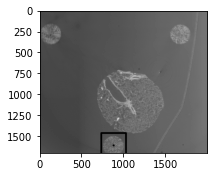

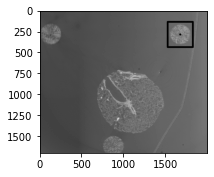

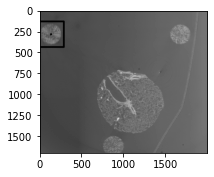

268


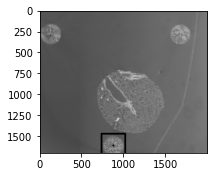

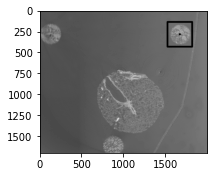

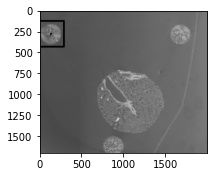

269


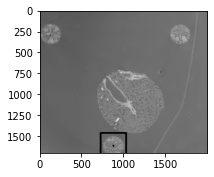

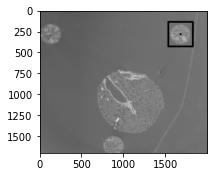

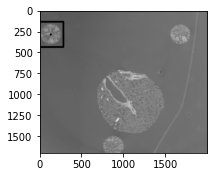

270


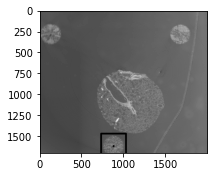

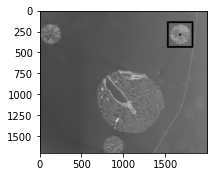

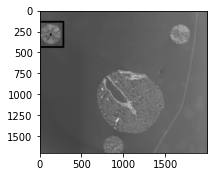

271


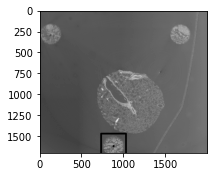

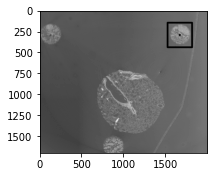

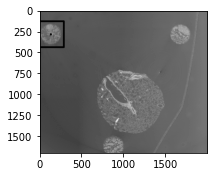

272


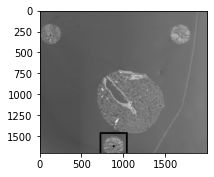

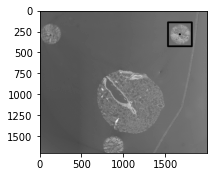

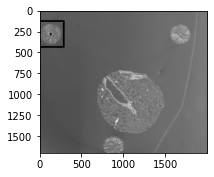

273


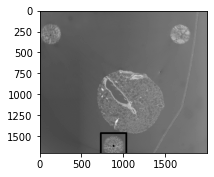

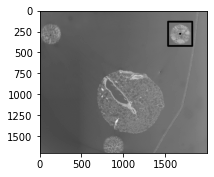

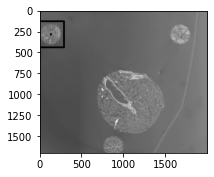

274


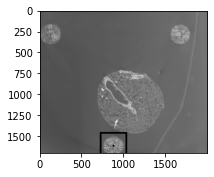

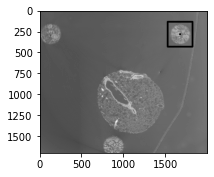

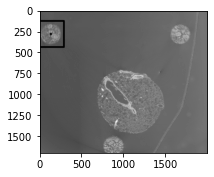

275


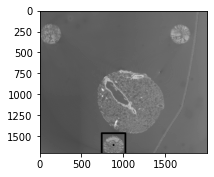

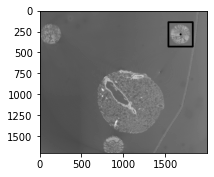

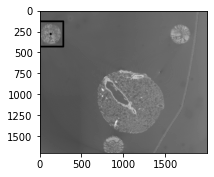

276


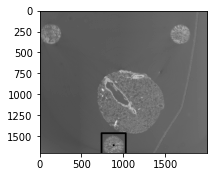

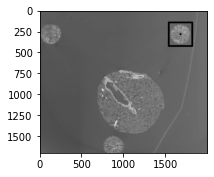

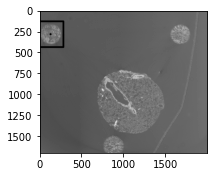

277


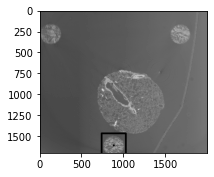

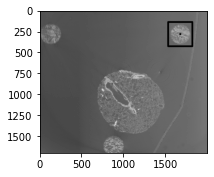

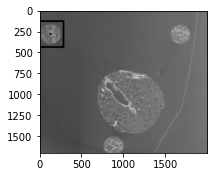

278


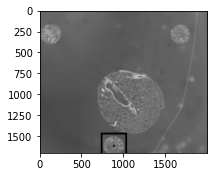

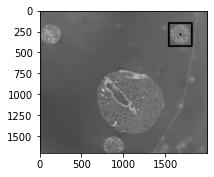

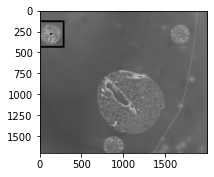

279


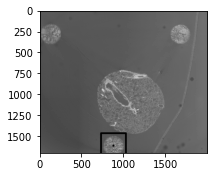

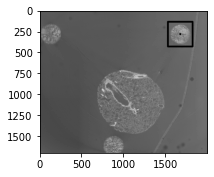

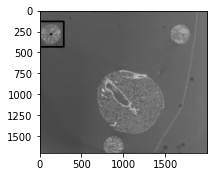

280


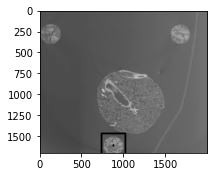

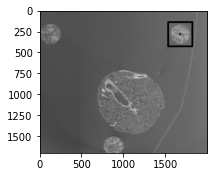

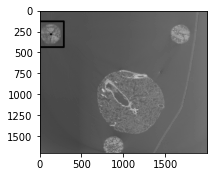

281


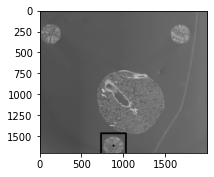

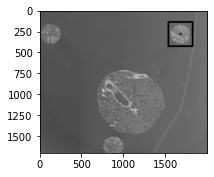

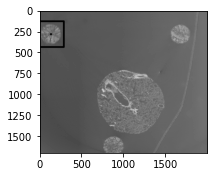

282


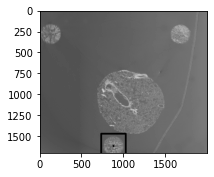

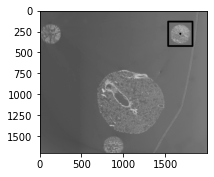

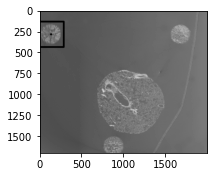

283


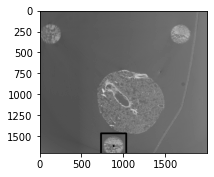

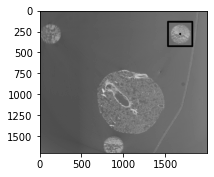

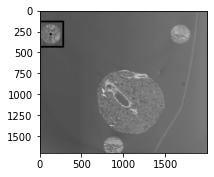

284


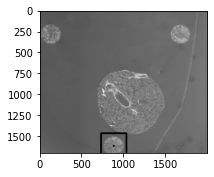

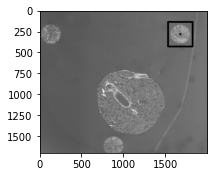

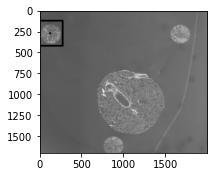

285


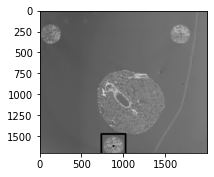

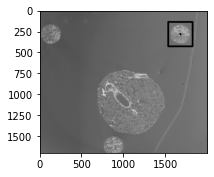

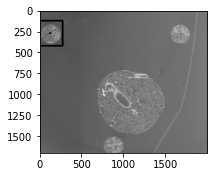

286


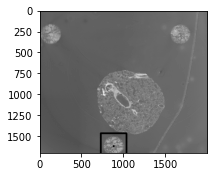

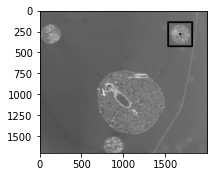

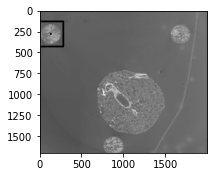

287


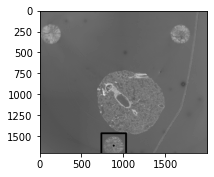

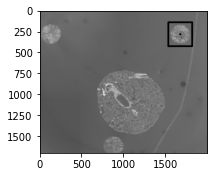

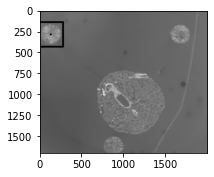

288


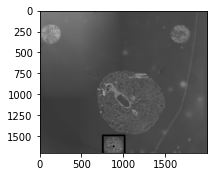

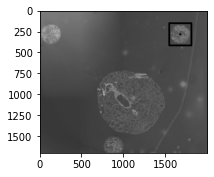

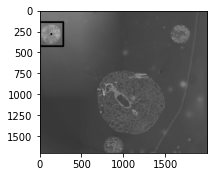

289


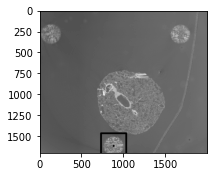

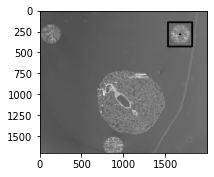

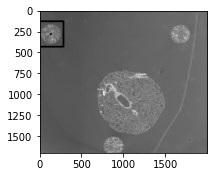

290


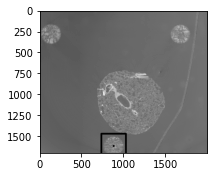

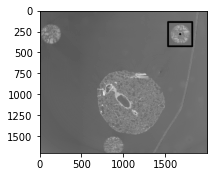

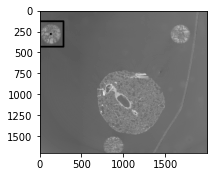

291


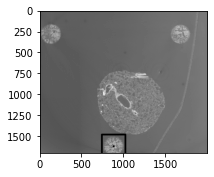

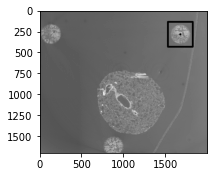

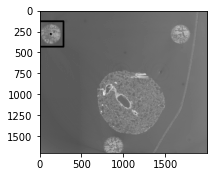

292


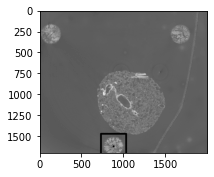

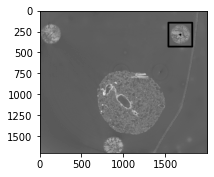

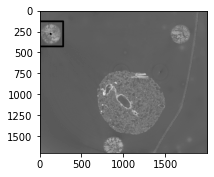

293


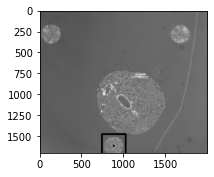

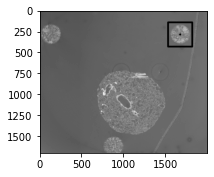

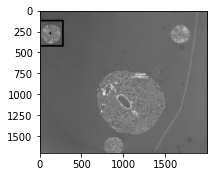

294


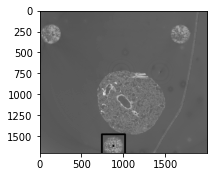

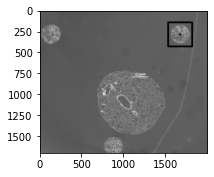

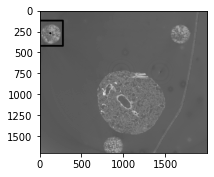

295


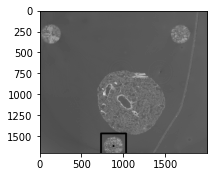

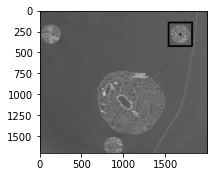

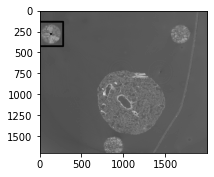

296


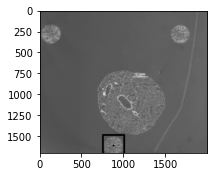

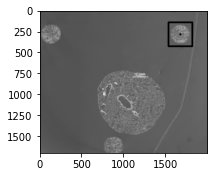

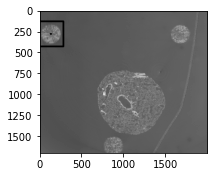

297


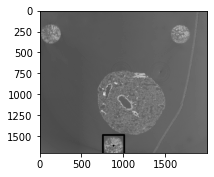

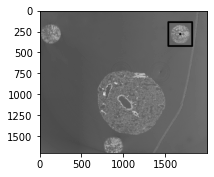

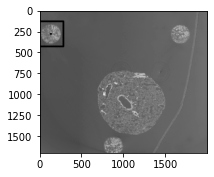

298


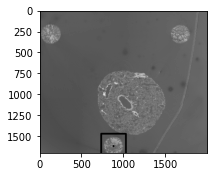

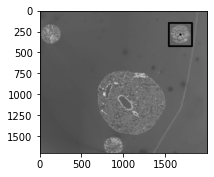

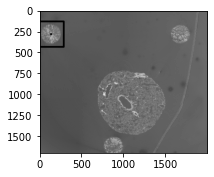

299


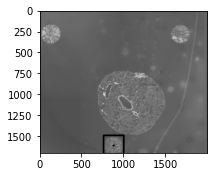

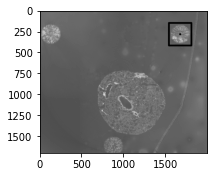

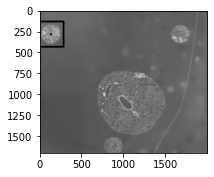

300


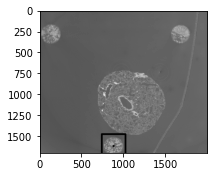

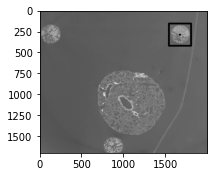

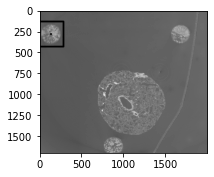

301


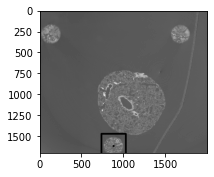

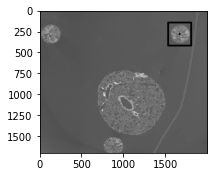

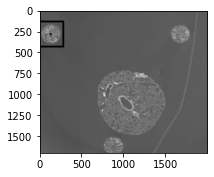

302


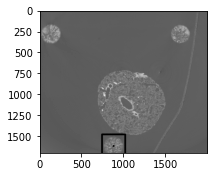

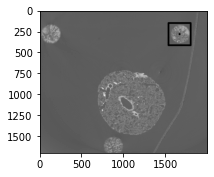

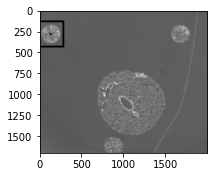

303


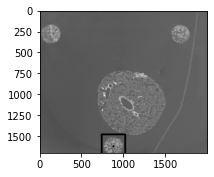

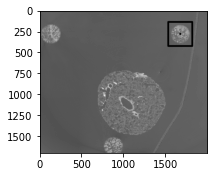

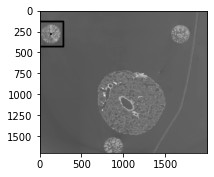

304


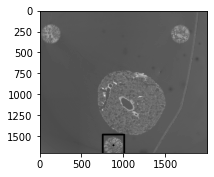

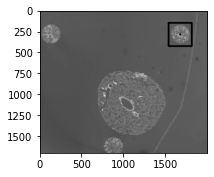

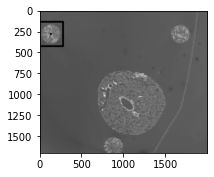

305


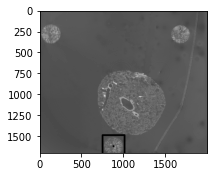

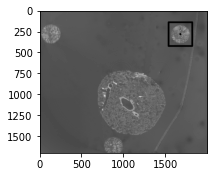

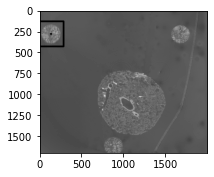

306


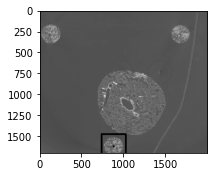

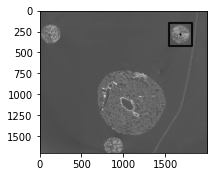

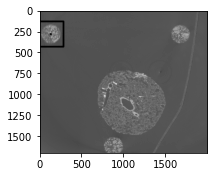

307


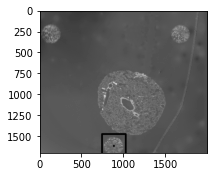

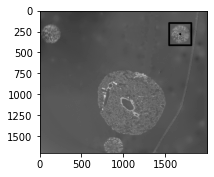

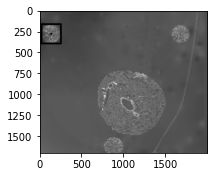

308


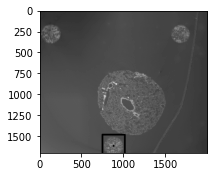

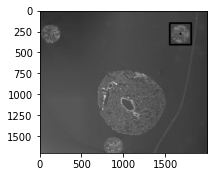

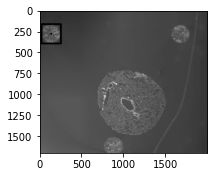

309


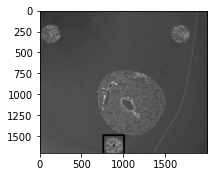

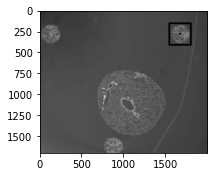

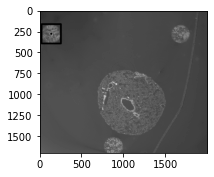

310


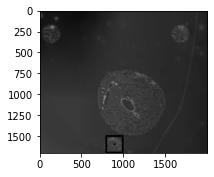

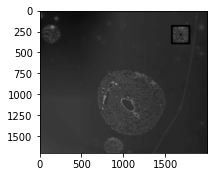

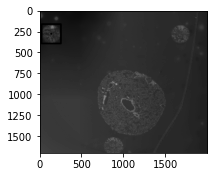

311


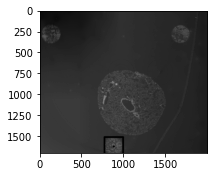

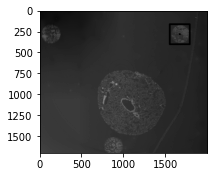

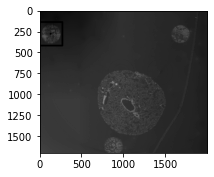

312


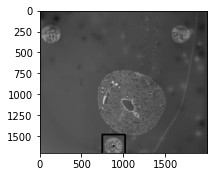

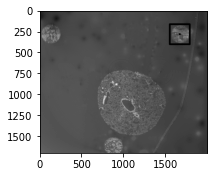

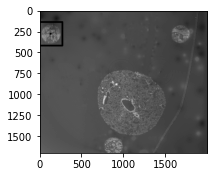

313


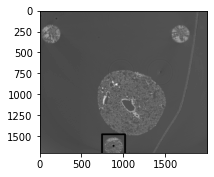

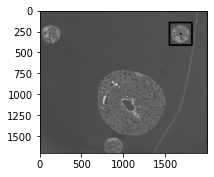

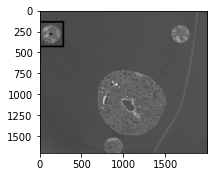

314


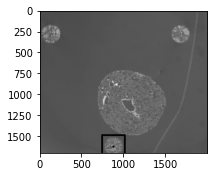

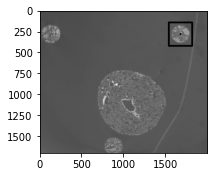

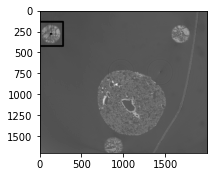

315


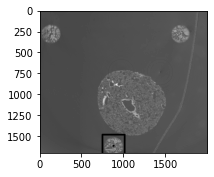

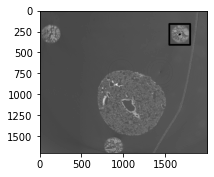

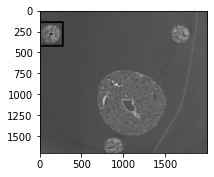

316


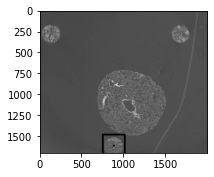

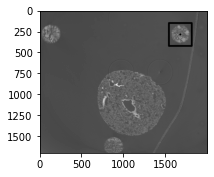

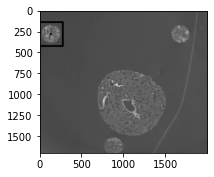

317


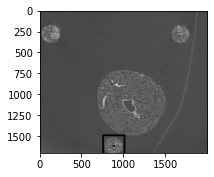

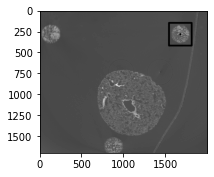

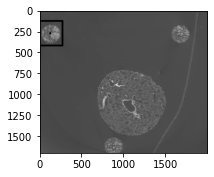

318


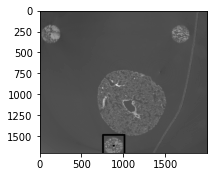

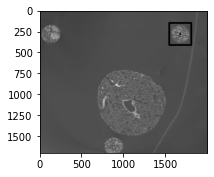

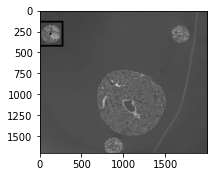

319


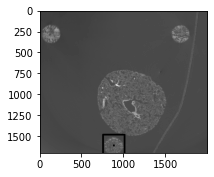

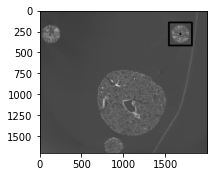

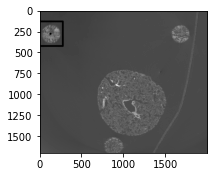

320


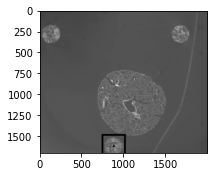

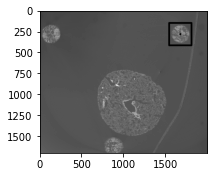

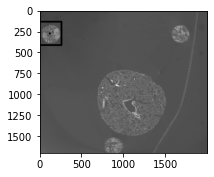

321


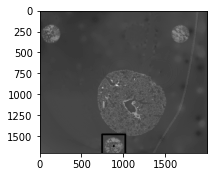

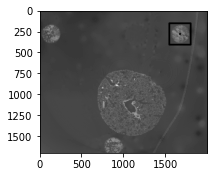

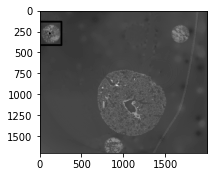

322


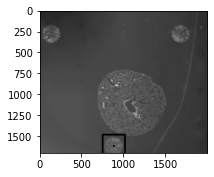

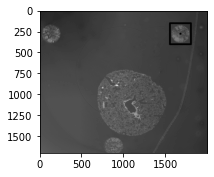

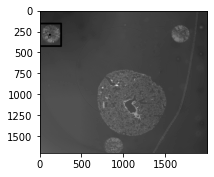

323


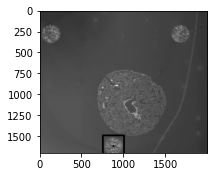

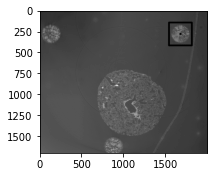

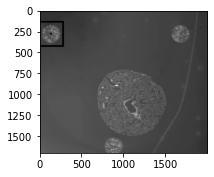

324


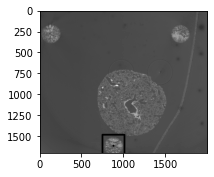

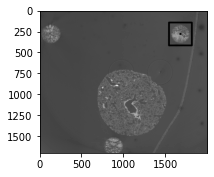

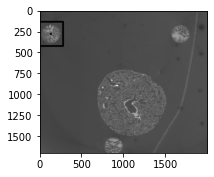

325


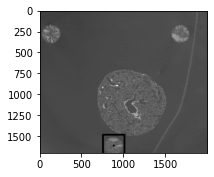

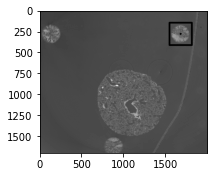

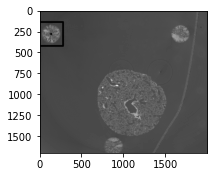

326


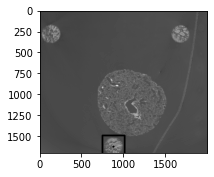

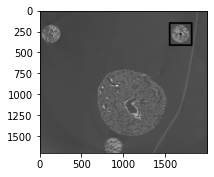

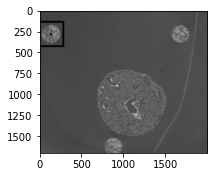

327


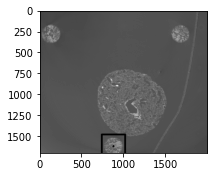

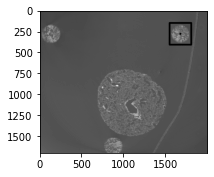

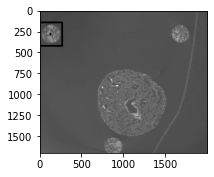

328


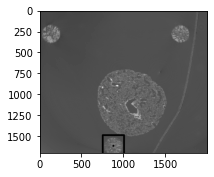

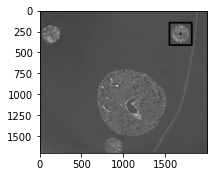

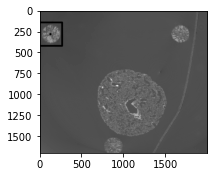

329


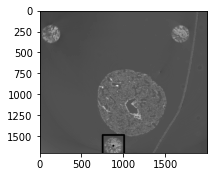

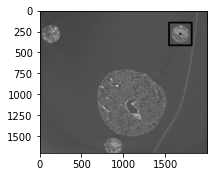

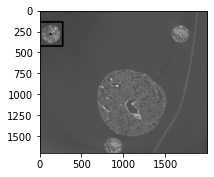

330


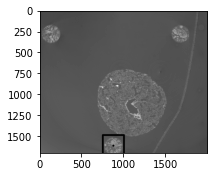

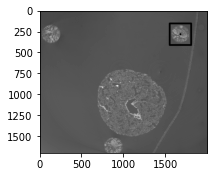

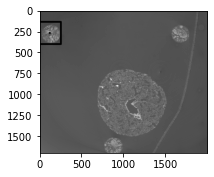

331


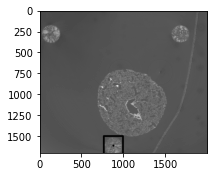

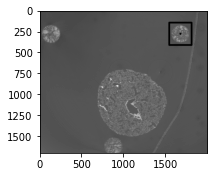

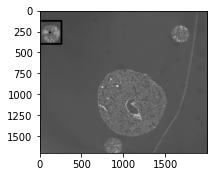

332


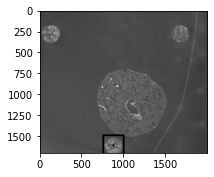

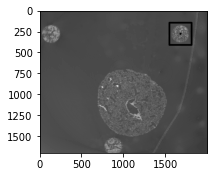

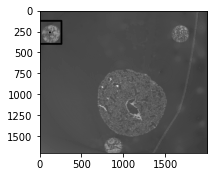

333


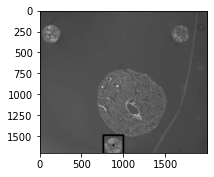

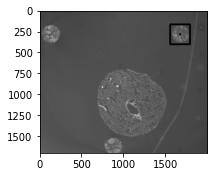

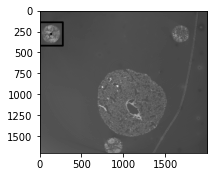

334


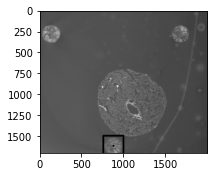

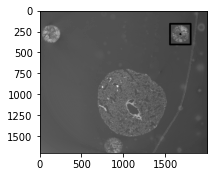

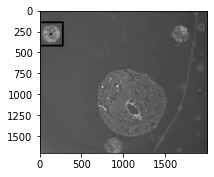

335


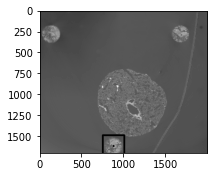

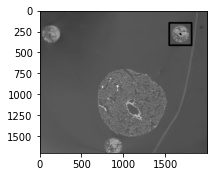

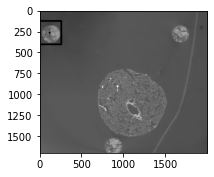

336


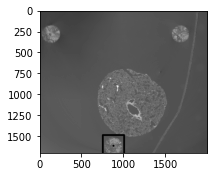

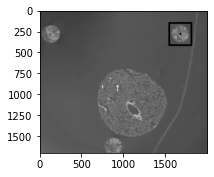

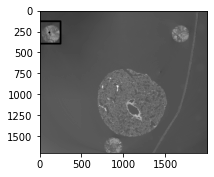

337


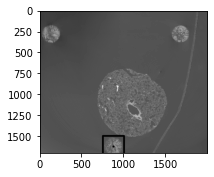

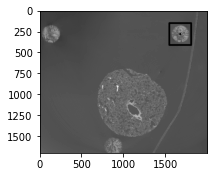

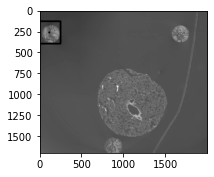

338


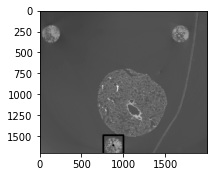

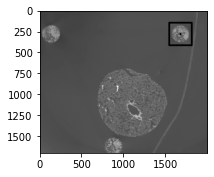

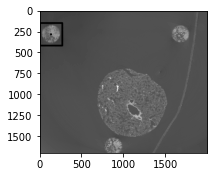

339


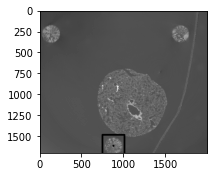

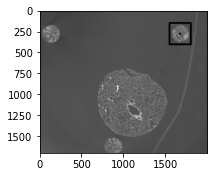

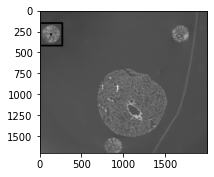

340


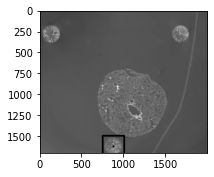

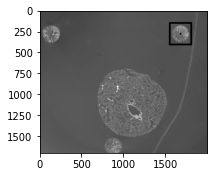

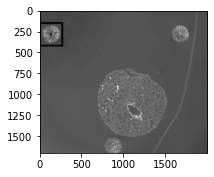

341


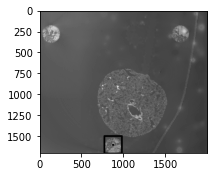

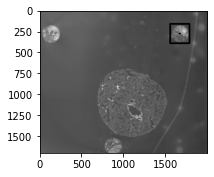

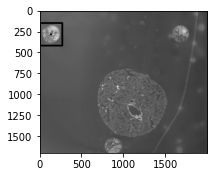

342


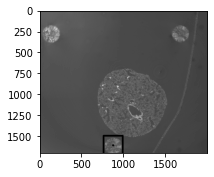

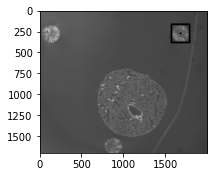

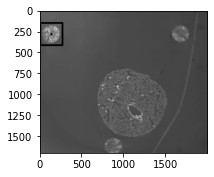

343


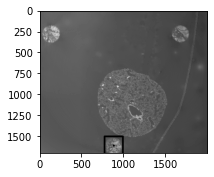

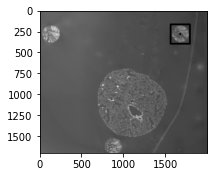

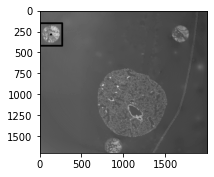

344


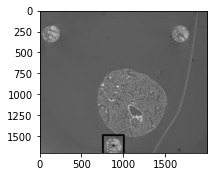

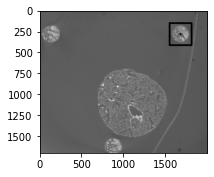

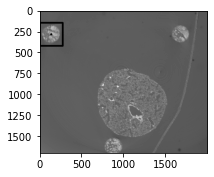

345


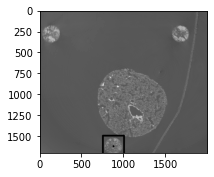

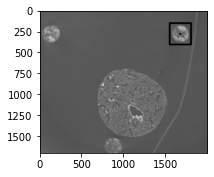

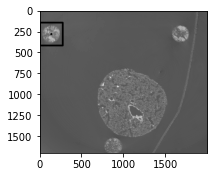

346


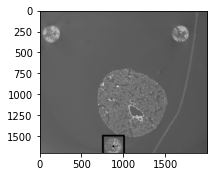

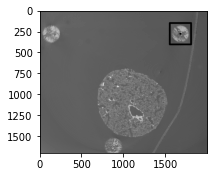

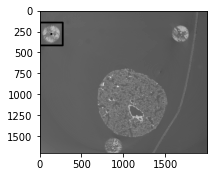

347


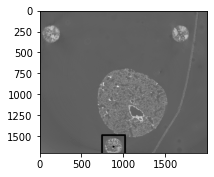

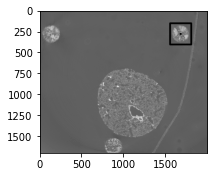

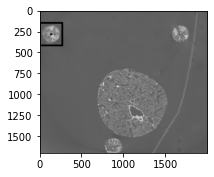

348


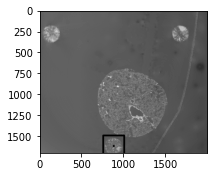

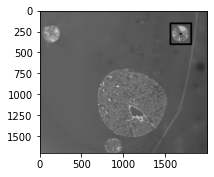

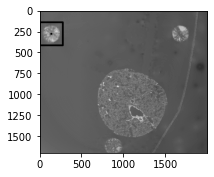

349


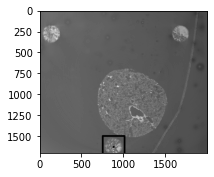

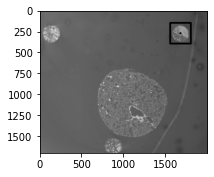

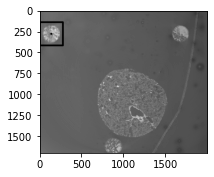

350


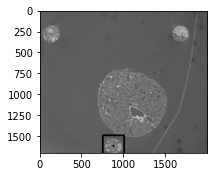

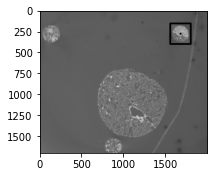

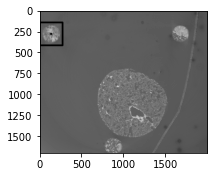

351


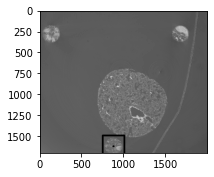

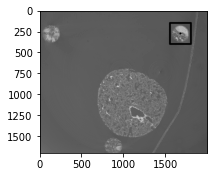

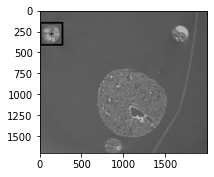

352


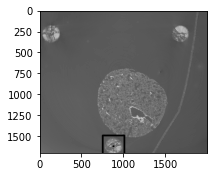

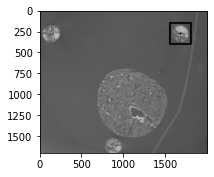

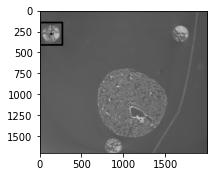

353


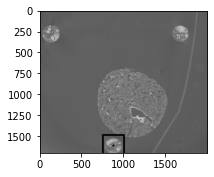

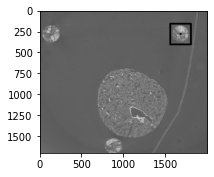

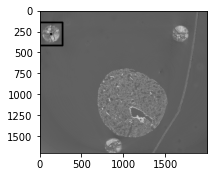

354


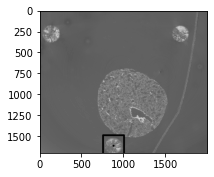

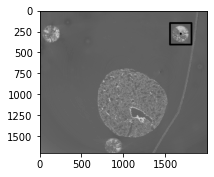

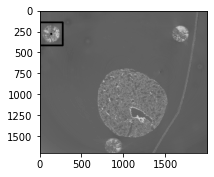

355


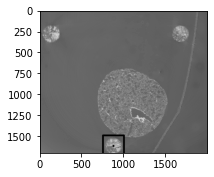

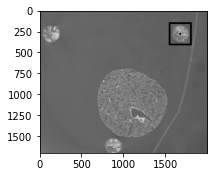

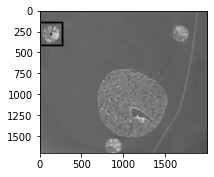

356


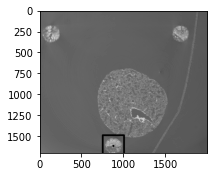

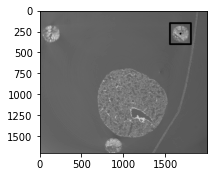

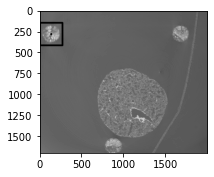

357


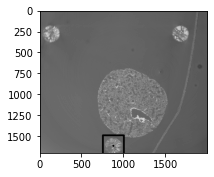

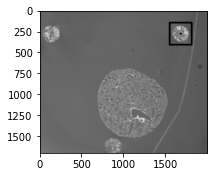

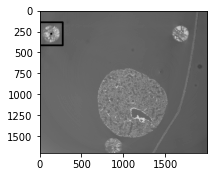

358


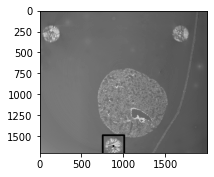

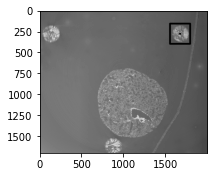

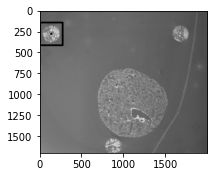

359


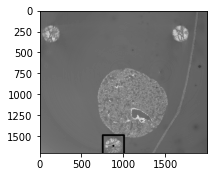

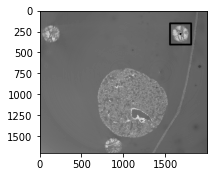

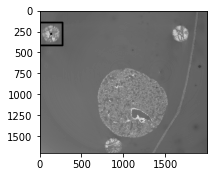

360


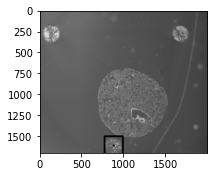

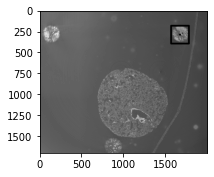

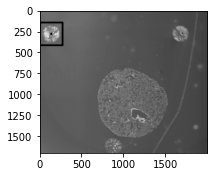

361


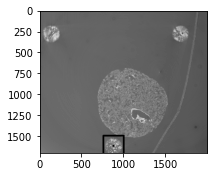

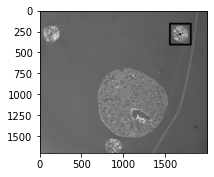

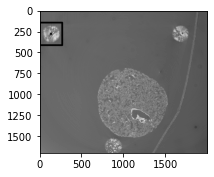

362


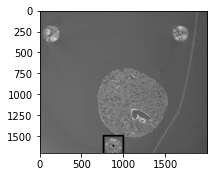

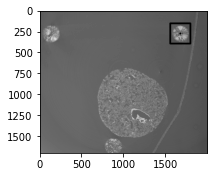

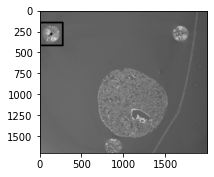

363


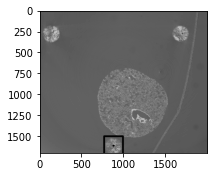

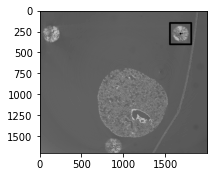

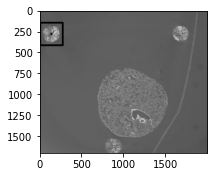

364


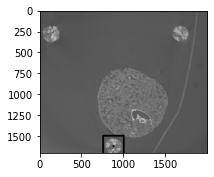

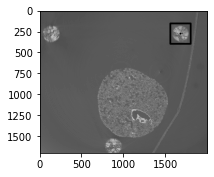

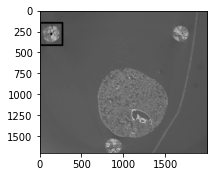

365


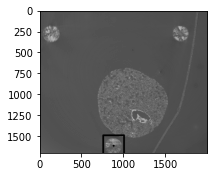

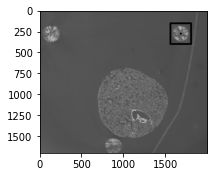

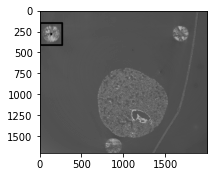

366


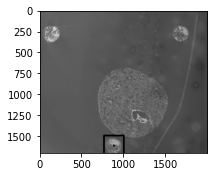

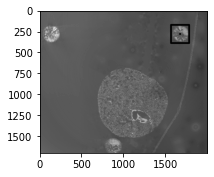

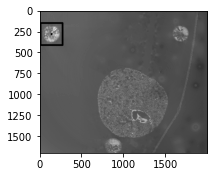

367


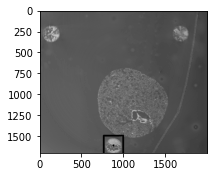

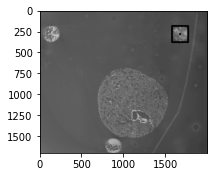

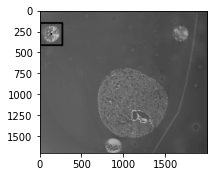

368


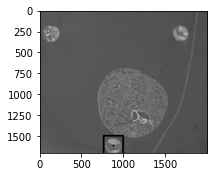

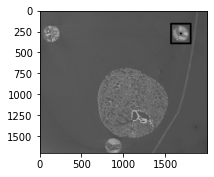

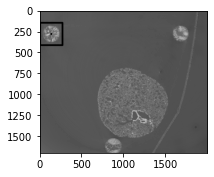

369


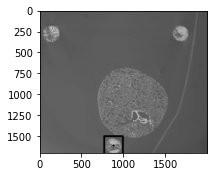

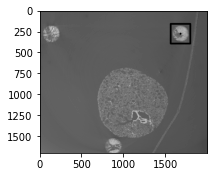

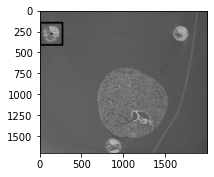

370


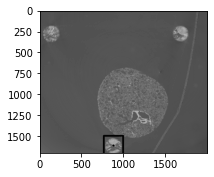

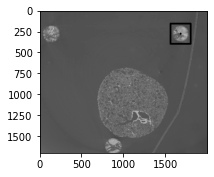

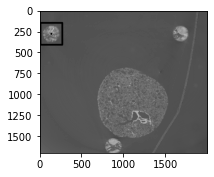

371


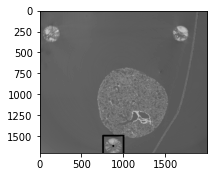

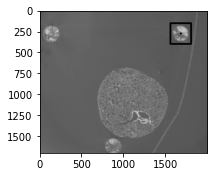

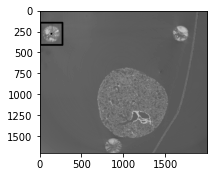

372


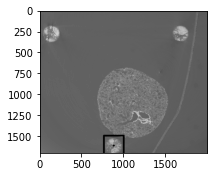

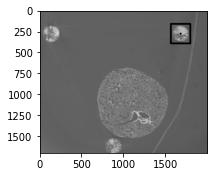

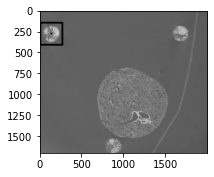

373


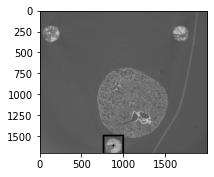

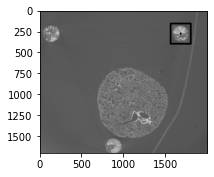

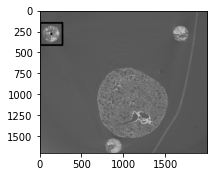

374


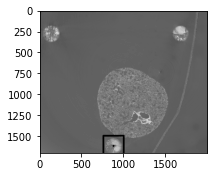

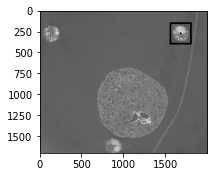

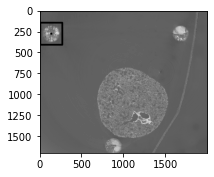

375


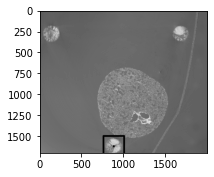

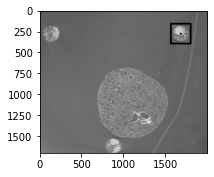

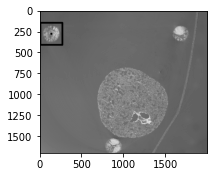

376


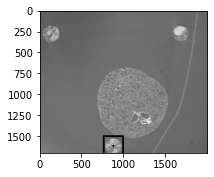

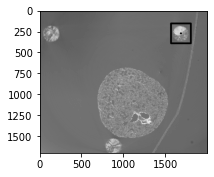

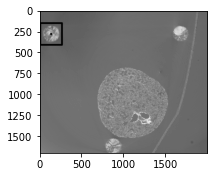

377


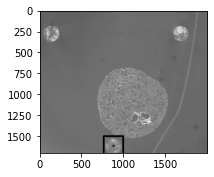

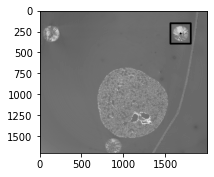

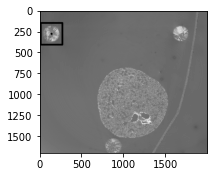

378


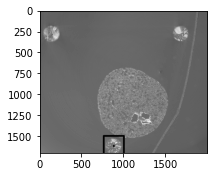

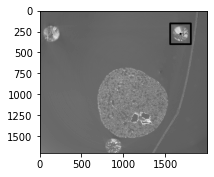

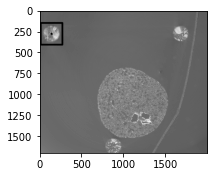

379


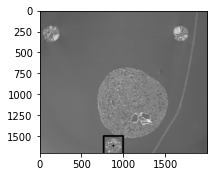

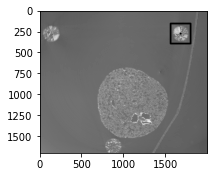

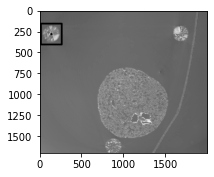

380


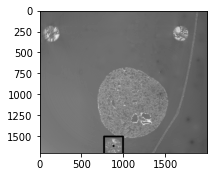

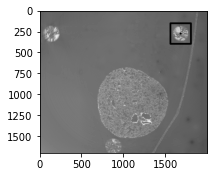

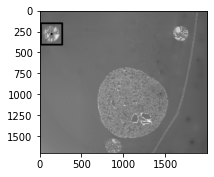

381


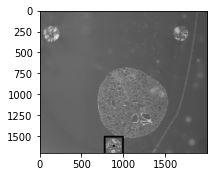

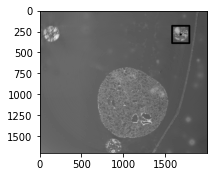

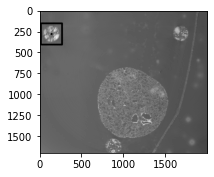

382


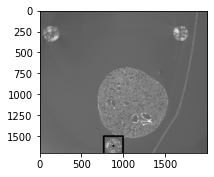

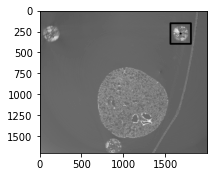

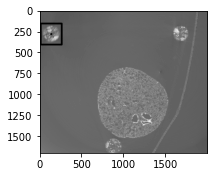

383


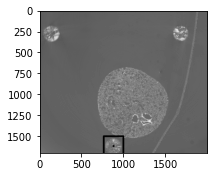

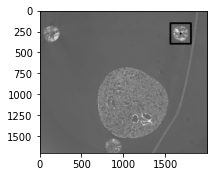

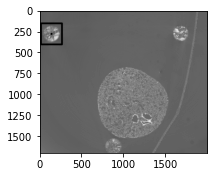

384


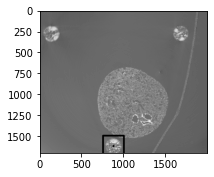

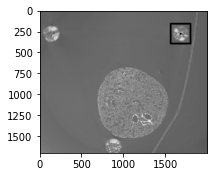

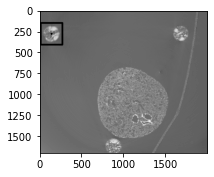

385


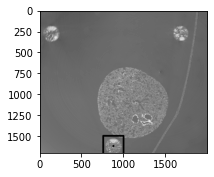

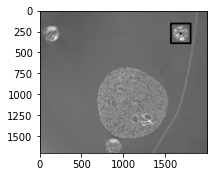

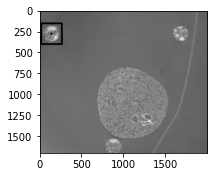

386


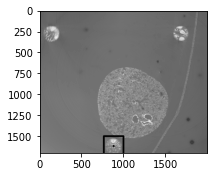

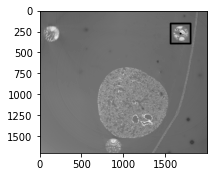

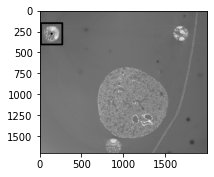

387


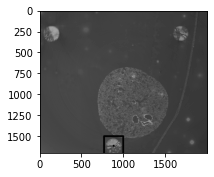

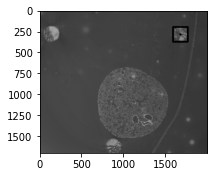

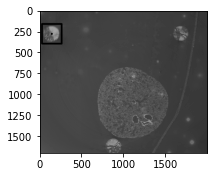

388


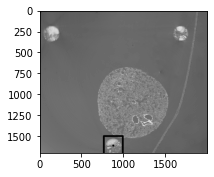

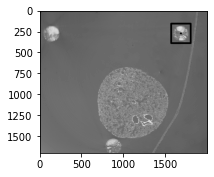

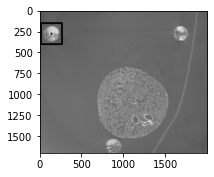

389


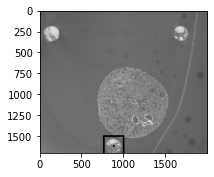

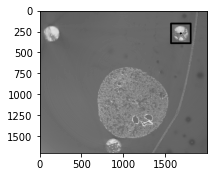

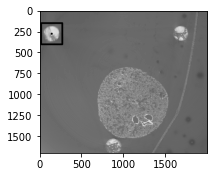

390


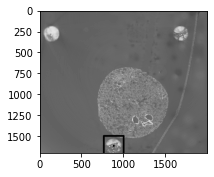

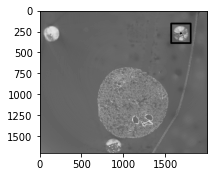

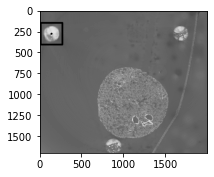

391


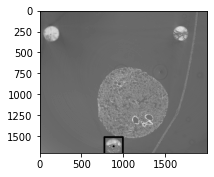

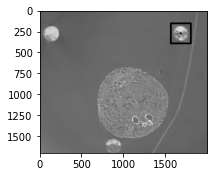

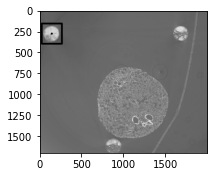

392


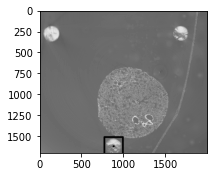

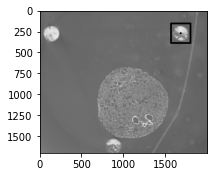

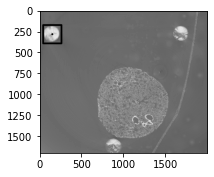

393


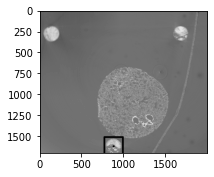

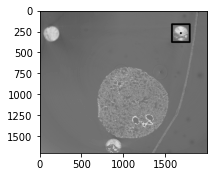

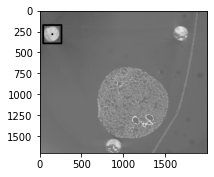

394


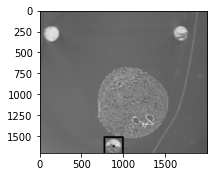

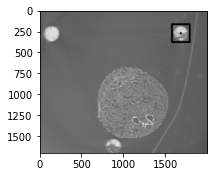

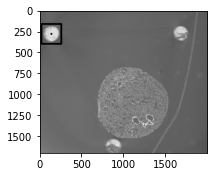

395


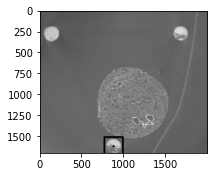

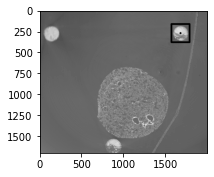

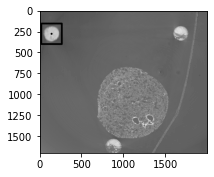

396


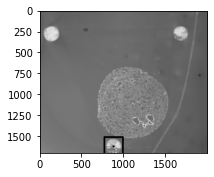

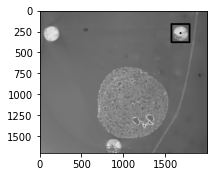

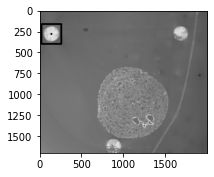

399


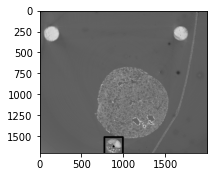

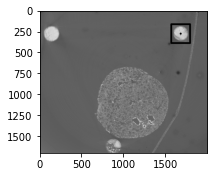

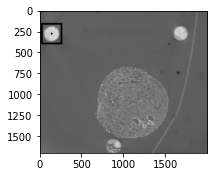

400


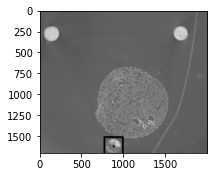

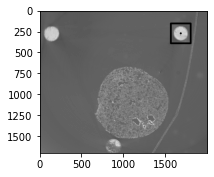

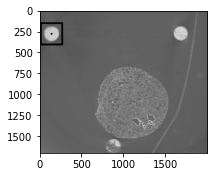

401


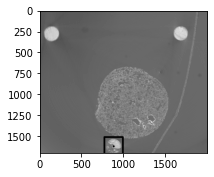

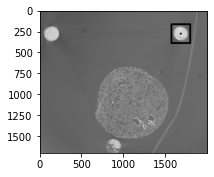

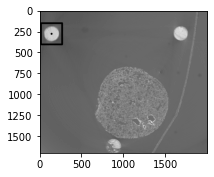

402


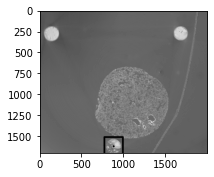

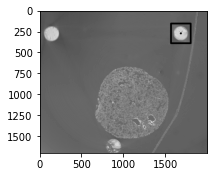

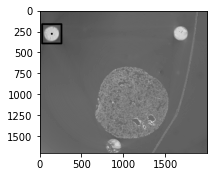

403


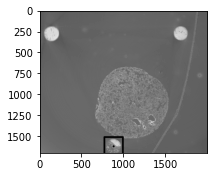

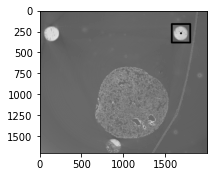

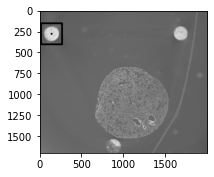

404


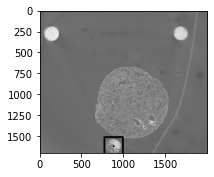

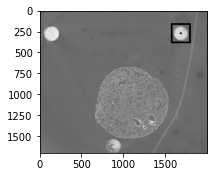

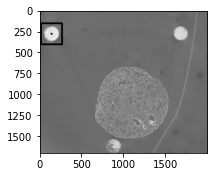

405


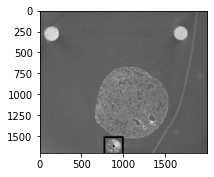

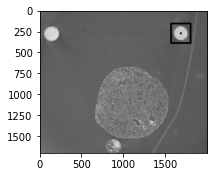

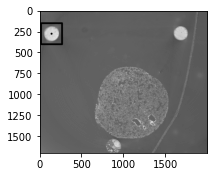

406


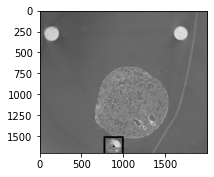

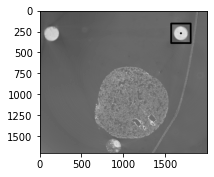

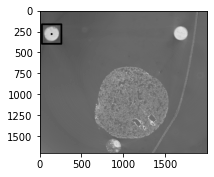

407


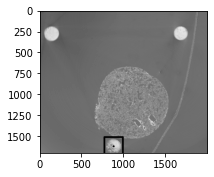

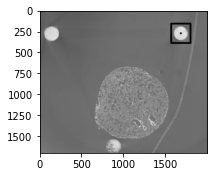

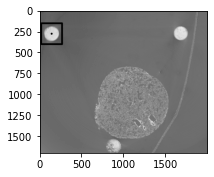

408


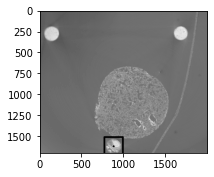

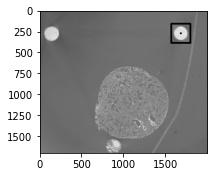

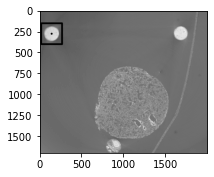

409


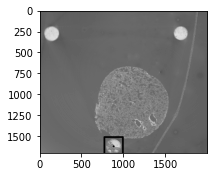

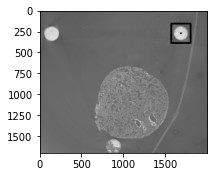

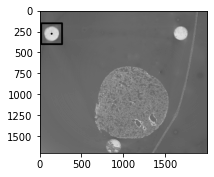

410


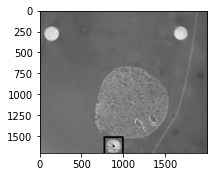

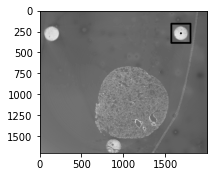

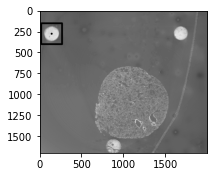

411


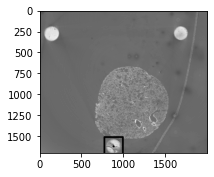

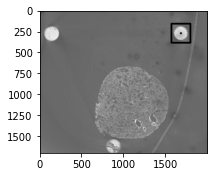

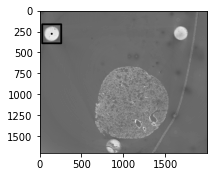

412


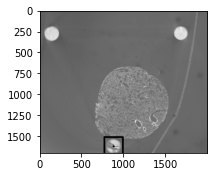

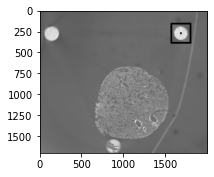

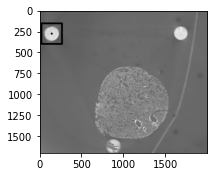

413


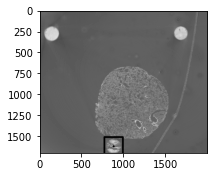

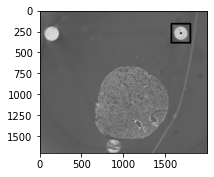

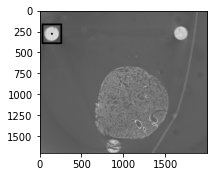

414


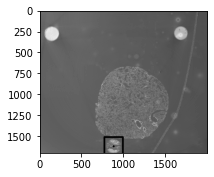

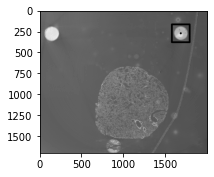

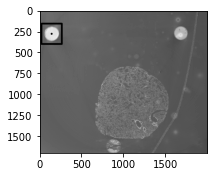

415


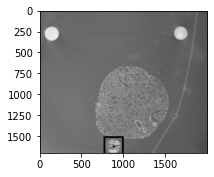

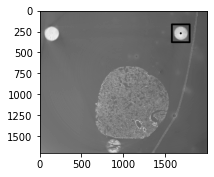

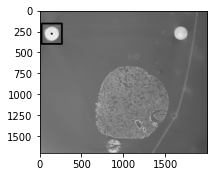

416


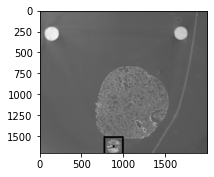

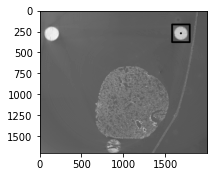

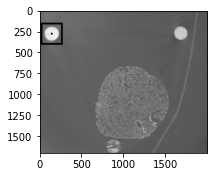

417


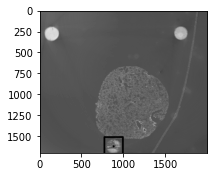

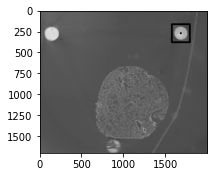

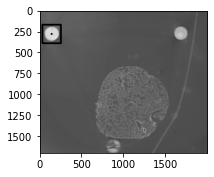

418


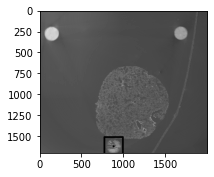

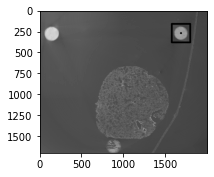

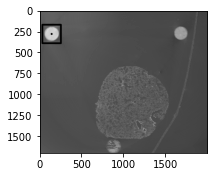

419


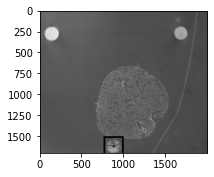

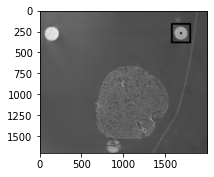

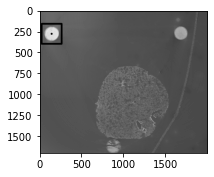

420


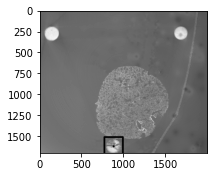

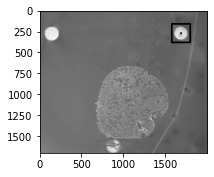

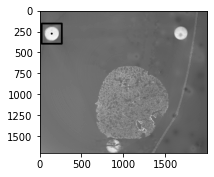

421


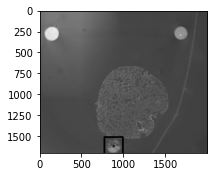

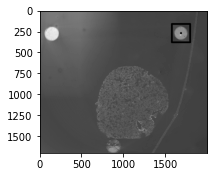

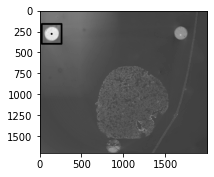

422


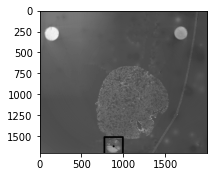

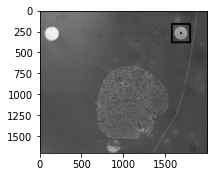

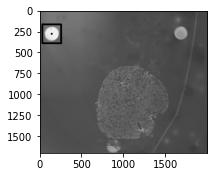

423


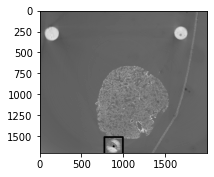

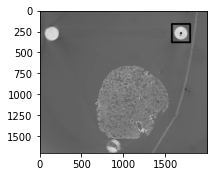

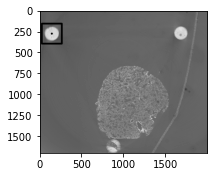

424


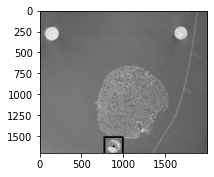

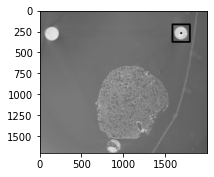

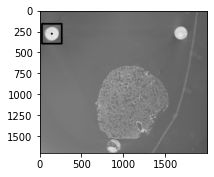

425


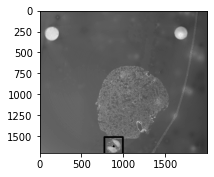

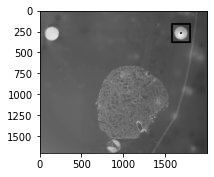

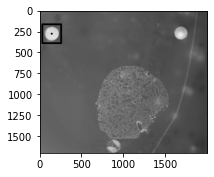

426


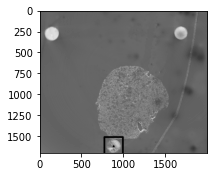

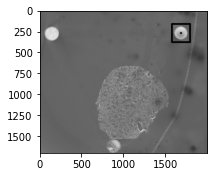

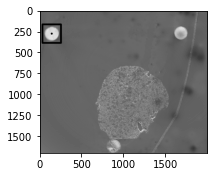

427


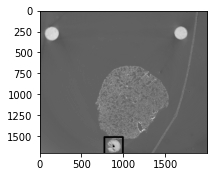

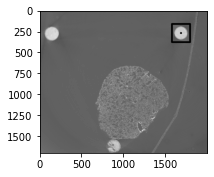

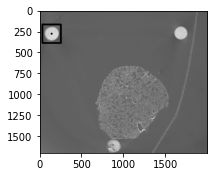

428


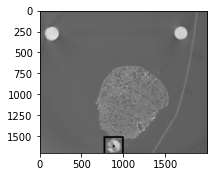

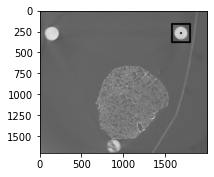

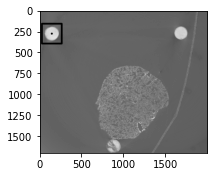

429


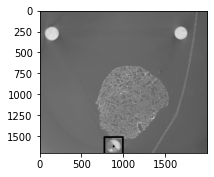

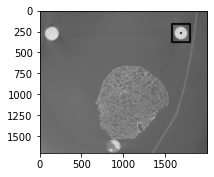

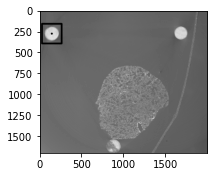

430


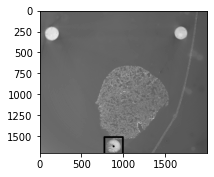

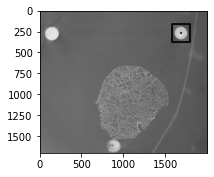

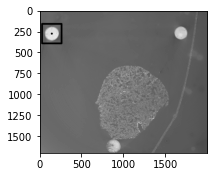

431


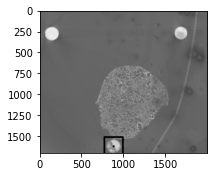

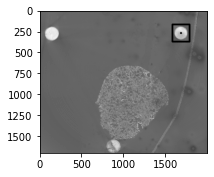

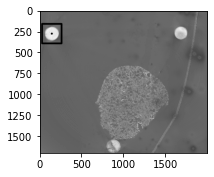

432


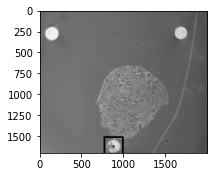

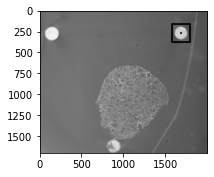

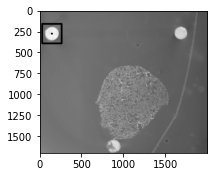

433


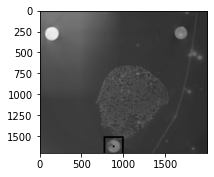

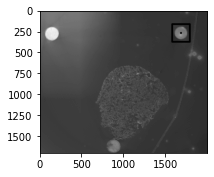

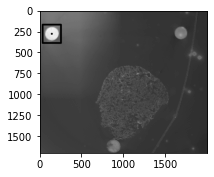

434


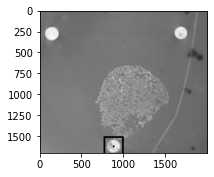

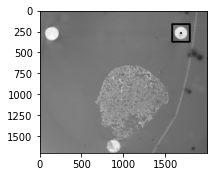

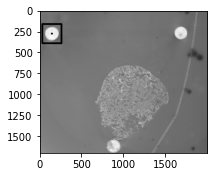

435


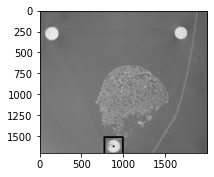

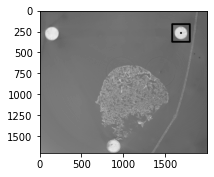

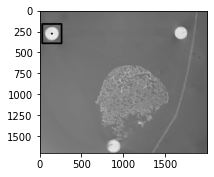

436


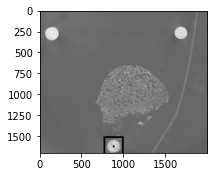

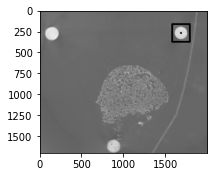

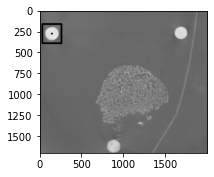

437


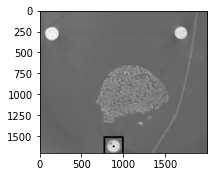

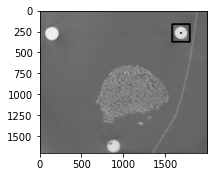

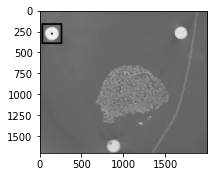

438


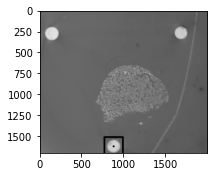

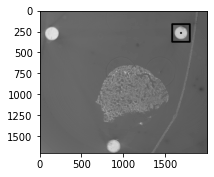

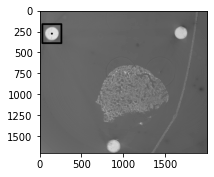

439


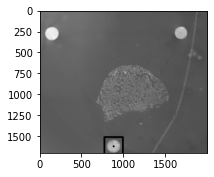

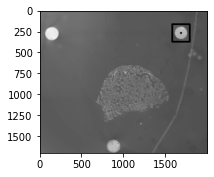

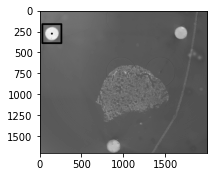

440


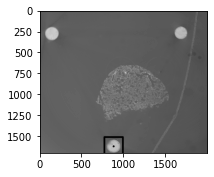

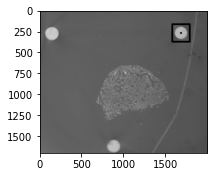

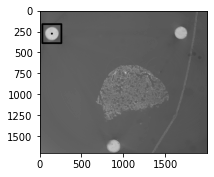

441


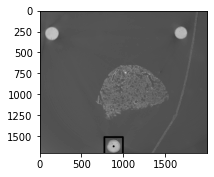

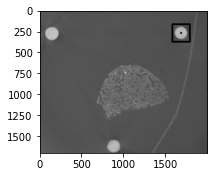

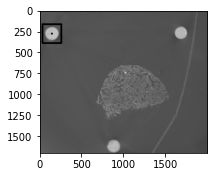

442


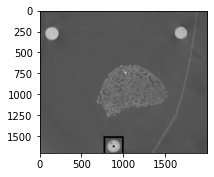

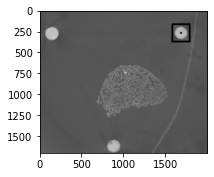

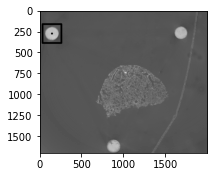

443


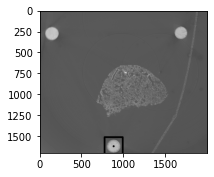

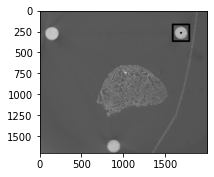

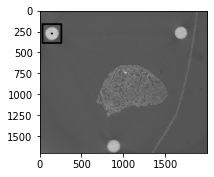

444


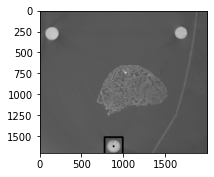

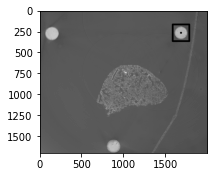

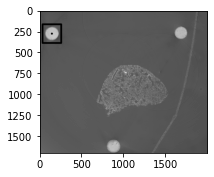

445


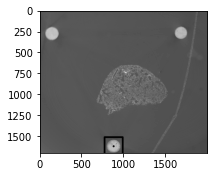

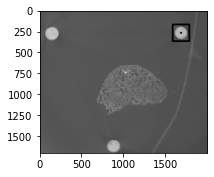

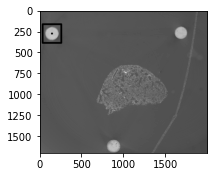

446


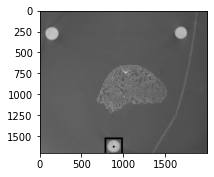

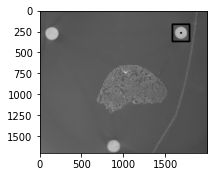

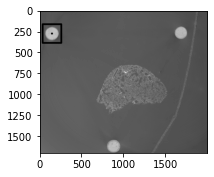

447


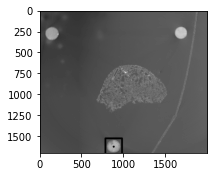

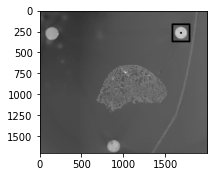

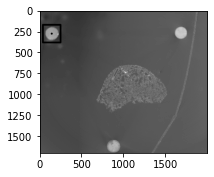

448


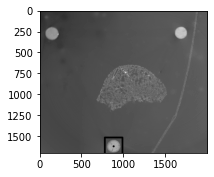

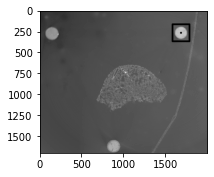

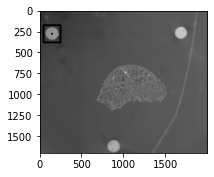

449


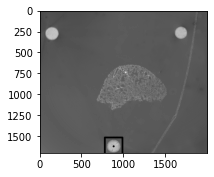

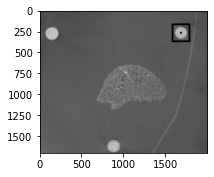

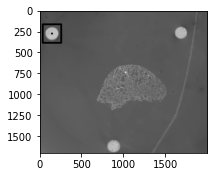

450


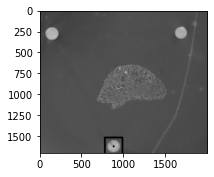

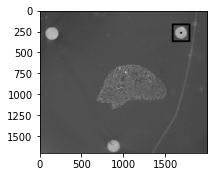

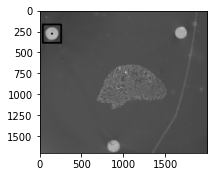

451


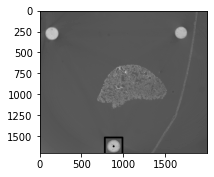

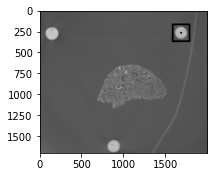

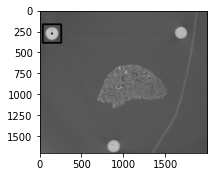

452


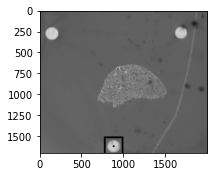

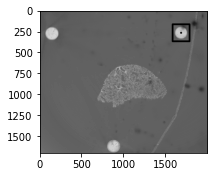

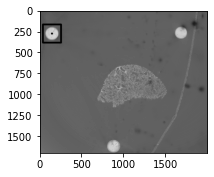

453


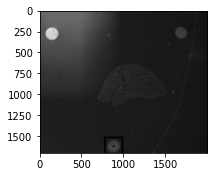

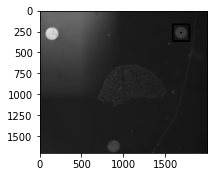

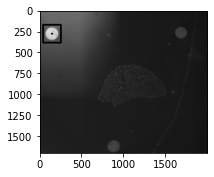

454


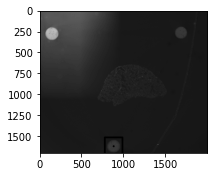

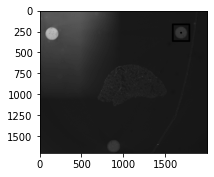

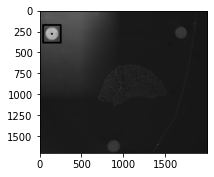

455


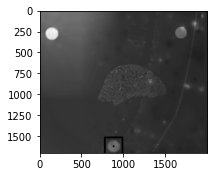

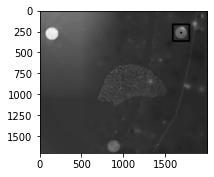

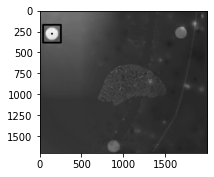

456


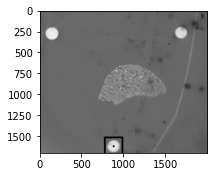

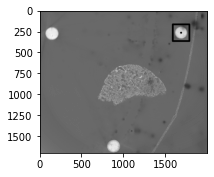

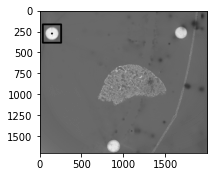

457


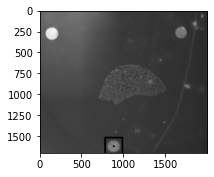

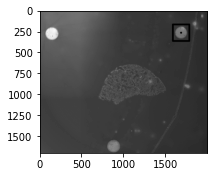

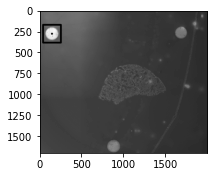

458


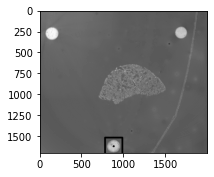

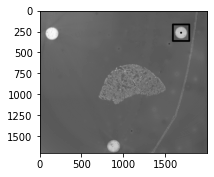

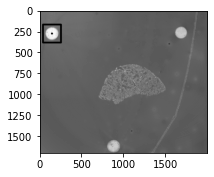

459


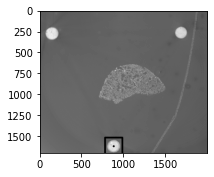

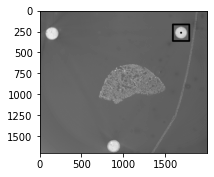

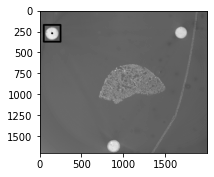

460


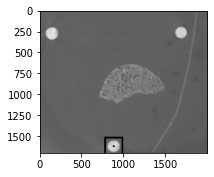

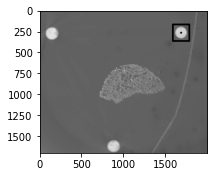

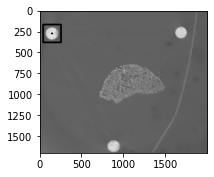

461


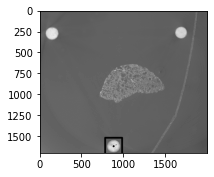

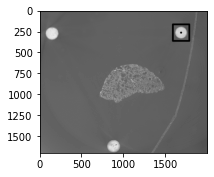

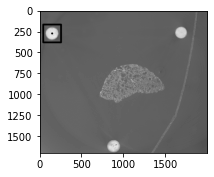

462


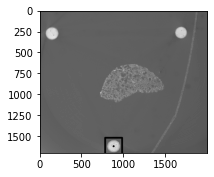

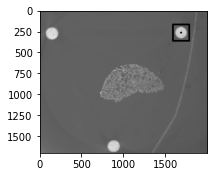

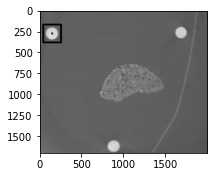

463


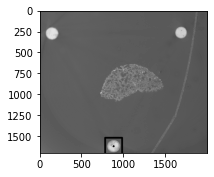

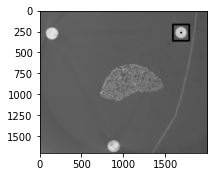

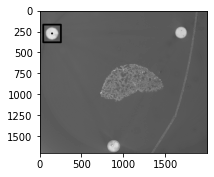

464


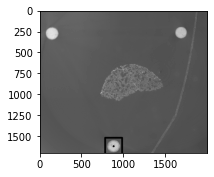

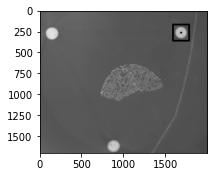

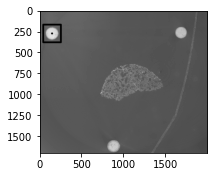

465


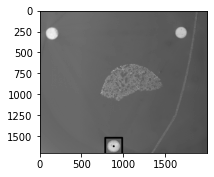

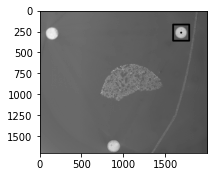

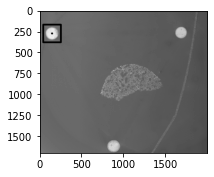

466


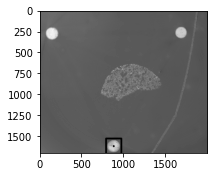

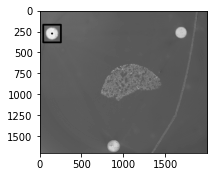

467


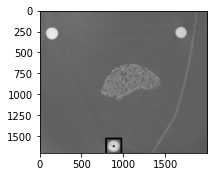

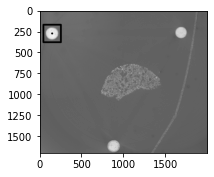

468


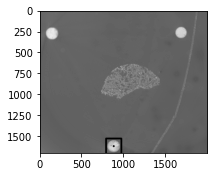

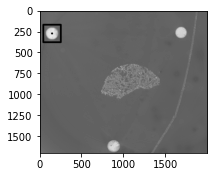

469


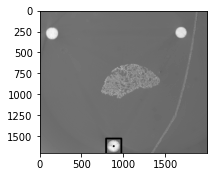

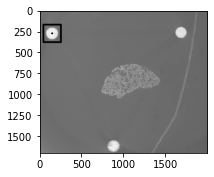

470


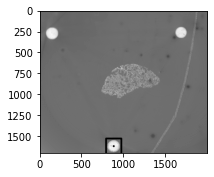

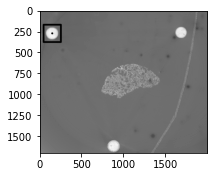

471


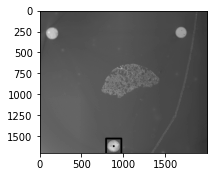

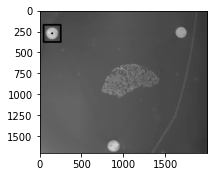

472


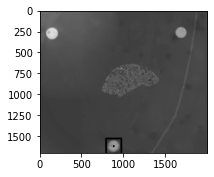

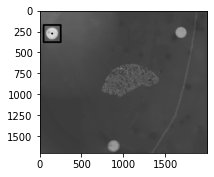

473


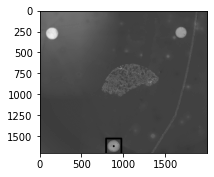

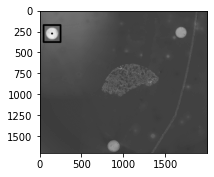

474


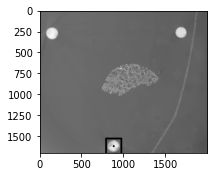

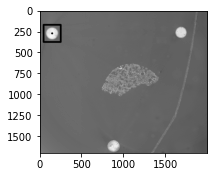

475


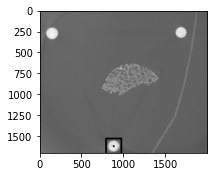

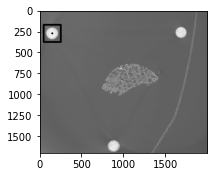

476


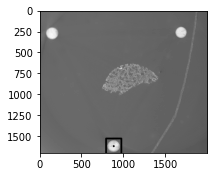

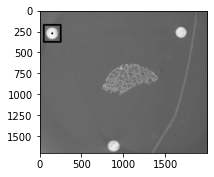

477


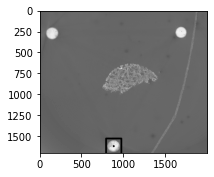

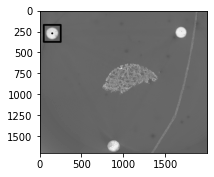

478


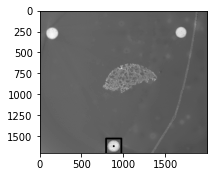

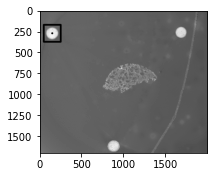

479


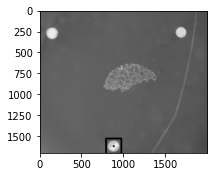

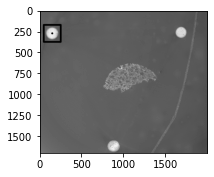

480


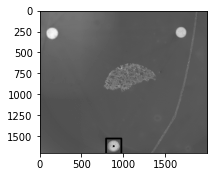

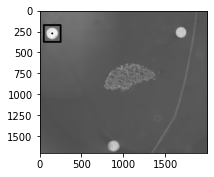

481


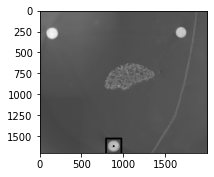

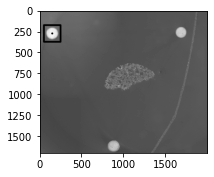

482


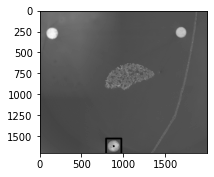

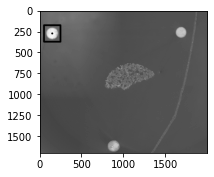

483


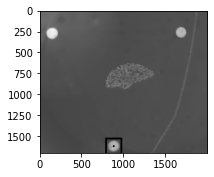

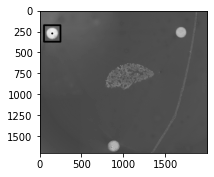

484


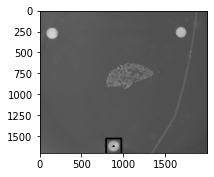

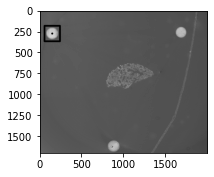

485


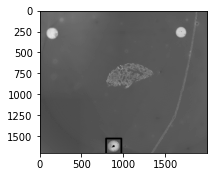

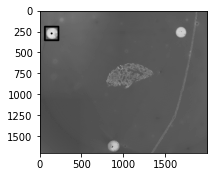

486


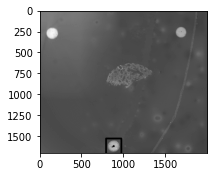

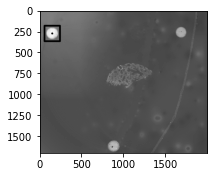

487


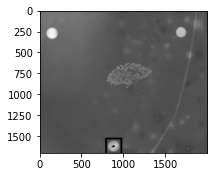

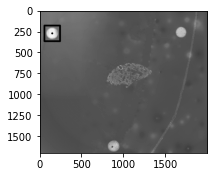

488


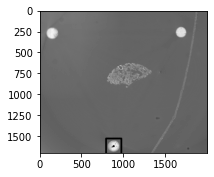

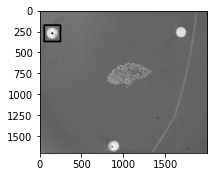

489


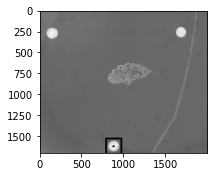

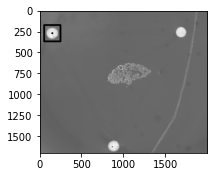

490


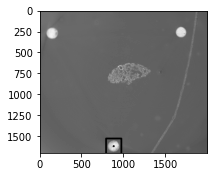

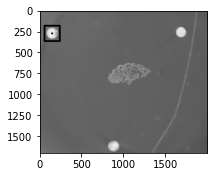

491


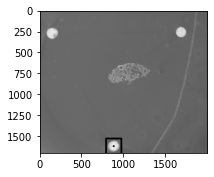

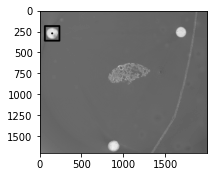

492


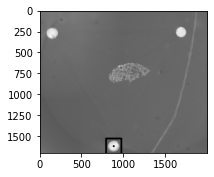

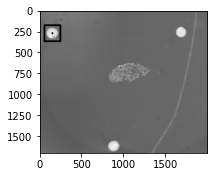

493


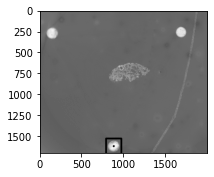

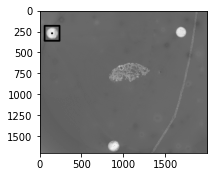

494


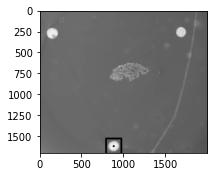

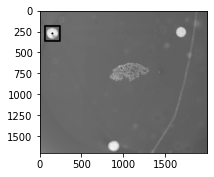

495


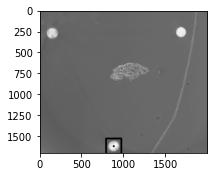

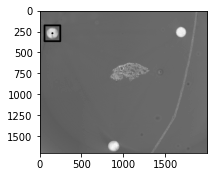

496


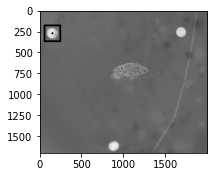

497


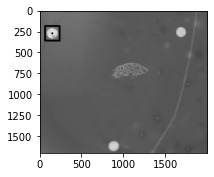

498


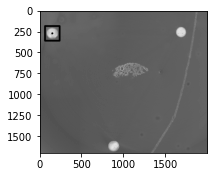

499


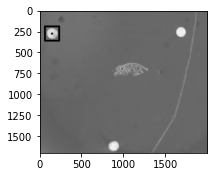

,class ID,centx,centy,width,slice_index
0,0.0,0.434891,0.946920,0.099224,5.0
1,1.0,0.831125,0.173985,0.188687,5.0
2,2.0,0.072593,0.174783,0.188542,5.0
3,0.0,0.434891,0.946920,0.099224,9.0
4,1.0,0.836857,0.173985,0.192212,9.0


In [ ]:
# Generate YOLO-style bounding boxes from cleaned ellipse data and visualize them
def plot_bbox(im, width, centx, centy, slice_index, ids):
    df_yolo_bb = pd.DataFrame(columns=["class ID", "centx", "centy", "width", "slice_index"])
    
    im_height, im_width = im.shape
    # Scale width
    width = width * 1.3
    
    # Calculate new bounding box center
    new_centx = centx
    new_centy = centy
    
    # Add data to the DataFrame
    df_yolo_bb.loc[0] = [int(ids), new_centx/im_width, new_centy/im_height, width/im_width, int(slice_index)]
    
    # Optional: Display bounding box (uncomment for visualization)
    im_disp = np.copy(im)
    color = (0, 255, 0)
    thickness = 20
    top_left = (int(centx - width // 2), int(centy - width // 2))
    bottom_right = (int(centx + width // 2), int(centy + width // 2))
    cv2.rectangle(im_disp, top_left, bottom_right, color, thickness)
    cv2.circle(im_disp, (int(new_centx), int(new_centy)), 2, color, thickness)
    plt.figure(figsize=(3,3))
    plt.imshow(im_disp, cmap="gray")
    plt.show()

    return df_yolo_bb

# Initialize empty DataFrame
df_yolo_bb_full = pd.DataFrame(columns=["class ID", "centx", "centy", "width", "slice_index"])

# Loop through DataFrame
for idx, (index, row) in enumerate(df_yolo_filled.iterrows()):
    not_nan_columns = [i for i, value in enumerate(row) if pd.notna(value)]
    
    #print(f"Processing row {idx} (original index: {index})")

    # Ensure valid index
    #if idx == 0:
        #print("Skipping first row to avoid index -1 issue.")
        #continue  

    image_index = df_yolo_filled.index[idx]  # Get previous row's index
    print(image_index)
    # Process each bounding box (cone)
    for obj_id, col_indices in enumerate([(0, 3, 4), (1, 5, 6), (2, 7, 8)]):
        if all(i in not_nan_columns for i in col_indices):
            width, centx, centy = row[col_indices[0]], row[col_indices[1]], row[col_indices[2]]
            df_yolo_bb = plot_bbox(im_list[image_index], width, centx, centy, row[9], obj_id)
            df_yolo_bb_full = pd.concat([df_yolo_bb_full, df_yolo_bb], ignore_index=True)

# Final output
df_yolo_bb_full.head()


In [71]:
df_yolo_bb_full

,class ID,centx,centy,width,slice_index
0,0.0,0.434891,0.946920,0.099224,5.0
1,1.0,0.831125,0.173985,0.188687,5.0
2,2.0,0.072593,0.174783,0.188542,5.0
3,0.0,0.434891,0.946920,0.099224,9.0
4,1.0,0.836857,0.173985,0.192212,9.0
5,2.0,0.072593,0.174783,0.188542,9.0
6,0.0,0.434891,0.942272,0.180204,13.0
7,1.0,0.836857,0.173985,0.192212,13.0
8,2.0,0.072593,0.174783,0.188542,13.0
9,0.0,0.434891,0.942272,0.180204,17.0


class ID       2.000000
centx          0.072593
centy          0.174783
width          0.188542
slice_index    5.000000
Name: 2, dtype: float64


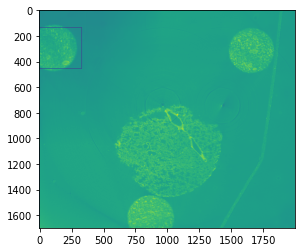

In [ ]:
# Visualize a single YOLO-style bounding box on a selected image.
# 1. Select the row from `df_yolo_bb_full` corresponding to the desired object.
# 2. Convert normalized coordinates (centx, centy, width) to absolute pixel values 
#    based on the image dimensions.
# 3. Calculate the top-left and bottom-right coordinates of the bounding box.
# 4. Draw a green rectangle on a copy of the image using OpenCV.
# 5. Display the image with the bounding box using matplotlib.


row = df_yolo_bb_full.loc[2]
print(row)
im_height, im_width = im_list[4].shape
im_disp = np.copy(im_list[4])
 # Relativ zu absolut umrechnen
    
x_center = int(row[1] * im_width)
y_center = int(row[2] * im_height)
box_width = int(row[3] * im_width)
box_height = int(row[3] * im_height)

    # Bestimme die obere linke und die untere rechte Ecke der Bounding-Box
top_left_x = x_center - box_width // 2
top_left_y = y_center - box_height // 2
bottom_right_x = x_center + box_width // 2
bottom_right_y = y_center + box_height // 2

    # Zeichne das Rechteck
color = (0, 255, 0)  # Grün
thickness = 2
cv2.rectangle(im_disp, (top_left_x, top_left_y), (bottom_right_x, bottom_right_y), color, thickness)
plt.imshow(im_disp)

In [75]:
base_name = "yolo_dataset/final_full_stack"
extension = ".txt"



num_length = 4  

unique_values = df_yolo_bb_full['slice_index'].unique()
for value in unique_values:
    number_str = f"{int(value):0{num_length}d}"
    filename = f"{base_name}{number_str}{extension}"
    print(filename)
    rows_with_value = df_yolo_bb_full[df_yolo_bb_full.iloc[:, -1]== value]
    with open(filename, 'w') as file:
    
        #print(rows_with_value)
        for index, row in rows_with_value.iterrows():
            #print(row[1])
            class_id = 0  
            x_center = row[1]
            y_center = row[2]
            width =row[3]
            height = row[3]
            annotation = (class_id, x_center, y_center, width, height)
            annotation_line = ' '.join(map(str, annotation))
            file.write(annotation_line + '\n')
            
    matching_indices = df_ellips_cleaned .index[df_ellips_cleaned.iloc[:, -1] == value]     
          
    filename =f"{base_name}{number_str}.tif"
    print(matching_indices[0])
    imageio.imwrite(filename, im_list[matching_indices[0]])


yolo_dataset/final_full_stack0005.txt
1
yolo_dataset/final_full_stack0009.txt
2
yolo_dataset/final_full_stack0013.txt
3
yolo_dataset/final_full_stack0017.txt
4
yolo_dataset/final_full_stack0021.txt
5
yolo_dataset/final_full_stack0026.txt
6
yolo_dataset/final_full_stack0030.txt
7
yolo_dataset/final_full_stack0034.txt
8
yolo_dataset/final_full_stack0038.txt
9
yolo_dataset/final_full_stack0042.txt
10
yolo_dataset/final_full_stack0047.txt
11
yolo_dataset/final_full_stack0051.txt
12
yolo_dataset/final_full_stack0055.txt
13
yolo_dataset/final_full_stack0059.txt
14
yolo_dataset/final_full_stack0068.txt
16
yolo_dataset/final_full_stack0072.txt
17
yolo_dataset/final_full_stack0076.txt
18
yolo_dataset/final_full_stack0080.txt
19
yolo_dataset/final_full_stack0084.txt
20
yolo_dataset/final_full_stack0088.txt
21
yolo_dataset/final_full_stack0093.txt
22
yolo_dataset/final_full_stack0097.txt
23
yolo_dataset/final_full_stack0101.txt
24
yolo_dataset/final_full_stack0105.txt
25
yolo_dataset/final_full_s

yolo_dataset/final_full_stack0906.txt
216
yolo_dataset/final_full_stack0910.txt
217
yolo_dataset/final_full_stack0914.txt
218
yolo_dataset/final_full_stack0918.txt
219
yolo_dataset/final_full_stack0922.txt
220
yolo_dataset/final_full_stack0927.txt
221
yolo_dataset/final_full_stack0931.txt
222
yolo_dataset/final_full_stack0935.txt
223
yolo_dataset/final_full_stack0939.txt
224
yolo_dataset/final_full_stack0943.txt
225
yolo_dataset/final_full_stack0948.txt
226
yolo_dataset/final_full_stack0952.txt
227
yolo_dataset/final_full_stack0956.txt
228
yolo_dataset/final_full_stack0960.txt
229
yolo_dataset/final_full_stack0964.txt
230
yolo_dataset/final_full_stack0968.txt
231
yolo_dataset/final_full_stack0973.txt
232
yolo_dataset/final_full_stack0977.txt
233
yolo_dataset/final_full_stack0981.txt
234
yolo_dataset/final_full_stack0985.txt
235
yolo_dataset/final_full_stack0989.txt
236
yolo_dataset/final_full_stack0994.txt
237
yolo_dataset/final_full_stack0998.txt
238
yolo_dataset/final_full_stack1002.

yolo_dataset/final_full_stack1786.txt
426
yolo_dataset/final_full_stack1790.txt
427
yolo_dataset/final_full_stack1794.txt
428
yolo_dataset/final_full_stack1798.txt
429
yolo_dataset/final_full_stack1802.txt
430
yolo_dataset/final_full_stack1807.txt
431
yolo_dataset/final_full_stack1811.txt
432
yolo_dataset/final_full_stack1815.txt
433
yolo_dataset/final_full_stack1819.txt
434
yolo_dataset/final_full_stack1823.txt
435
yolo_dataset/final_full_stack1828.txt
436
yolo_dataset/final_full_stack1832.txt
437
yolo_dataset/final_full_stack1836.txt
438
yolo_dataset/final_full_stack1840.txt
439
yolo_dataset/final_full_stack1844.txt
440
yolo_dataset/final_full_stack1848.txt
441
yolo_dataset/final_full_stack1853.txt
442
yolo_dataset/final_full_stack1857.txt
443
yolo_dataset/final_full_stack1861.txt
444
yolo_dataset/final_full_stack1865.txt
445
yolo_dataset/final_full_stack1869.txt
446
yolo_dataset/final_full_stack1874.txt
447
yolo_dataset/final_full_stack1878.txt
448
yolo_dataset/final_full_stack1882.

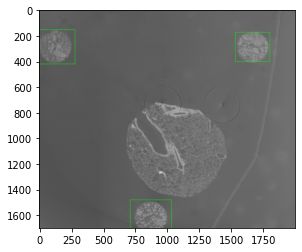

In [ ]:
def draw_yolo_bboxes(image_path, annotation_path):
    """
    Loads an image and its corresponding YOLO annotation file, converts normalized
    bounding box coordinates to absolute pixel values, draws the bounding boxes on
    the image, and displays the resulting image using matplotlib.
    """
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error loading image {image_path}")
        return

    # Determine image dimensions
    image_height, image_width, _ = image.shape

    # Read YOLO annotation file
    with open(annotation_path, 'r') as file:
        lines = file.readlines()

    # Process each line
    for line in lines:
        line = line.strip()
        class_id, x_center_rel, y_center_rel, width_rel, height_rel = map(float, line.split())

        # Convert relative coordinates to absolute pixel values
        x_center = int(x_center_rel * image_width)
        y_center = int(y_center_rel * image_height)
        box_width = int(width_rel * image_width)
        box_height = int(height_rel * image_height)

        # Determine top-left and bottom-right corners of the bounding box
        top_left_x = int(x_center - box_width / 2)
        top_left_y = int(y_center - box_height / 2)
        bottom_right_x = int(x_center + box_width / 2)
        bottom_right_y = int(y_center + box_height / 2)

        # Draw the rectangle on the image
        color = (0, 255, 0)  # Green
        thickness = 2
        cv2.rectangle(image, (top_left_x, top_left_y), (bottom_right_x, bottom_right_y), color, thickness)
    
    # Display the resulting image
    plt.imshow(image)
    
# Example paths for image and annotation
image_path = 'yolo_dataset/final_full_stack1065.tif'
annotation_path = 'yolo_dataset/final_full_stack1065.txt'

draw_yolo_bboxes(image_path, annotation_path)


In [ ]:
def split_dataset(input_folder, train_folder, val_folder, split_ratio=0.8):
    """
    Splits a dataset of images and corresponding YOLO annotation files into
    training and validation sets, moving the files into the specified folders.
    """
    # Create target folders if they do not exist
    os.makedirs(train_folder, exist_ok=True)
    os.makedirs(val_folder, exist_ok=True)

    # List all image files in the input folder
    all_files = [f for f in os.listdir(input_folder) if f.endswith('.tif')]

    # Shuffle the file list for random distribution
    random.shuffle(all_files)
    
    # Determine the number of training examples
    split_index = int(len(all_files) * split_ratio)

    # Split the files into training and validation sets
    train_files = all_files[:split_index]
    val_files = all_files[split_index:]

    # Function to move files to the destination folder
    def move_files(file_list, destination_folder):
        for file_name in file_list:
            base_name = os.path.splitext(file_name)[0]
            img_path = os.path.join(input_folder, file_name)
            txt_path = os.path.join(input_folder, base_name + '.txt')

            if os.path.exists(img_path) and os.path.exists(txt_path):
                shutil.move(img_path, os.path.join(destination_folder, file_name))
                shutil.move(txt_path, os.path.join(destination_folder, base_name + '.txt'))

    # Move files to the corresponding folders
    move_files(train_files, train_folder)
    move_files(val_files, val_folder)
